In [1]:
%pylab inline

from __future__ import (division, print_function)

import os
import sys
import copy
import fnmatch
import warnings
import collections

import numpy as np
import scipy
try:
    from scipy.stats import scoreatpercentile
except:
    scoreatpercentile = False
from scipy.interpolate import interp1d
import cPickle as pickle

# Astropy
from astropy.io import fits
from astropy    import units as u
from astropy.stats import sigma_clip
from astropy.table import Table, Column
from astropy.utils.console import ProgressBar
from astropy.convolution import convolve, Box1DKernel

# AstroML
from astroML.plotting import hist
from astroML.density_estimation import KNeighborsDensity
try:
    from sklearn.neighbors import KernelDensity
    use_sklearn_KDE = True
except:
    import warnings
    warnings.warn("KDE will be removed in astroML version 0.3.  Please "
                  "upgrade to scikit-learn 0.14+ and use "
                  "sklearn.neighbors.KernelDensity.", DeprecationWarning)
    from astroML.density_estimation import KDE
    use_sklearn_KDE = False
from sklearn.neighbors import KDTree
from sklearn.neighbors import BallTree

# Matplotlib related
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
from matplotlib.ticker import NullFormatter
from matplotlib.ticker import MaxNLocator
# Matplotlib default settings
rcdef = plt.rcParams.copy()
pylab.rcParams['figure.figsize'] = 12, 10
pylab.rcParams['xtick.major.size'] = 8.0
pylab.rcParams['xtick.major.width'] = 2.5
pylab.rcParams['xtick.minor.size'] = 4.0
pylab.rcParams['xtick.minor.width'] = 2.5
pylab.rcParams['ytick.major.size'] = 8.0
pylab.rcParams['ytick.major.width'] = 2.5
pylab.rcParams['ytick.minor.size'] = 4.0
pylab.rcParams['ytick.minor.width'] = 2.5

# Personal
import hscUtils as hUtil
import galSBP
import coaddCutoutGalfitSimple as gSimple 

import matplotlib.patches as mpatches
from matplotlib.patches import Ellipse
from matplotlib.collections import PatchCollection

import cosmology
c=cosmology.Cosmo(H0=70.0, omega_m=0.3, omega_l=0.7, flat=1)

# Color map 
from palettable.colorbrewer.sequential import Oranges_4
ORG4 = Oranges_4.mpl_colormap

Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python2.7/site-packages/matplotlib/__init__.py:1350: UserWarning:  This call to matplotlib.use() has no effect
because the backend has already been chosen;
matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [2]:
# Absolute magnitude of sun in HSC filters

# Actuall borrowed from DES filters
# Values from magsun.data in FSPS
amag_sun_des_g = 5.08
amag_sun_des_r = 4.62
amag_sun_des_i = 4.52
amag_sun_des_z = 4.52
amag_sun_des_y = 4.51

# Based on http://www.baryons.org/ezgal/filters.php
amag_sun_ukiss_y = 4.515

# Extinction correction factor for HSC 
## A\_lambda = Coeff * E(B-V) 

a_hsc_g = 3.233
a_hsc_r = 2.291 
a_hsc_i = 1.635
a_hsc_z = 1.261
a_hsc_y = 1.076

# 
SIGMA1 = 0.3173
SIGMA2 = 0.0455
SIGMA3 = 0.0027

RSMA_COMMON = np.arange(0.4, 4.2, 0.02)

### Fancy one 
# definitions for the axes
left, width    = 0.12, 0.69
right          = left + width 
bottom, height = 0.12, 0.86
bottom_h = left_h = left + width + 0.02

recScat = [left,   bottom, width, height]
recHist = [right,  bottom,  0.18, height]

SBP1 = [0.125, 0.066, 0.869, 0.320]
SBP2 = [0.125, 0.386, 0.869, 0.585]

EC1 = [0.135, 0.066, 0.862, 0.30]
EC2 = [0.135, 0.366, 0.862, 0.30]
EC3 = [0.135, 0.666, 0.862, 0.30]

# Color 
BLUE0 = "#92c5de"
BLUE1 = "#0571b0"

RED0 = "#f4a582"
RED1 = "#ca0020"

PURPLE0 = '#af8dc3'
PURPLE1 = '#762a83'

BROWN0 = '#bf812d'
BROWN1 = '#543005'

GREEN0 = '#7fbf7b'
GREEN1 = '#1b7837'

In [4]:
# Stacked color profiles
## d'Souza 2015 g-r color profile 
dsouza15_gr = Table.read('ancil/dsouza15_gr_c26_11.0_11.4.txt', format='ascii')

## La Babera 2014 g-r; Using Re as unit 
lababera14_gi = Table.read('ancil/lababera14_gi_avg.txt', format='ascii')
lababera14_gr = Table.read('ancil/lababera14_gr_avg.txt', format='ascii')
lababera14_gz = Table.read('ancil/lababera14_gz_avg.txt', format='ascii')

## Tal & van Dokkum 2011; g-z; 
tal11_gz = Table.read('ancil/tal11_stack_gz.txt', format='ascii')
## Tal & van Dokkum 2011; r-i
tal11_ri = Table.read('ancil/tal11_stack_ri.txt', format='ascii')

# Stacked ellipticity profiles
## d'Souza 2015 
dsouza15_ell = Table.read('ancil/dsouza15_massive_ell.txt', format='ascii')

## Tal & van Dokkum 2011l ell 
tal11_ell_1 = Table.read('ancil/tal11_stack_ell_nopsf.txt', format='ascii')
tal11_ell_2 = Table.read('ancil/tal11_stack_ell_psf.txt', format='ascii')

In [27]:
# Code for Get Bootstrap mean or median 
def _confidence_interval_1d(A, alpha=.05, metric=np.mean, numResamples=10000, interpolate=True):
    """Calculates bootstrap confidence interval along one dimensional array"""
    
    if not isinstance(alpha, collections.Iterable):
        alpha = np.array([alpha])

    N = len(A)
    resampleInds = np.random.randint(0, N, (numResamples,N))
    metricOfResampled = metric(A[resampleInds], axis=-1)

    confidenceInterval = np.zeros(2*len(alpha),dtype='float')
    
    if interpolate:
        for thisAlphaInd, thisAlpha in enumerate(alpha):
            confidenceInterval[2*thisAlphaInd] = scoreatpercentile(metricOfResampled, 
                                                                   thisAlpha*100/2.0)
            confidenceInterval[2*thisAlphaInd+1] = scoreatpercentile(metricOfResampled, 
                                                                     100-thisAlpha*100/2.0)
    else:
        sortedMetricOfResampled = np.sort(metricOfResampled)
        for thisAlphaInd, thisAlpha in enumerate(alpha):
            confidenceInterval[2*thisAlphaInd] = sortedMetricOfResampled[int(round(thisAlpha*numResamples/2.0))]
            confidenceInterval[2*thisAlphaInd+1] = sortedMetricOfResampled[int(round(numResamples - 
                                                                                     thisAlpha*numResamples/2.0))]
    return confidenceInterval
    
def _ma_confidence_interval_1d(A, alpha=.05, metric=np.mean, numResamples=10000, interpolate=True):
    A = np.ma.masked_invalid(A, copy=True)
    A = A.compressed()
    confidenceInterval = _confidence_interval_1d(A, alpha, metric, numResamples, interpolate)
    return confidenceInterval

def confidence_interval(A, axis=None, alpha=.05, metric=np.mean, numResamples=10000, interpolate=True):
    """Return the bootstrap confidence interval of an array or along an axis ignoring NaNs and masked elements.
    
    Parameters
    ----------
    A : array_like
        Array containing numbers whose confidence interval is desired. 
    axis : int, optional
        Axis along which the confidence interval is computed.
        The default is to compute the confidence interval of the flattened array.
    alpha: float or array, optional
        confidence level of confidence interval. 100.0*(1-alpha) percent confidence 
        interval will be returned.
        If length-n array, n confidence intervals will be computed
        The default is .05
    metric : numpy function, optional
        metric to calculate confidence interval for.
        The default is numpy.mean
    numResamples : int, optional
        number of bootstrap samples. The default is 10000.
    interpolate: bool, optional
        uses scipy.stats.scoreatpercentile to interpolate between bootstrap samples 
        if alpha*numResamples/2.0 is not integer.
        The default is True
        
    Returns
    -------
    confidenceInterval : ndarray
    An array with the same shape as `A`, with the specified axis replaced by one twice the length of the alpha
    If `A` is a 0-d array, or if axis is None, a length-2 ndarray is returned.
    """
    if interpolate is True and scoreatpercentile is False:
        print("need scipy to interpolate between values")
        interpolate = False
    A = A.copy()
    if axis is None:
        A = A.ravel()
        outA = _ma_confidence_interval_1d(A, alpha, metric, numResamples, interpolate)
    else:
        outA = np.apply_along_axis(_ma_confidence_interval_1d, axis, A, alpha, 
                                   metric, numResamples, interpolate)
        
    return outA

def normProf(sma, sbp, minSma, maxSma, divide=False): 
    """
    Naive method to normalize the profile. 
    
    Parameters: 
        sbp    : Array for surface brightness profile 
        sma    : Radius range 
        minSma : Minimum SMA
        maxSma   Maximum SMA
    """
    offset = np.nanmedian(sbp[(sma >= minSma) & 
                              (sma <= maxSma)])
    if divide: 
        return (sbp / offset)
    else:
        return (sbp-offset)
    
    
def pixKpc(redshift, pix=0.168, show=True, npix=1.0):
    """
    Get the corresponding Kpc size of a pixel.  
    
    Parameters: 
    """
    pixKpc = pix * npix * hUtil.cosmoScale(redshift)

    if show:
        print("# %d pixel(s) = %6.3f Kpc" % (npix, pixKpc))
        
    return pixKpc


def logAdd(para1, para2):
    """ Useful for adding magnitudes. """
    return np.log10((10.0 ** np.asarray(para1)) + 
                    (10.0 ** np.asarray(para2)))


def errAdd(err1, err2):
    """Add error quadral..."""
    return np.sqrt((err1 ** 2.0) + 
                   (err2 ** 2.0))


def toColorArr(data, bottom=None, top=None):
    """ 
    Convert a data array to "color array" (between 0 and 1). 
    
    Parameters:
        bottom, top  : 
    """
    if top is not None:
        data[data >= top] = top
    if bottom is not None:
        data[data <= bottom] = bottom
        
    return ((data - np.nanmin(data)) / 
            (np.nanmax(data) - np.nanmin(data))) * 255.0


def getLuminosity(mag, redshift, extinction=None, 
                  amag_sun=None):
    """Get the absolute magnitude or luminosity."""
    distmod = hUtil.cosmoDistMod(redshift)
    absMag = (mag - distmod)
    if extinction is not None: 
        absMag -= extinction 
    if amag_sun is not None: 
        absMag = ((amag_sun - absMag) / 2.5)
    
    return absMag

def getStackProfiles(sample, loc, name='GAMA', 
                     idCol='ID_USE', tabCol='sum_tab', save=True):
    """Get the stacks of the profiles."""
    print("## Sample %s : Will deal with %d galaxies" % (name, len(sample)))
    profiles = []
    with ProgressBar(len(sample), ipython_widget=True) as bar:
        for g in sample:
            try:
                gFile = os.path.join(loc, g['sum_tab'].replace('./', '')).strip()
                gProf = Table.read(gFile, format='fits')
                """ Add extra information """
                try: 
                    gProf.meta['KCORRECT_I'] = g['KCORRECT_I']
                    gProf.meta['KCORRECT_G'] = g['KCORRECT_G']
                    gProf.meta['KCORRECT_R'] = g['KCORRECT_R']
                    gProf.meta['KCORRECT_Z'] = g['KCORRECT_Z']
                    gProf.meta['KCORRECT_Y'] = g['KCORRECT_Y']
                    gProf.meta['LOGM2LI'] = g['LOGM2L_I_OBS']
                    gProf.meta['LUM_100'] = g['lum_100']
                    gProf.meta['LUM_120'] = g['lum_120']
                except Exception:
                    print("## WARNING: Some metadata may not be available !")
                    continue
            except Exception:
                print("## Missing: %s" % gFile)
                continue 
            profiles.append(gProf)
            bar.update()
    
    if save: 
        outPkl = os.path.join(loc, (name + '_profs.pkl'))
        hUtil.saveToPickle(profiles, outPkl)
        print("## Save %s to %s" % (name, outPkl))
        
    return profiles


def organizeSbp(profiles, col1='muI1', col2='KCORRECT_I', 
                kind='sbp', norm=False, r1=9.9, r2=10.1, divide=False,
                col3=None, col4=None, justStack=False,
                sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                index=None, extCat=None):
    """ Get the stack of individual profiels, and their med/avg. """
    if kind.strip() == 'sbp':
        if col2 is not None: 
            if norm:
                stack = np.vstack(normProf(p['rKpc'], 
                                           np.asarray(p[col1] + (p.meta[col2] / 2.5)), 
                                           r1, r2, divide=divide) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1] + (p.meta[col2] / 2.5)) 
                                  for p in profiles)
        else: 
            print("## NO KCORRECTION APPLIED !!")            
            if norm:
                stack = np.vstack(normProf(p['rKpc'], p[col1], 
                                           r1, r2, divide=divide) 
                                  for p in profiles)
            else:
                stack = np.vstack(np.asarray(p[col1]) for p in profiles)
    elif kind.strip() == 'mass':
        if norm:
            stack = np.vstack(normProf(p['rKpc'], 
                                       np.asarray(p[col1] + p.meta[col2]), 
                                       r1, r2, divide=divide) for p in profiles)
        else: 
            stack = np.vstack(np.asarray(p[col1] + p.meta[col2]) for p in profiles)
    elif kind.strip() == 'color':
        cSun = (sun1 - sun2)
        if col3 is None or col4 is None:
            print("## NO KCORRECTION APPLIED !!")
            if norm:
                stack = np.vstack(normProf(p['rKpc'], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2])), 
                                           r1, r2, divide=divide) for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 *(p[col1] - p[col2])) for p in profiles)
        else:
            if norm:
                stack = np.vstack(normProf(p['rKpc'], 
                                           np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                                      (p.meta[col3] - p.meta[col4])), 
                                           r1, r2, divide=divide) for p in profiles)
            else: 
                stack = np.vstack(np.asarray(cSun - 2.5 * (p[col1] - p[col2]) -
                                             (p.meta[col3] - p.meta[col4])) 
                                  for p in profiles)
    elif kind.strip() == 'lum':
        if col2 is None:
            stack = np.vstack(np.asarray(p[col1]) for p in profiles)
        else:
            stack = np.vstack(np.asarray(p[col1] - p.meta[col2]) for p in profiles)
    else: 
        raise Exception("## WRONG KIND !!")
        
    if index is not None: 
        stack = np.vstack(p[index] for p in stack)
        
    if not justStack:
        """ Get the median and 1-sigma confidence range """
        medProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                      metric=np.nanmedian, numResamples=1000, 
                                      interpolate=True) 
        avgProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                      metric=np.nanmean, numResamples=1000, 
                                      interpolate=True) 
        stdProf = confidence_interval(stack, axis=0, alpha=np.asarray([SIGMA1, 1.0]), 
                                      metric=np.nanstd, numResamples=1000, 
                                      interpolate=True) 
        return stack, medProf, avgProf, stdProf
    else: 
        return stack
    

def loadPkl(filename):
    try:
        import cPickle as pickle
    except:
        warnings.warn("## cPickle is not available!!")
        import pickle
    
    if os.path.isfile(filename):
        pklFile = open(filename, 'rb')
        data = pickle.load(pklFile)    
        pklFile.close()
    
        return data
    else: 
        warnings.warn("## Can not find %s, return None" % filename)
        return None

In [98]:
newDir = '/Users/songhuang/work/hscs/gama_massive/sbp/'

# The SED models 
sedMod = 'fsps1'
# Catalog files for BCG and NonBCG
bcgFile = 'redbcg_old_s15b_sed_' + sedMod + '.fits'
gamaFile = 'nonbcg_old_s15b_sed_' + sedMod + '.fits'
memFile = 'redmem_1d_160211.fits'

try:
    bcgTab
except NameError:
    pass
else:
    del bcgTab
    
try:
    memTab
except NameError:
    pass
else:
    del memTab    
    
try:
    gamaTab
except NameError:
    pass
else:
    del gamaTab
    
#
bcgDir = os.path.join(newDir, 'redbcg')
memDir = os.path.join(newDir, 'redmem')
gamaDir = os.path.join(newDir, 'gama')

# Two summary catalogs
bcgCat = os.path.join(newDir, bcgFile)
memCat = os.path.join(newDir, memFile)
gamaCat = os.path.join(newDir, gamaFile)

if not os.path.isfile(bcgCat):
    raise Exception("## Can not find catalog for BCGs : %s" % bcgCat)
else: 
    bcgTab = Table.read(bcgCat, format='fits')

if not os.path.isfile(memCat):
    raise Exception("## Can not find catalog for cluster members : %s" % memCat)
else: 
    memTab = Table.read(memCat, format='fits')
    
if not os.path.isfile(gamaCat):
    raise Exception("## Can not find catalog for GAMA galaxies : %s" % gamaCat)
else: 
    gamaTab = Table.read(gamaCat, format='fits')
    
print("## Deal with %i galaxies in redBCH sample" % len(bcgTab))
print("## Deal with %i galaxies in redMEM sample" % len(memTab))
print("## Deal with %i galaxies in GAMA sample" % len(gamaTab))

## Deal with 218 galaxies in redBCH sample
## Deal with 1542 galaxies in redMEM sample
## Deal with 8875 galaxies in GAMA sample


In [99]:
# For bcg sample
bcgTab.add_column(Column(bcgTab['lum_5'] + bcgTab['LOGM2L_I_OBS'], 
                            name='m5_c'))
bcgTab.add_column(Column(bcgTab['lum_10'] + bcgTab['LOGM2L_I_OBS'], 
                            name='m10_c'))
bcgTab.add_column(Column(bcgTab['lum_15'] + bcgTab['LOGM2L_I_OBS'], 
                            name='m15_c'))
bcgTab.add_column(Column(bcgTab['lum_30'] + bcgTab['LOGM2L_I_OBS'], 
                            name='m30_c'))
bcgTab.add_column(Column(bcgTab['lum_100'] + bcgTab['LOGM2L_I_OBS'], 
                            name='m100_c'))
bcgTab.add_column(Column(bcgTab['lum_120'] + bcgTab['LOGM2L_I_OBS'], 
                            name='m120_c'))

# For gama sample
gamaTab.add_column(Column(gamaTab['lum_5'] + gamaTab['LOGM2L_I_OBS'], 
                            name='m5_c'))
gamaTab.add_column(Column(gamaTab['lum_10'] + gamaTab['LOGM2L_I_OBS'], 
                            name='m10_c'))
gamaTab.add_column(Column(gamaTab['lum_15'] + gamaTab['LOGM2L_I_OBS'], 
                            name='m15_c'))
gamaTab.add_column(Column(gamaTab['lum_30'] + gamaTab['LOGM2L_I_OBS'], 
                            name='m30_c'))
gamaTab.add_column(Column(gamaTab['lum_100'] + gamaTab['LOGM2L_I_OBS'], 
                            name='m100_c'))
gamaTab.add_column(Column(gamaTab['lum_120'] + gamaTab['LOGM2L_I_OBS'], 
                            name='m120_c'))

# Get a "Clean" GAMA sample 

In [100]:
bcgClean = bcgTab[(bcgTab['m100_c'] >= 10.0) & 
                  (bcgTab['c82_120'] <= 14.0) &
                  (bcgTab['r90_max'] <= 160.0)]
print(len(bcgClean))

gamaClean = gamaTab[(gamaTab['c82_120'] >= 5.0) & 
                    (gamaTab['c82_120'] <= 14.0) &
                    (gamaTab['gz_kC'] >= 1.55) &
                    (gamaTab['m100_c'] >= 10.0) &
                    (gamaTab['ur_rest_sed'] > 2.0) &
                    (gamaTab['r90_max'] <= 160.0) &
                    ((gamaTab['r50_120'] - gamaTab['r20_120']) >= 
                     (32.0 * (gamaTab['m30_c'] - gamaTab['m10_c']) - 1.4) )]

print(len(gamaClean))

memClean = memTab[(memTab['c82_120'] >= 5.0) &
                  (memTab['c82_120'] <= 14.0) &
                  (memTab['gz_kC'] >= 1.5) &
                  (memTab['m100_c'] >= 10.0) &
                  (memTab['ur_rest_sed'] > 2.0) &
                  (memTab['r90_max'] <= 160.0) &
                  ((memTab['r50_120'] - memTab['r20_120']) >= 
                   (32.0 * (memTab['m30_c'] - memTab['m10_c']) - 1.4) )]
print(len(memClean))

174
3638


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in greater
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:22: RuntimeWarning: invalid value encountered in greater


254


In [101]:
bcgClean['logms_gama'] += np.log10(bcgClean['fluxscale_gama'])
memClean['logms_gama'] += np.log10(memClean['fluxscale_gama'])
gamaClean['logms_gama'] += np.log10(gamaClean['fluxscale_gama'])

print(len(bcgClean[bcgClean['logms_gama'] >= 9.0]))

93


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:5: RuntimeWarning: invalid value encountered in greater_equal


In [102]:
bcgMErr = np.sqrt((0.05 ** 2.0) + (bcgClean['MSTAR_ERR'] ** 2.0))
bcgMErr = np.asarray(bcgMErr)
bcgMErr[bcgMErr <= 0.06] = 0.065

In [55]:
gamaSave = gamaClean[gamaClean['m100_c'] >= 11.4]
print(len(gamaSave))

gamaSave.write('gamaMassive_check.fits', format='fits', overwrite=True)

1518


In [103]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_gama_1'
mlim0, mlim1 = 11.50, 11.90
zlim0, zlim1 = 0.23, 0.45
lamLimit = 25
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['logms_gama'] >= mlim0) & 
                  (bcgClean['logms_gama'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['logms_gama'] >= (mlim0 + 0.005)) & 
                    (gamaClean['logms_gama'] <= (mlim1 + 0.06)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
#bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['logms_gama'] <= 11.70]['logms_gama']), 
#                   np.asarray(bcgUse[bcgUse['logms_gama'] <= 11.70]['z_use'])), axis=-1)
#bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['logms_gama'] > 11.70]['logms_gama']), 
#                   np.asarray(bcgUse[bcgUse['logms_gama'] > 11.70]['z_use'])), axis=-1)

bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['z_use'] <= 0.35]['logms_gama']), 
                   np.asarray(bcgUse[bcgUse['z_use'] <= 0.35]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['z_use'] > 0.35]['logms_gama']), 
                   np.asarray(bcgUse[bcgUse['z_use'] > 0.35]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['logms_gama']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=7) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=9) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:15: RuntimeWarning: invalid value encountered in greater_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:15: RuntimeWarning: invalid value encountered in less_equal


# BCG Sample Size:  24
# GAMA Sample Size:  362
# Matched < 11.65 112
# Matched > 11.65 72
# All and Unique Matched Sample 184 151


In [104]:
print(gamaUnique.colnames)

['INDEX', 'ID_USE', 'ra_hsc', 'dec_hsc', 'id', 'a_g', 'a_r', 'a_i', 'a_z', 'a_y', 'gmag_cmodel_old', 'gmag_cmodel_err_old', 'rmag_cmodel_old', 'rmag_cmodel_err_old', 'imag_cmodel_old', 'imag_cmodel_err_old', 'zmag_cmodel_old', 'zmag_cmodel_err_old', 'ymag_cmodel_old', 'ymag_cmodel_err_old', 'if_cmodel_fracdev_old', 'z_use', 'ra_gama', 'dec_gama', 'gama_id', 'logms_gama', 'logms_err_gama', 'logm2l_i_gama', 'logm2l_i_err_gama', 'fluxscale_gama', 'GAL_INDEX_R', 'GAL_INDEX_I', 'ra_sdss', 'dec_sdss', 'objid_dr12', 'specobjid_dr12', 'veldisp', 'veldisp_err', 'logms_pca', 'logms_err_pca', 'logms_gran', 'logms_err_gran', 'age_gama', 'ageerr_gama', 'CHI2_a_old', 'MSTAR_a_old', 'AGE_a_old', 'TAU_a_old', 'ZMETAL_a_old', 'AV_a_old', 'MSTAR_ERR_a_old', 'AGE_ERR_a_old', 'TAU_ERR_a_old', 'ZMETAL_ERR_a_old', 'AV_ERR_a_old', 'MSTAR_b_old', 'AGE_b_old', 'TAU_b_old', 'ZMETAL_b_old', 'AV_b_old', 'MSTAR_ERR_b_old', 'AGE_ERR_b_old', 'TAU_ERR_b_old', 'ZMETAL_ERR_b_old', 'AV_ERR_b_old', 'MSTAR_c_old', 'AGE_c_

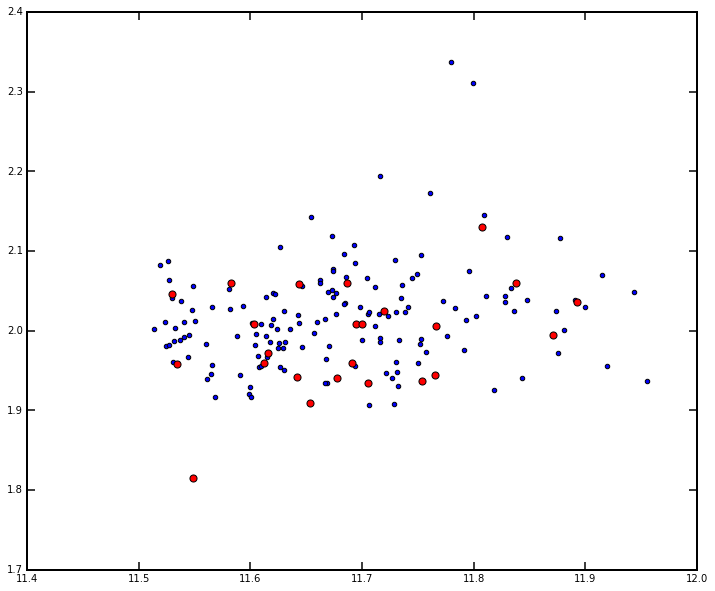

In [58]:
plt.scatter(gamaUnique['logms_gama'], gamaUnique['logm2l_i_gama'])
plt.scatter(bcgUse['logms_gama'], bcgUse['logm2l_i_gama'], c='r', s=50)

plt.show()

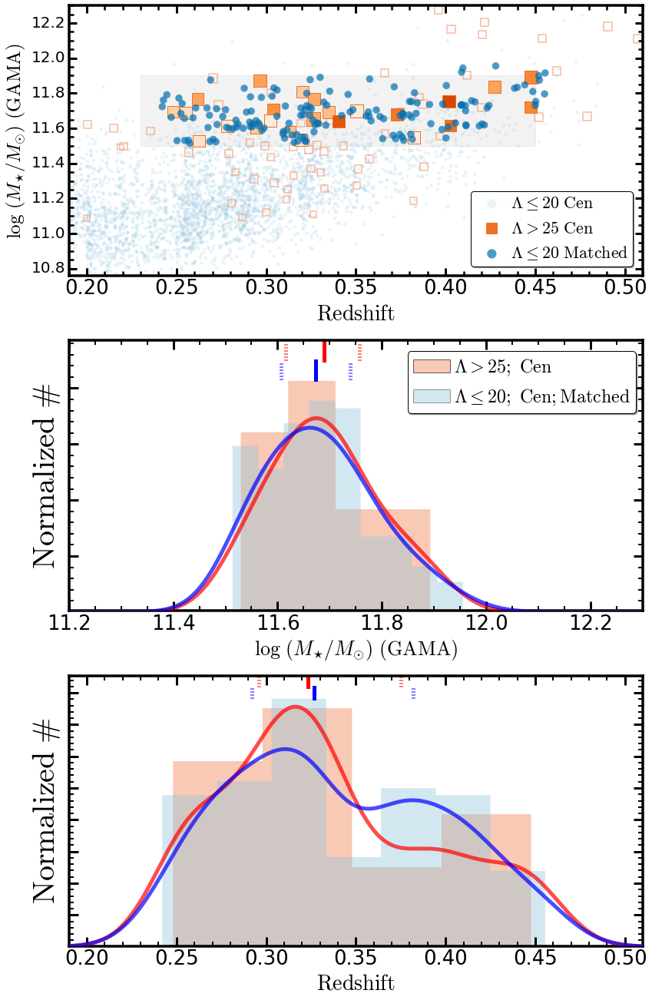

In [40]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['logms_gama'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['logms_gama'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['logms_gama'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['logms_gama'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{GAMA})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['logms_gama'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['logms_gama'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['logms_gama'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['logms_gama'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{GAMA})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['logms_gama']), 
          np.nanmedian(bcgUse['logms_gama'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['logms_gama'], 25), 
          np.percentile(bcgUse['logms_gama'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['logms_gama'], 75), 
          np.percentile(bcgUse['logms_gama'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['logms_gama']), 
          np.nanmedian(gamaUnique['logms_gama'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['logms_gama'], 25), 
          np.percentile(gamaUnique['logms_gama'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['logms_gama'], 75), 
          np.percentile(gamaUnique['logms_gama'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [41]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI3', 
                                            col2='KCORRECT_I', kind='sbp')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI3', 
                                            col2='KCORRECT_I', kind='sbp')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='KCORRECT_I', kind='sbp')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='KCORRECT_I', kind='sbp')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI1', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI1', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR1', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR1', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ1', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ1', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_gama_1 : Will deal with 24 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save bcg_matchAll_gama_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_gama_1_profs.pkl
## Sample gama_matchAll_gama_1 : Will deal with 151 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save gama_matchAll_gama_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_gama_1_profs.pkl


/usr/local/lib/python2.7/site-packages/numpy/lib/nanfunctions.py:740: RuntimeWarning: All-NaN slice encountered
  warnings.warn("All-NaN slice encountered", RuntimeWarning)


## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:237: RuntimeWarning: invalid value encountered in subtract


11.0589039547
10.891130704


/usr/local/lib/python2.7/site-packages/numpy/lib/function_base.py:3823: RuntimeWarning: Invalid value encountered in percentile
  RuntimeWarning)


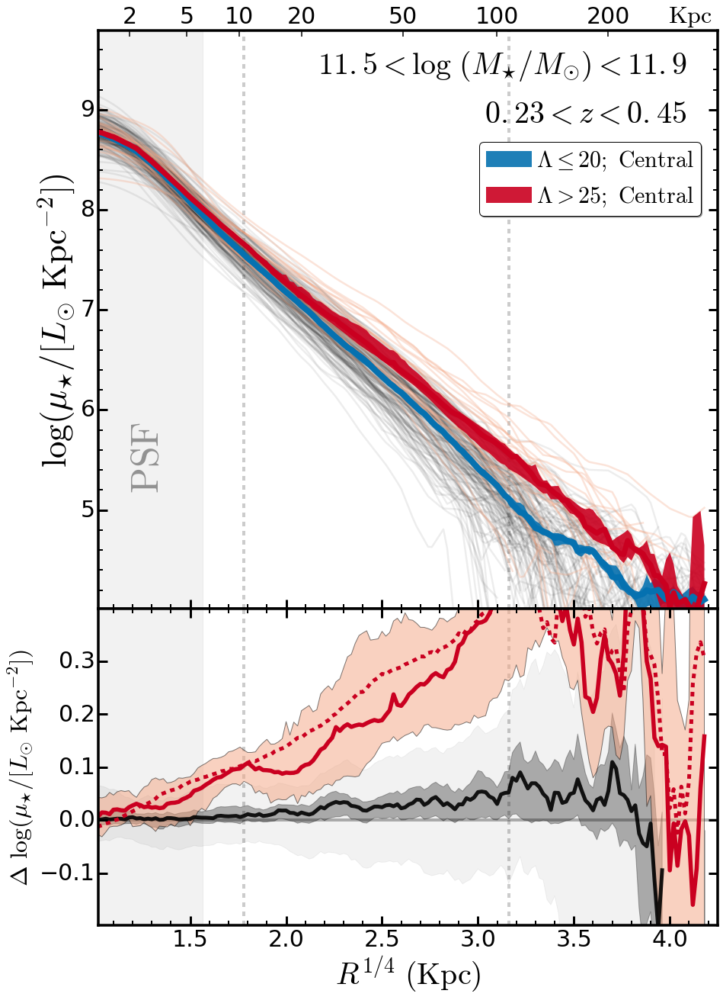

In [42]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[L_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[L_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

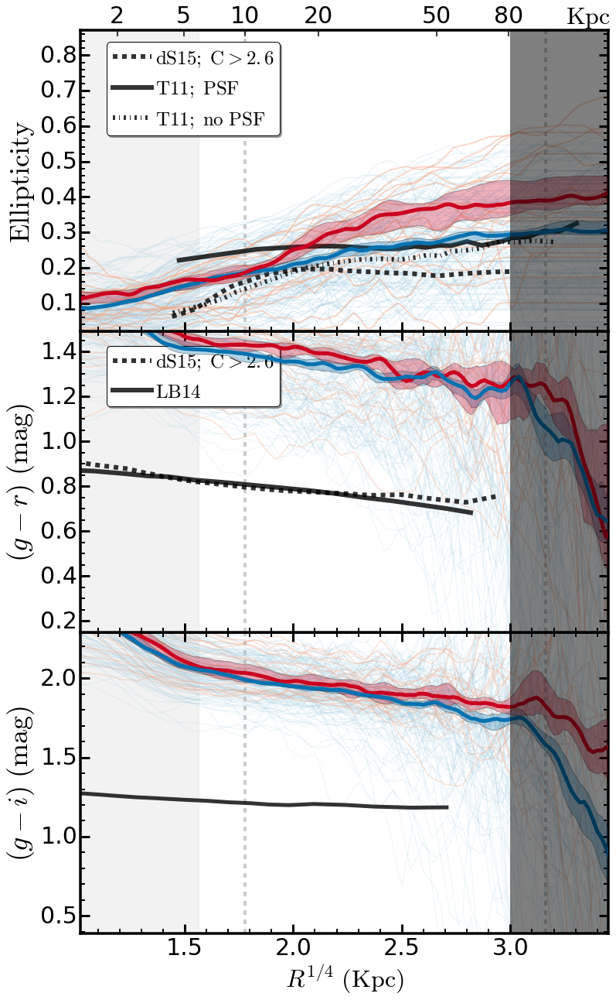

In [43]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

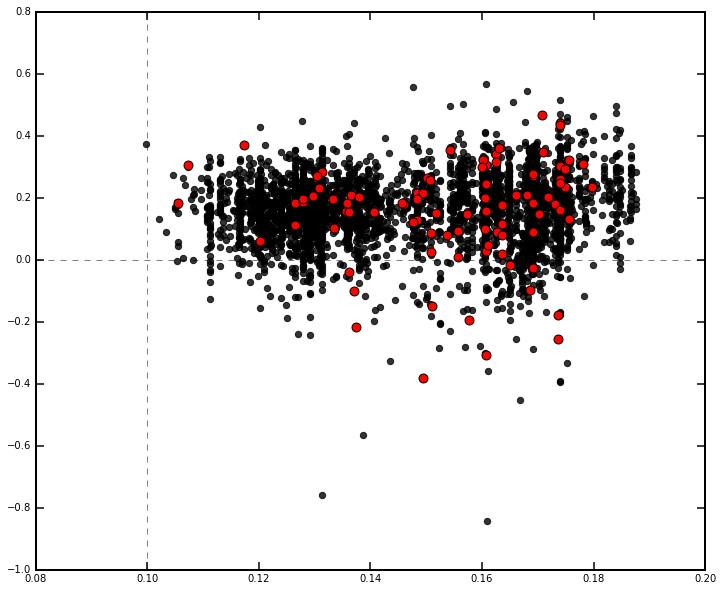

In [44]:
plt.axhline(0.0, linestyle='--', c='k', alpha=0.5)
plt.axvline(0.1, linestyle='--', c='k', alpha=0.5)

plt.scatter((gamaClean['ABSMAG_Z'] - gamaClean['ABSMAG_Y']), 
            (gamaClean['m100_c'] - gamaClean['logms_gama']), 
            s=40, c='k', alpha=0.8)

plt.scatter((bcgClean['ABSMAG_Z'] - bcgClean['ABSMAG_Y']), 
            (bcgClean['m100_c'] - bcgClean['logms_gama']), s=80, c='r')

#plt.xlim(11.2, 12.5)

plt.show()

# Whole Sample; Using M100

## Using Mass Model C;  0.2 < z < 0.5;  Lambda > 30

In [118]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_m100_1'
mlim0, mlim1 = 11.45, 11.95
zlim0, zlim1 = 0.20, 0.45
lamLimit = 35
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m100_c'] >= mlim0) & 
                  (bcgClean['m100_c'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 + 0.005)) & 
                    (gamaClean['m100_c'] <= (mlim1 + 0.05)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] <= 11.8]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] <= 11.8]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] > 11.8]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] > 11.8]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m100_c']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=8) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=15) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  23
# GAMA Sample Size:  1103
# Matched < 11.65 120
# Matched > 11.65 120
# All and Unique Matched Sample 240 151


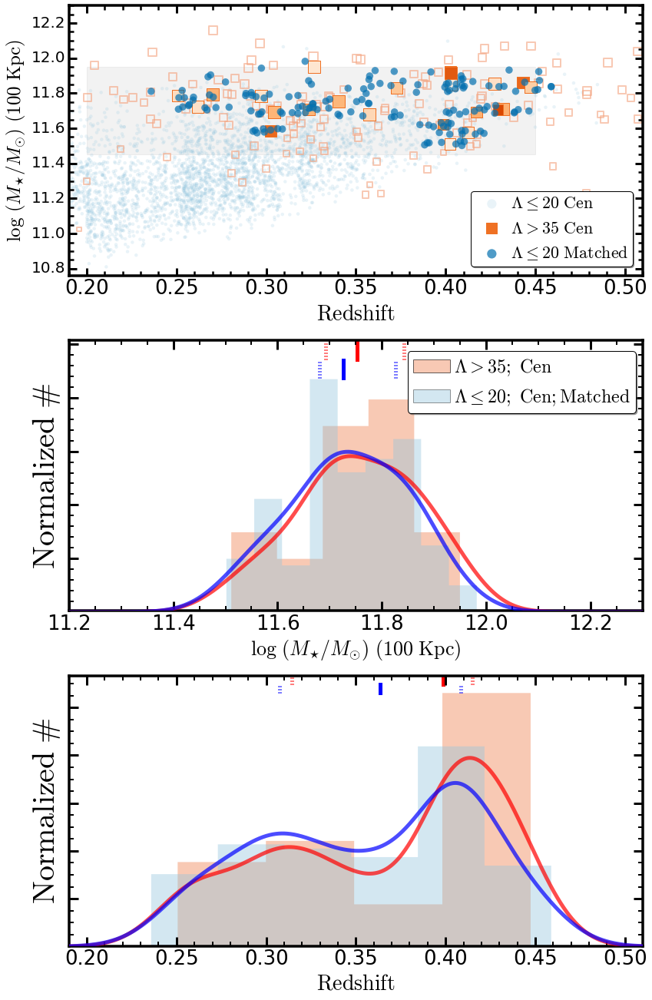

In [119]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m100_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m100_c'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m100_c'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m100_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m100_c'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m100_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m100_c']), np.nanmedian(bcgUse['m100_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m100_c'], 25), 
          np.percentile(bcgUse['m100_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m100_c'], 75), 
          np.percentile(bcgUse['m100_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m100_c']), np.nanmedian(gamaUnique['m100_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m100_c'], 25), 
          np.percentile(gamaUnique['m100_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m100_c'], 75), 
          np.percentile(gamaUnique['m100_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [120]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_m100_1 : Will deal with 23 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save bcg_matchAll_m100_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_m100_1_profs.pkl
## Sample gama_matchAll_m100_1 : Will deal with 151 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save gama_matchAll_m100_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_m100_1_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:237: RuntimeWarning: invalid value encountered in subtract


11.4642538143
11.452250121


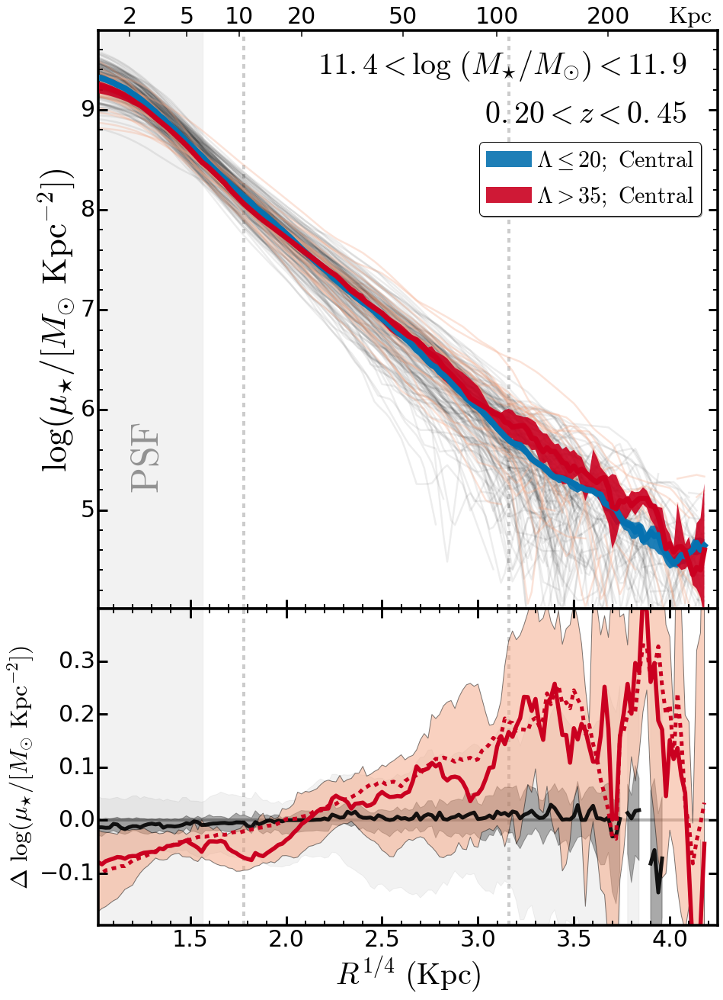

In [121]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

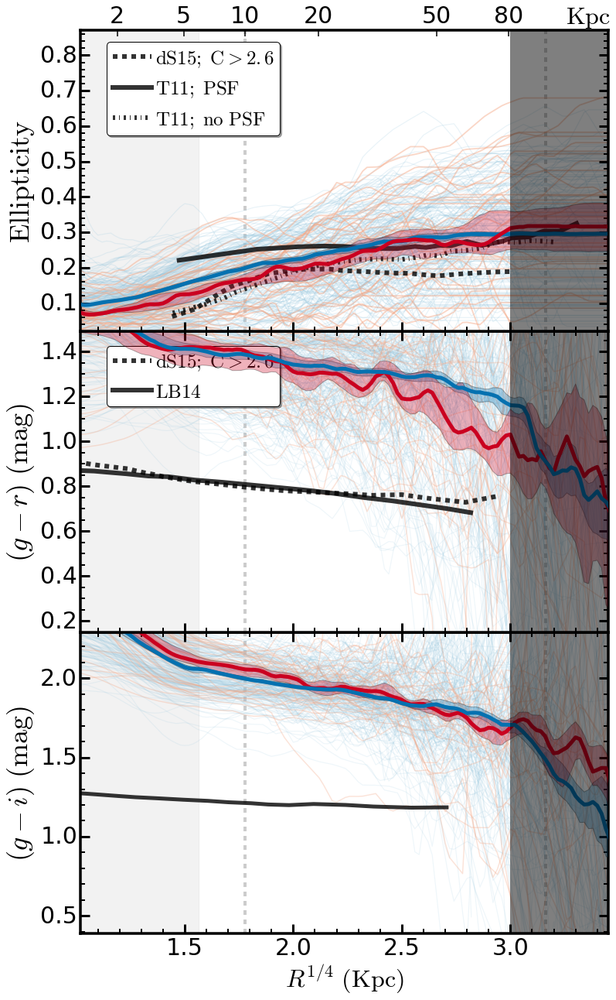

In [49]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

## Using Mass Model C:  0.18 < z < 0.42;  Lambda > 20

In [63]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_m100_2'
mlim0, mlim1 = 11.50, 11.90
zlim0, zlim1 = 0.20, 0.40
lamLimit = 20
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m100_c'] >= mlim0) & 
                  (bcgClean['m100_c'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 + 0.005)) & 
                    (gamaClean['m100_c'] <= (mlim1 + 0.05)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] <= 11.70]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] <= 11.70]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] > 11.70]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] > 11.70]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m100_c']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=4) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=9) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  58
# GAMA Sample Size:  804
# Matched < 11.65 72
# Matched > 11.65 360
# All and Unique Matched Sample 432 203


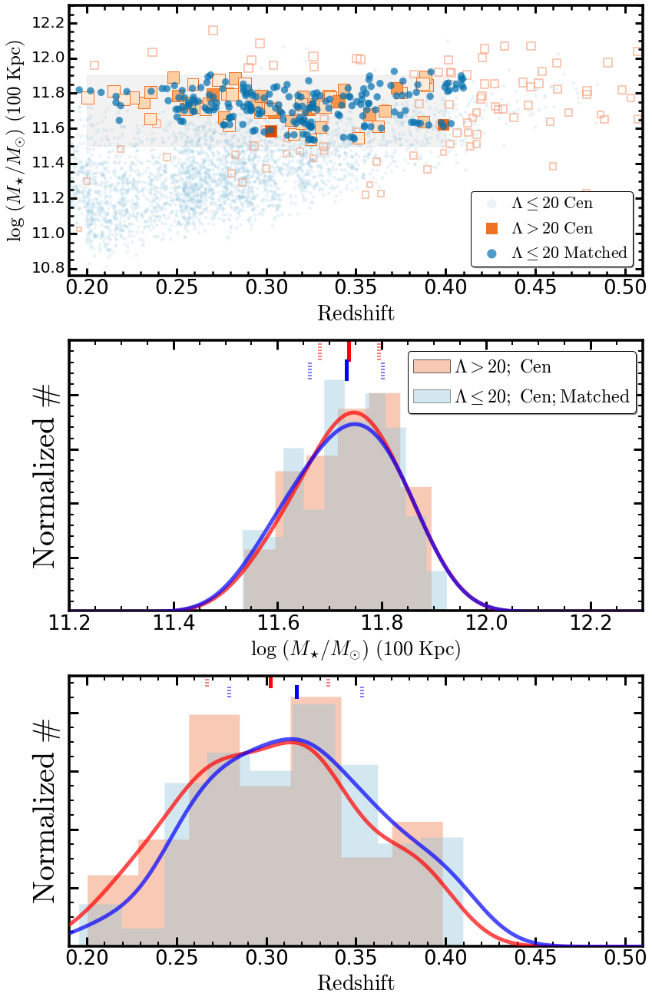

In [64]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m100_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m100_c'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m100_c'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m100_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m100_c'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m100_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m100_c']), np.nanmedian(bcgUse['m100_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m100_c'], 25), 
          np.percentile(bcgUse['m100_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m100_c'], 75), 
          np.percentile(bcgUse['m100_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m100_c']), np.nanmedian(gamaUnique['m100_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m100_c'], 25), 
          np.percentile(gamaUnique['m100_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m100_c'], 75), 
          np.percentile(gamaUnique['m100_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [65]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_m100_2 : Will deal with 58 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save bcg_matchAll_m100_2 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_m100_2_profs.pkl
## Sample gama_matchAll_m100_2 : Will deal with 203 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save gama_matchAll_m100_2 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_m100_2_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:237: RuntimeWarning: invalid value encountered in subtract


11.4901125627
11.4886814571


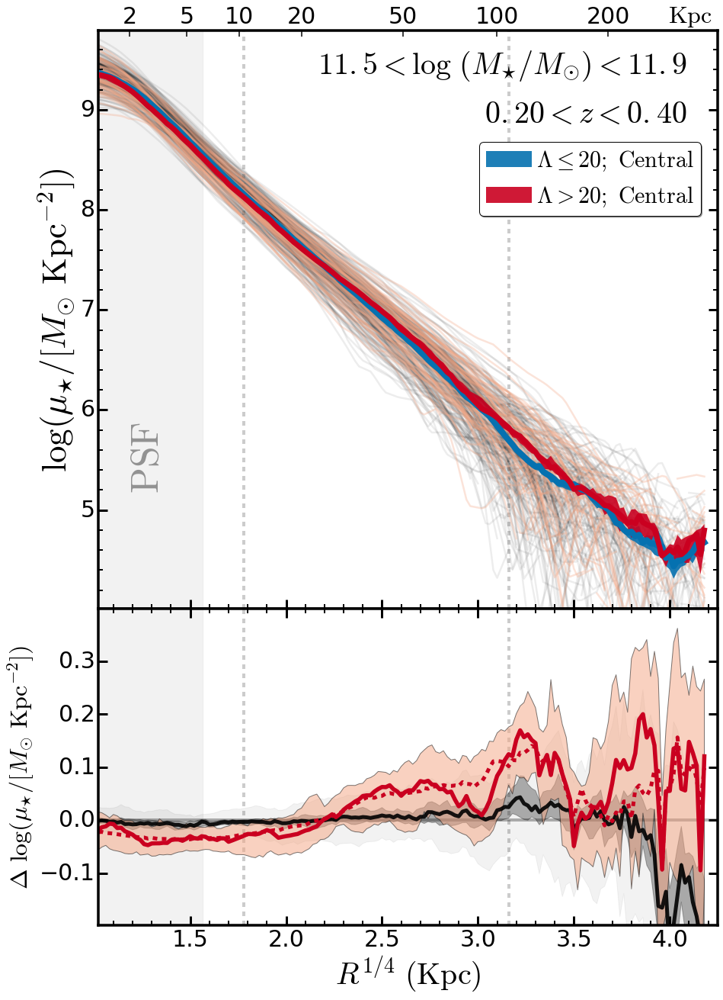

In [66]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

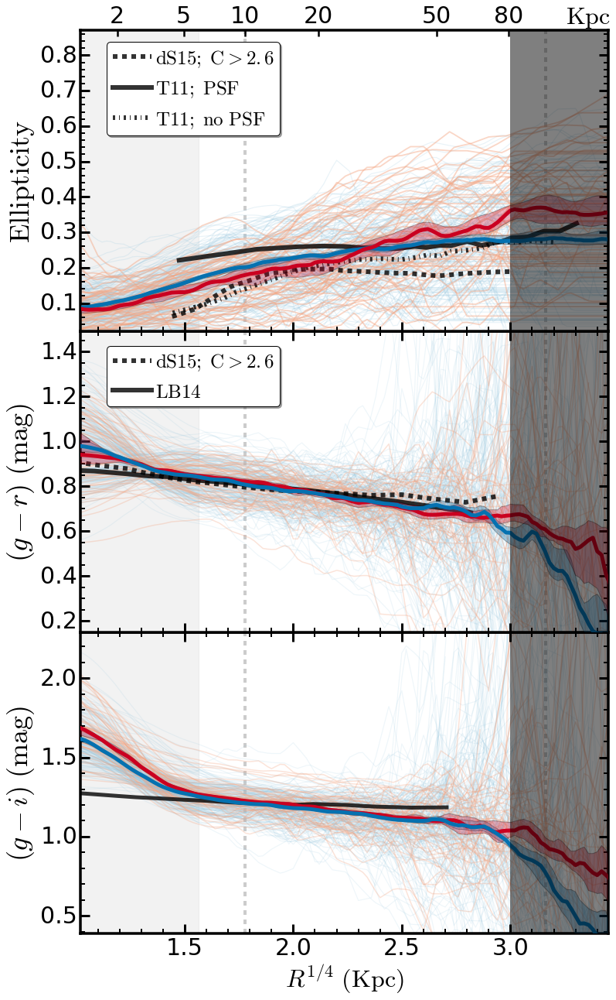

In [382]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

# Whole Sample; Using M100 

## Using Mass Model A 

In [389]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_m100_3'
mlim0, mlim1 = 11.50, 11.90
zlim0, zlim1 = 0.20, 0.40
lamLimit = 20
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m100_a'] >= mlim0) & 
                  (bcgClean['m100_a'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_a'] >= (mlim0 + 0.005)) & 
                    (gamaClean['m100_a'] <= (mlim1 + 0.10)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['m100_a'] <= 11.75]['m100_a']), 
                   np.asarray(bcgUse[bcgUse['m100_a'] <= 11.75]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['m100_a'] > 11.75]['m100_a']), 
                   np.asarray(bcgUse[bcgUse['m100_a'] > 11.75]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m100_a']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=4) 
print("# Matched < 11.70", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=10) 
print("# Matched > 11.70", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  59
# GAMA Sample Size:  540
# Matched < 11.70 144
# Matched > 11.70 230
# All and Unique Matched Sample 374 200


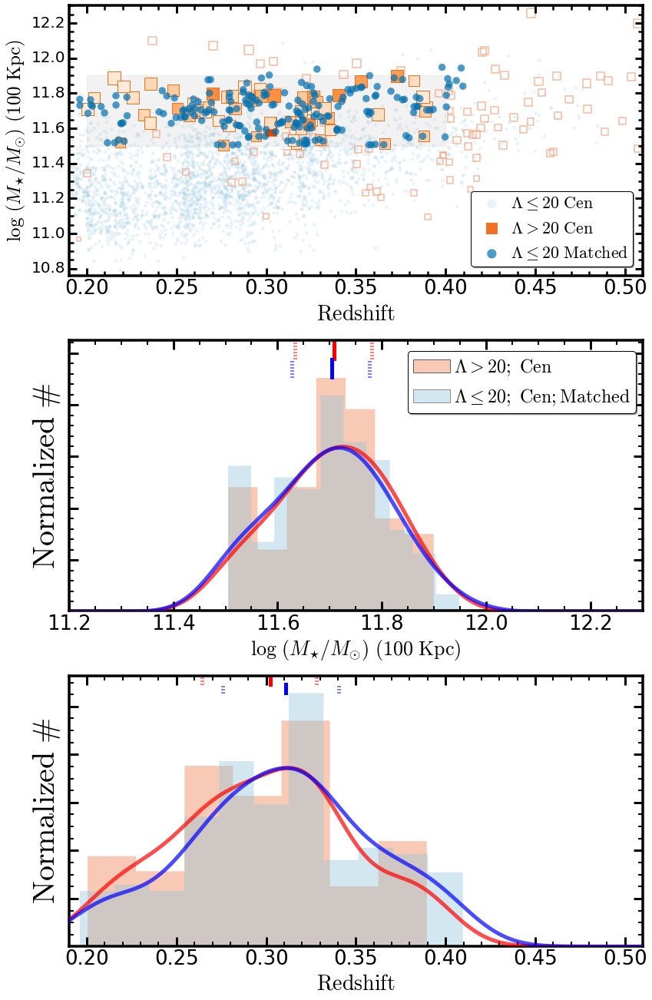

In [391]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m100_a'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m100_a'], 
                 facecolor='none', s=((bcgClean['m10_a'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m100_a'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_a'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m100_a'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m100_a'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m100_a'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m100_a'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m100_a'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m100_a']), np.nanmedian(bcgUse['m100_a'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m100_a'], 25), 
          np.percentile(bcgUse['m100_a'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m100_a'], 75), 
          np.percentile(bcgUse['m100_a'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m100_a']), np.nanmedian(gamaUnique['m100_a'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m100_a'], 25), 
          np.percentile(gamaUnique['m100_a'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m100_a'], 75), 
          np.percentile(gamaUnique['m100_a'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [392]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI_A', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI_A', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI_A', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI_A', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_m100_3 : Will deal with 59 galaxies

## Save bcg_matchAll_m100_3 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_m100_3_profs.pkl
## Sample gama_matchAll_m100_3 : Will deal with 200 galaxies

## Save gama_matchAll_m100_3 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_m100_3_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!
11.4701420632
11.4595622657


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:249: RuntimeWarning: invalid value encountered in subtract


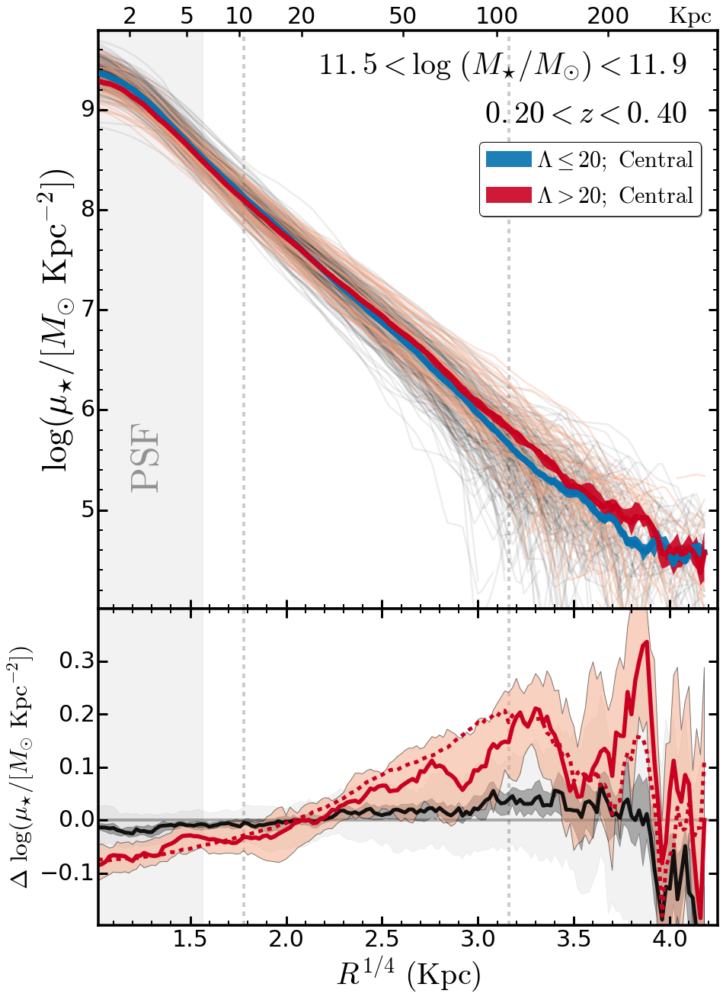

In [393]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

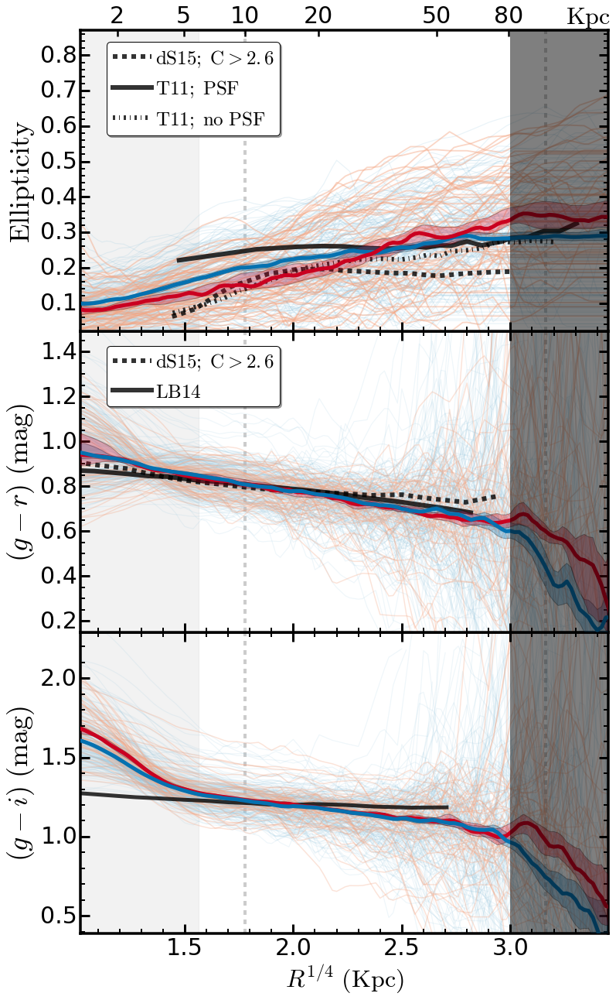

In [394]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

# Whole Sample; 

## Using Model C;  M150

In [395]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_m150_1'
mlim0, mlim1 = 11.50, 11.90
zlim0, zlim1 = 0.20, 0.40
lamLimit = 20
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m150_c'] >= mlim0) & 
                  (bcgClean['m150_c'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m150_c'] >= (mlim0 + 0.005)) & 
                    (gamaClean['m150_c'] <= (mlim1 + 0.05)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['m150_c'] <= 11.70]['m150_c']), 
                   np.asarray(bcgUse[bcgUse['m150_c'] <= 11.70]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['m150_c'] > 11.70]['m150_c']), 
                   np.asarray(bcgUse[bcgUse['m150_c'] > 11.70]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m150_c']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=5) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=10) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:15: RuntimeWarning: invalid value encountered in greater_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:15: RuntimeWarning: invalid value encountered in less_equal
/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:22: RuntimeWarning: invalid value encountered in greater_equal


# BCG Sample Size:  58
# GAMA Sample Size:  514
# Matched < 11.65 160
# Matched > 11.65 260
# All and Unique Matched Sample 420 236


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:22: RuntimeWarning: invalid value encountered in less_equal


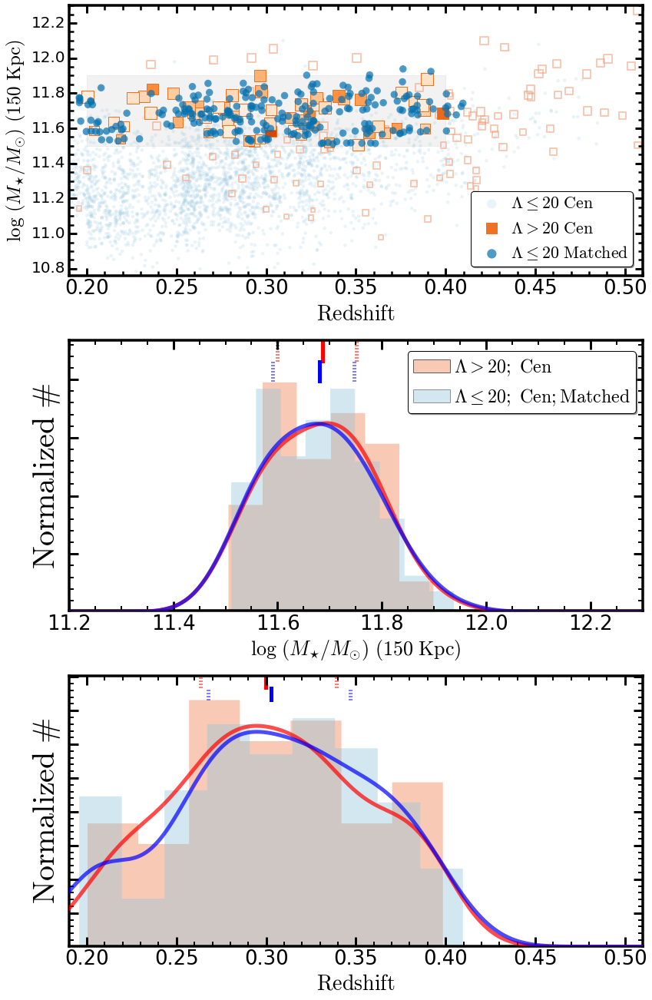

In [396]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m150_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m150_c'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m150_c'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m150_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (150\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m150_c'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m150_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m150_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m150_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{150\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m150_c']), np.nanmedian(bcgUse['m150_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m150_c'], 25), 
          np.percentile(bcgUse['m150_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m150_c'], 75), 
          np.percentile(bcgUse['m150_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m150_c']), np.nanmedian(gamaUnique['m150_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m150_c'], 25), 
          np.percentile(gamaUnique['m150_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m150_c'], 75), 
          np.percentile(gamaUnique['m150_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [397]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI_C', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI_C', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI_C', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI_C', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_m150_1 : Will deal with 58 galaxies

## Save bcg_matchAll_m150_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_m150_1_profs.pkl
## Sample gama_matchAll_m150_1 : Will deal with 236 galaxies

## Save gama_matchAll_m150_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_m150_1_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!
11.4271178715
11.4307751129


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:249: RuntimeWarning: invalid value encountered in subtract


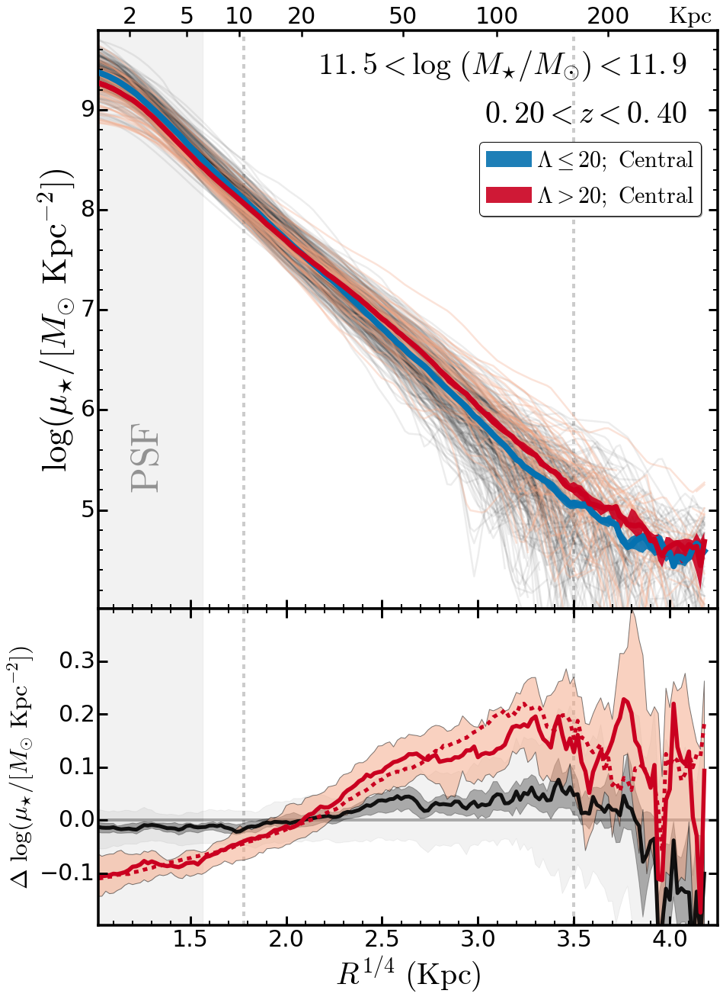

In [398]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(150.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(150.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

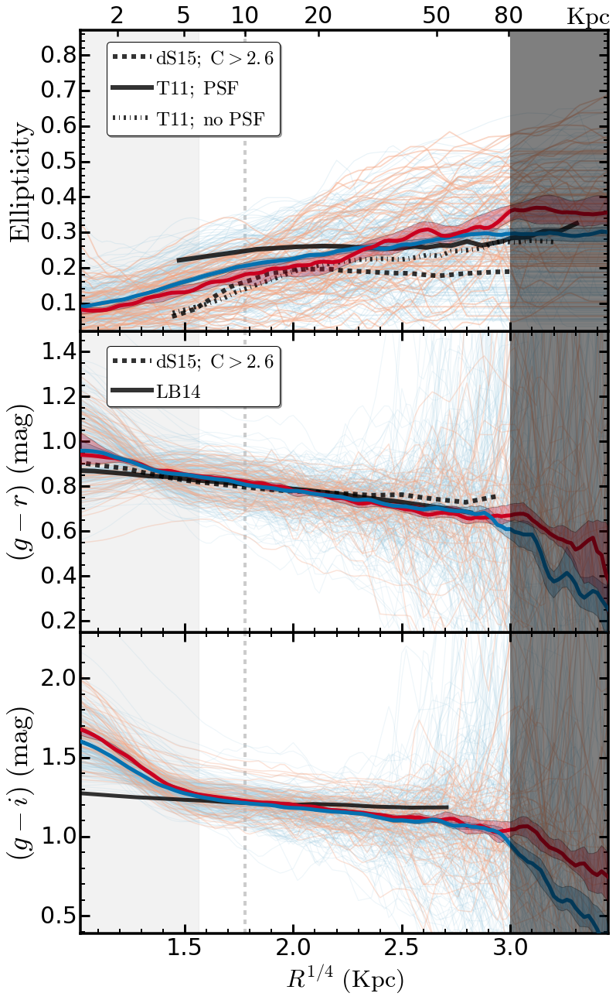

In [399]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(150.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(150.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(150.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

# Whole Sample; Using M10

## Using Mass Model C

In [108]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_m10_1'
mlim0, mlim1 = 11.50, 11.80
zlim0, zlim1 = 0.20, 0.40
lamLimit = 20
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m100_c'] >= mlim0) & 
                  (bcgClean['m100_c'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 - 0.20)) & 
                    (gamaClean['m100_c'] <= (mlim1 + 0.20)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['m10_c'] <= 11.35]['m10_c']), 
                   np.asarray(bcgUse[bcgUse['m10_c'] <= 11.35]['m5_c']),
                   np.asarray(bcgUse[bcgUse['m10_c'] <= 11.35]['m15_c']),
                   np.asarray(bcgUse[bcgUse['m10_c'] <= 11.35]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['m10_c'] > 11.35]['m10_c']), 
                   np.asarray(bcgUse[bcgUse['m10_c'] > 11.35]['m5_c']),
                   np.asarray(bcgUse[bcgUse['m10_c'] > 11.35]['m15_c']),
                   np.asarray(bcgUse[bcgUse['m10_c'] > 11.35]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m10_c']),
                   np.asarray(gamaUse['m5_c']),
                   np.asarray(gamaUse['m15_c']),
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=6)  

dist, ind1 = gamaTree.query(bcgZM1, k=5) 
print("# Matched < 11.25", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=4) 
print("# Matched > 11.25", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
#indAll = ind1.ravel()
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  45
# GAMA Sample Size:  1902
# Matched < 11.25 125
# Matched > 11.25 80
# All and Unique Matched Sample 205 167


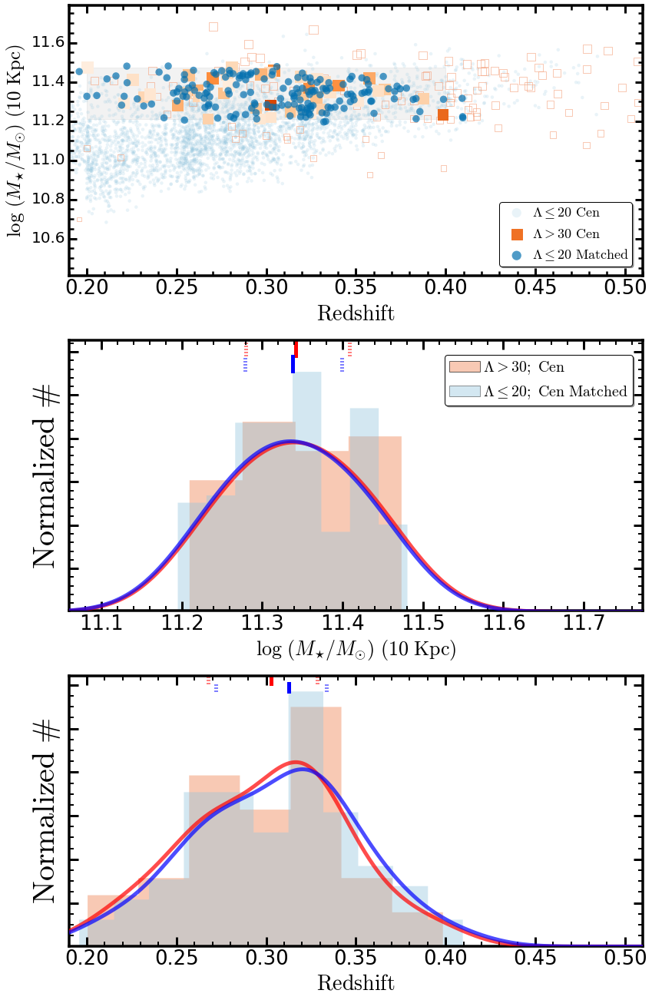

In [109]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 10.41, 11.79
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
m10_0, m10_1 = np.nanmin(bcgUse['m10_c']), np.nanmax(bcgUse['m10_c'])
ax1.fill_between([zlim0, zlim1], [m10_0, m10_0], [m10_1, m10_1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m10_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m10_c'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s',
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m10_c'], 
                 edgecolor='none', s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 30\ \mathrm{Cen}$', marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m10_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.75, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (10\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(mmin, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m10_c'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m10_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m10_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > 30;\ \mathrm{Cen}$')
bb, _, _ = hist(gamaUnique['m10_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen\ Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(m10_0-0.15, m10_1+0.30)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.655, 0.76), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{10\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m10_c']), np.nanmedian(bcgUse['m10_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m10_c'], 25), 
          np.percentile(bcgUse['m10_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m10_c'], 75), 
          np.percentile(bcgUse['m10_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m10_c']), np.nanmedian(gamaUnique['m10_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m10_c'], 25), 
          np.percentile(gamaUnique['m10_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m10_c'], 75), 
          np.percentile(gamaUnique['m10_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [110]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_m10_1 : Will deal with 45 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save bcg_matchAll_m10_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_m10_1_profs.pkl
## Sample gama_matchAll_m10_1 : Will deal with 167 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save gama_matchAll_m10_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_m10_1_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:237: RuntimeWarning: invalid value encountered in subtract


11.4546427472
11.4027992257


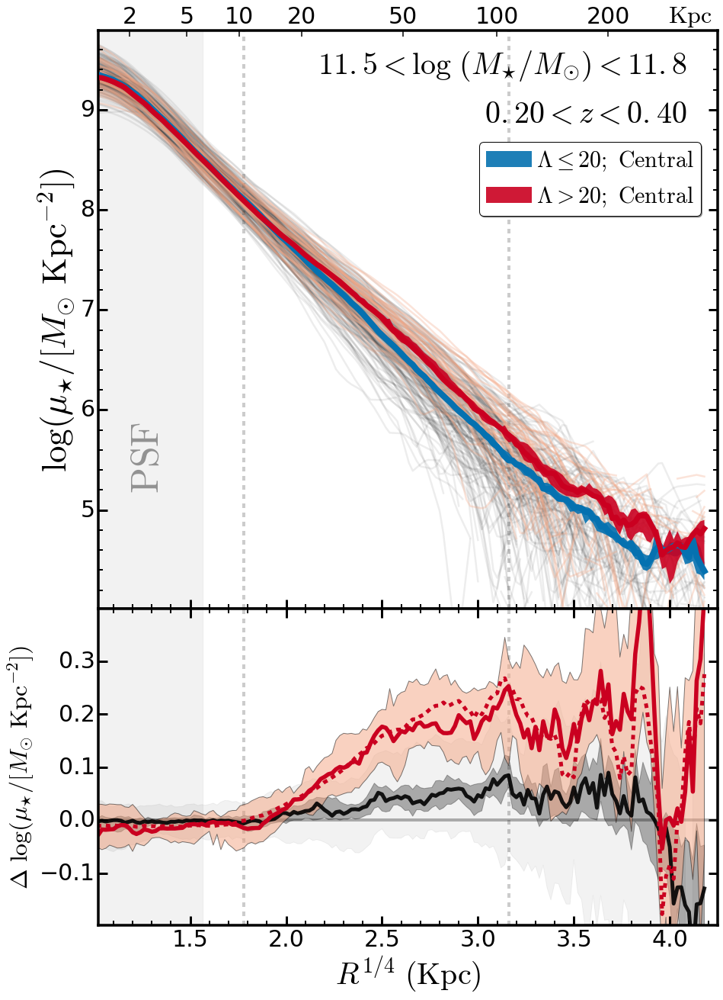

In [111]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

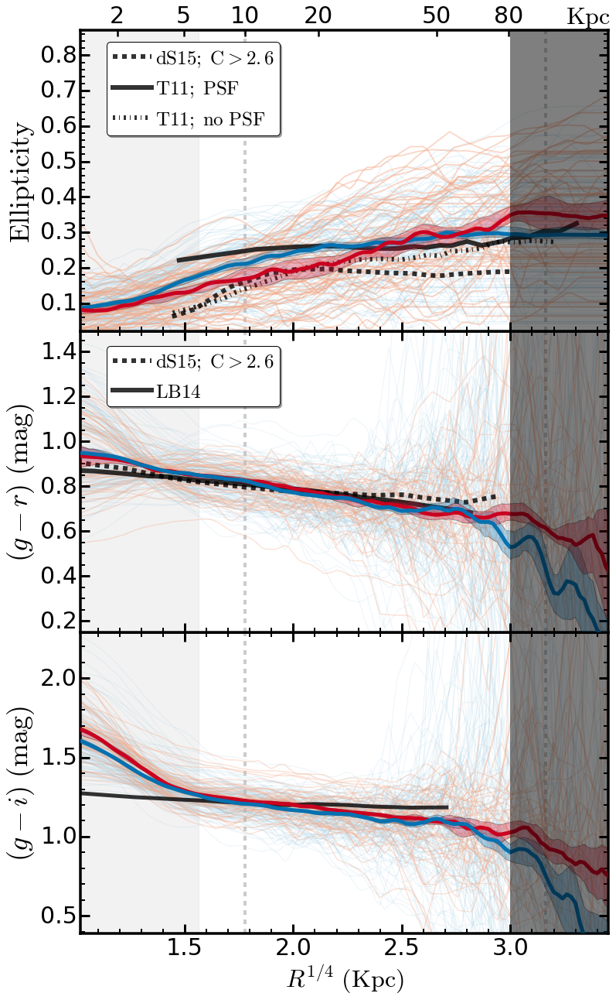

In [436]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

# Sub-Samples

## M1: 11.5 < logM* < 11.7;   Choice A

In [75]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchM1_m100_1'
mlim0, mlim1 = 11.50, 11.70
zlim0, zlim1 = 0.20, 0.40
lamLimit = 20
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m100_c'] >= mlim0) & 
                  (bcgClean['m100_c'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 + 0.005)) & 
                    (gamaClean['m100_c'] <= (mlim1 + 0.100)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['z_use'] <= 0.32]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['z_use'] <= 0.32]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['z_use'] > 0.32]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['z_use'] > 0.32]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m100_c']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=5) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=6) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  18
# GAMA Sample Size:  747
# Matched < 11.65 50
# Matched > 11.65 48
# All and Unique Matched Sample 98 92


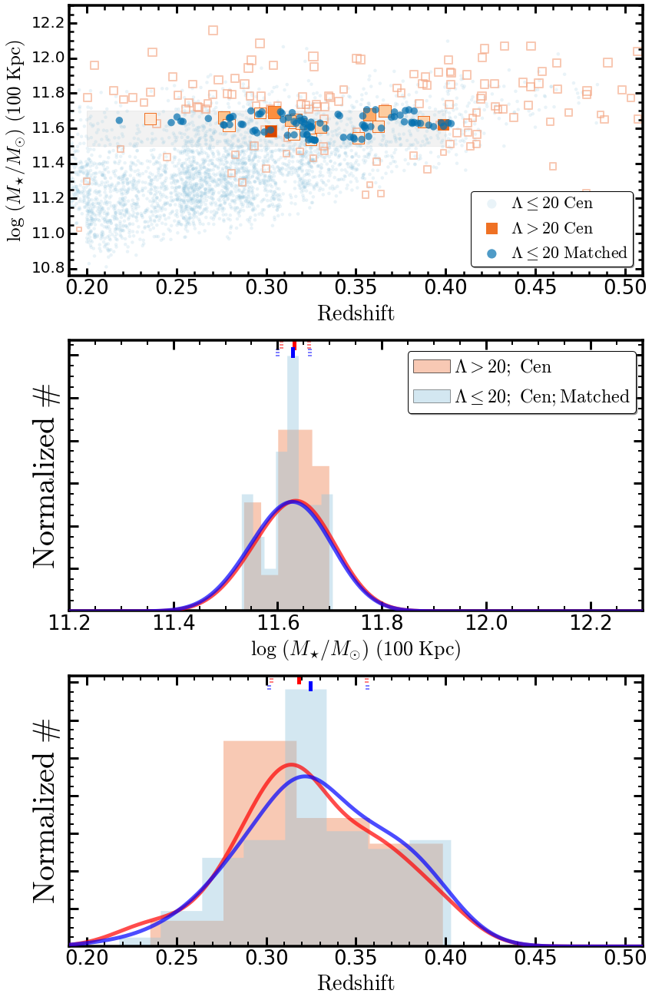

In [76]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m100_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m100_c'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m100_c'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m100_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m100_c'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m100_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m100_c']), np.nanmedian(bcgUse['m100_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m100_c'], 25), 
          np.percentile(bcgUse['m100_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m100_c'], 75), 
          np.percentile(bcgUse['m100_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m100_c']), np.nanmedian(gamaUnique['m100_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m100_c'], 25), 
          np.percentile(gamaUnique['m100_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m100_c'], 75), 
          np.percentile(gamaUnique['m100_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [77]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchM1_m100_1 : Will deal with 18 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save bcg_matchM1_m100_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchM1_m100_1_profs.pkl
## Sample gama_matchM1_m100_1 : Will deal with 92 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save gama_matchM1_m100_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchM1_m100_1_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:237: RuntimeWarning: invalid value encountered in subtract


11.3702569712
11.3584630674


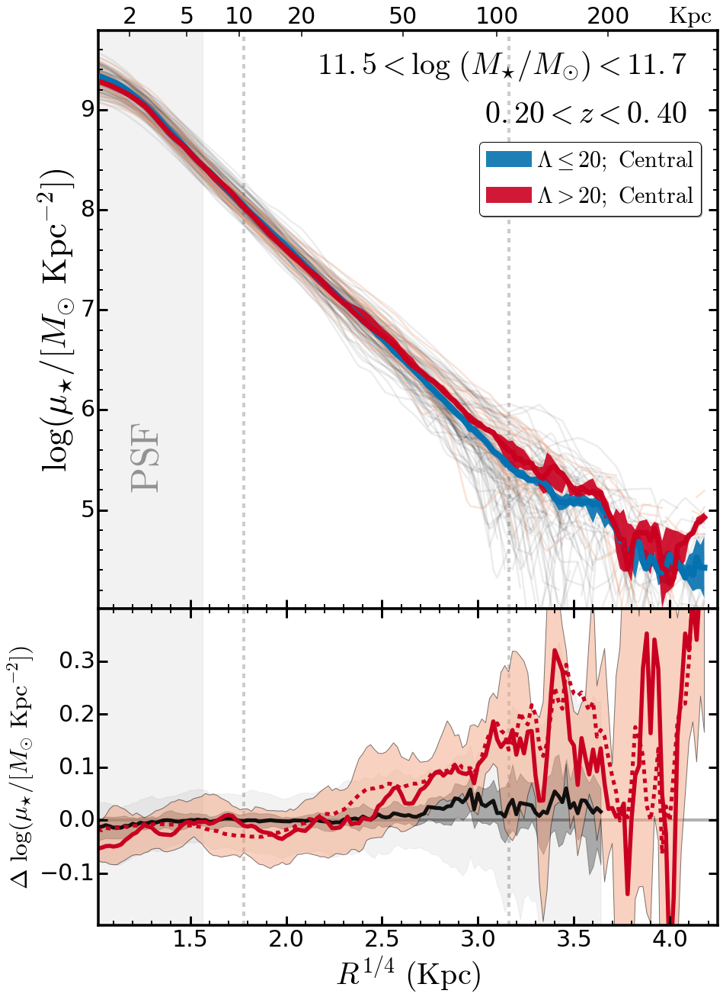

In [78]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

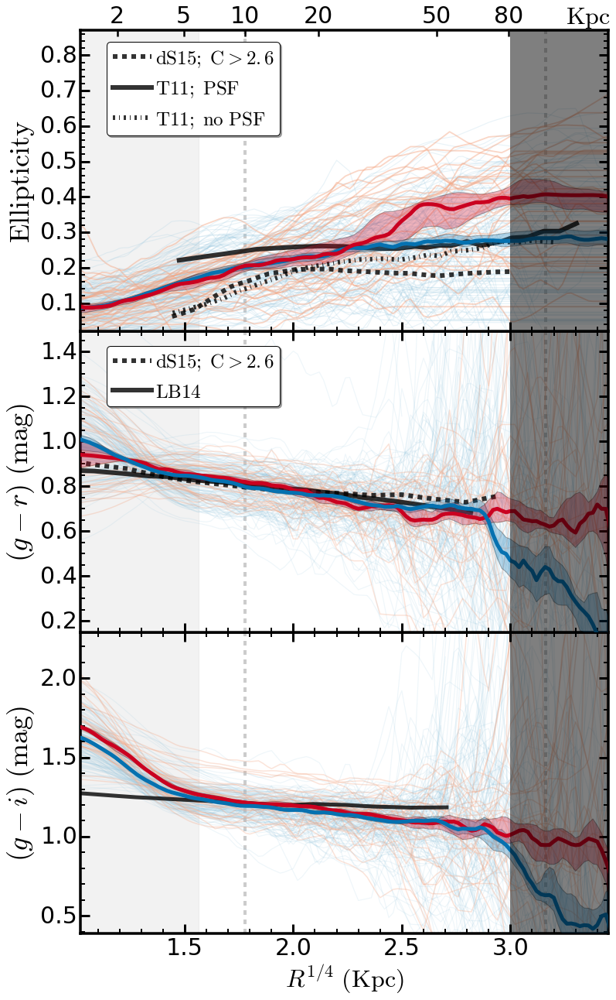

In [443]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

## M2: 11.7 < logM < 11.9; Cut 1

In [87]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchM2_m100_1'
mlim0, mlim1 = 11.70, 11.92
zlim0, zlim1 = 0.20, 0.50
lamLimit = 30
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m100_c'] >= mlim0) & 
                  (bcgClean['m100_c'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 - 0.001)) & 
                    (gamaClean['m100_c'] <= (mlim1)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] <= 11.8]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] <= 11.8]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] > 11.8]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] > 11.8]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m100_c']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=7) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=15) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  28
# GAMA Sample Size:  223
# Matched < 11.65 105
# Matched > 11.65 195
# All and Unique Matched Sample 300 136


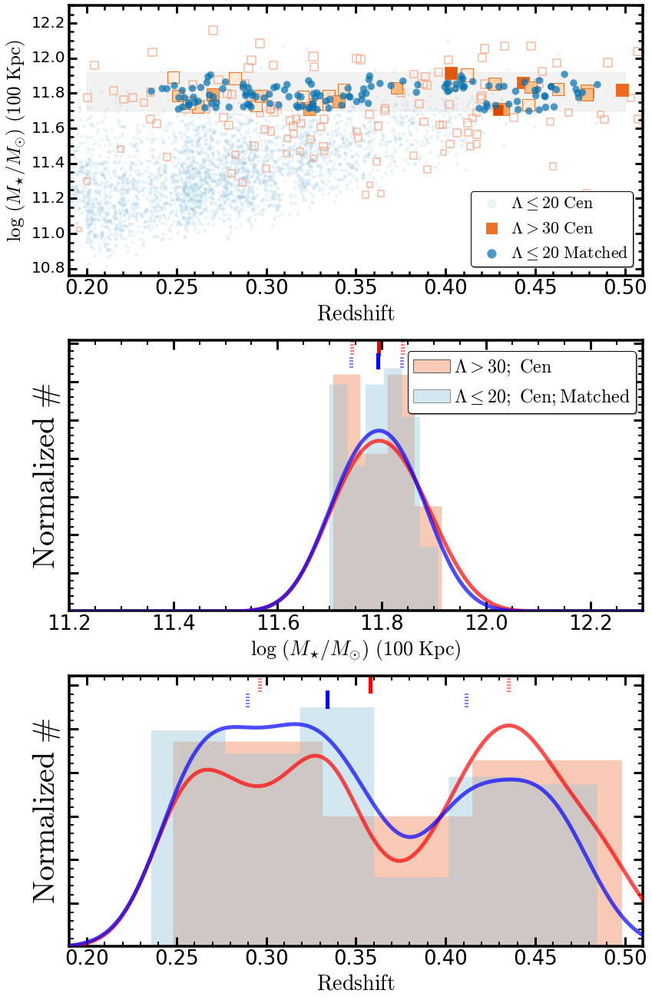

In [88]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m100_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m100_c'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m100_c'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m100_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m100_c'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m100_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m100_c']), np.nanmedian(bcgUse['m100_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m100_c'], 25), 
          np.percentile(bcgUse['m100_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m100_c'], 75), 
          np.percentile(bcgUse['m100_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m100_c']), np.nanmedian(gamaUnique['m100_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m100_c'], 25), 
          np.percentile(gamaUnique['m100_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m100_c'], 75), 
          np.percentile(gamaUnique['m100_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [90]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchM2_m100_1 : Will deal with 28 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save bcg_matchM2_m100_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchM2_m100_1_profs.pkl
## Sample gama_matchM2_m100_1 : Will deal with 136 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save gama_matchM2_m100_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchM2_m100_1_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:237: RuntimeWarning: invalid value encountered in subtract


11.4970554262
11.5253837178


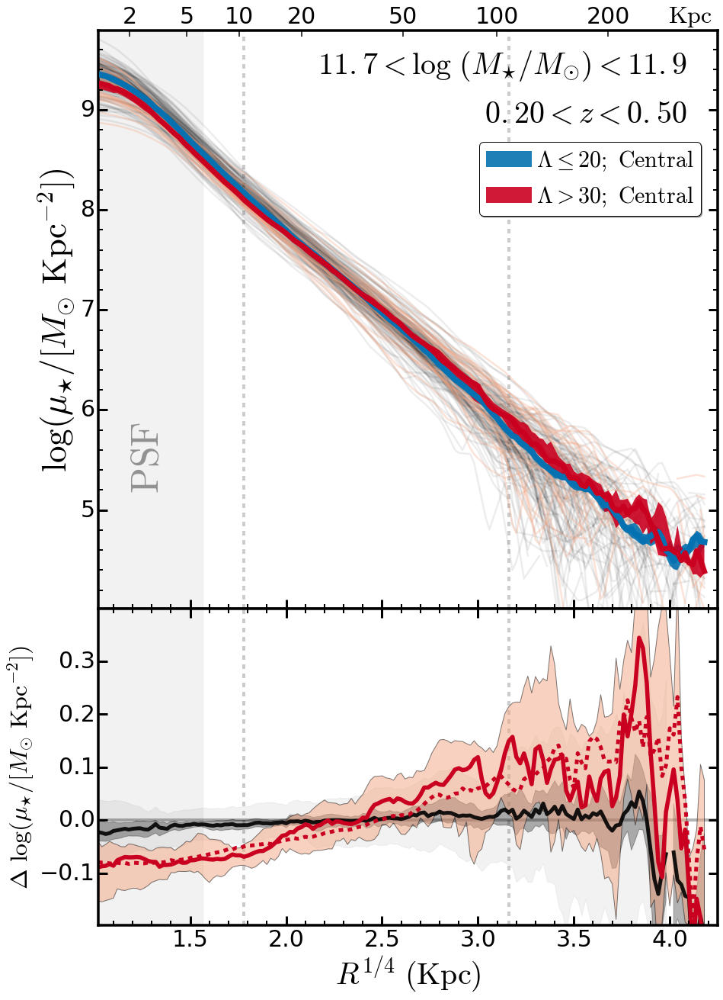

In [91]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

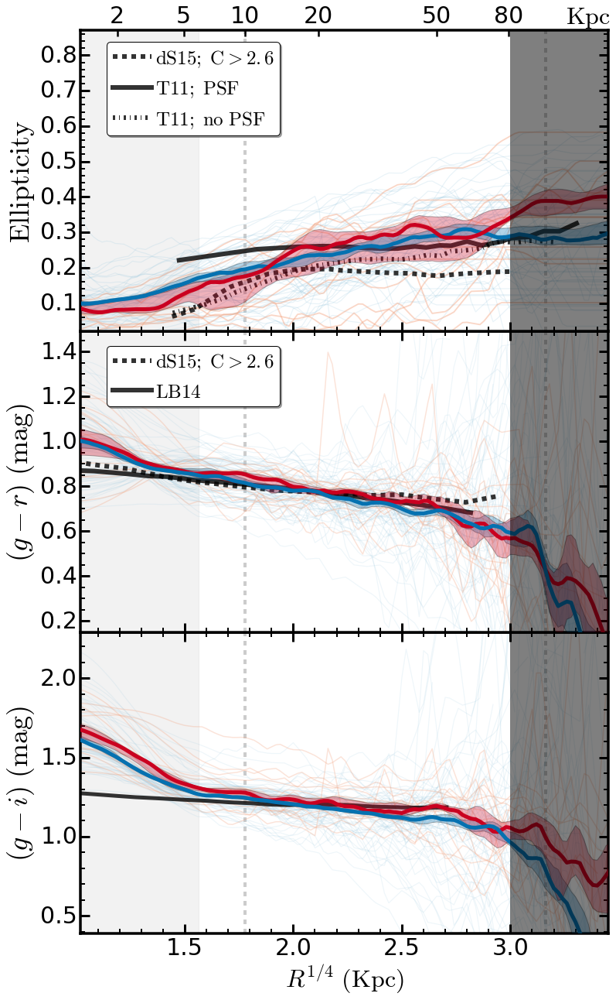

In [451]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

## M2: 11.7 < logM < 11.9;  Cut 2

In [92]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchM2_m100_2'
mlim0, mlim1 = 11.70, 11.93
zlim0, zlim1 = 0.20, 0.45
lamLimit = 30
pcenLimit = 0.8

## BCG sample used for matching
bcgUse = bcgClean[(bcgClean['m100_c'] >= mlim0) & 
                  (bcgClean['m100_c'] <= mlim1) & 
                  (bcgClean['z_use'] >= zlim0) &
                  (bcgClean['z_use'] <= zlim1) &
                  (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 - 0.005)) & 
                    (gamaClean['m100_c'] <= (mlim1 - 0.01)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] <= 11.80]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] <= 11.80]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['m100_c'] > 11.80]['m100_c']), 
                   np.asarray(bcgUse[bcgUse['m100_c'] > 11.80]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m100_c']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=6) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=10) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  25
# GAMA Sample Size:  220
# Matched < 11.65 84
# Matched > 11.65 110
# All and Unique Matched Sample 194 117


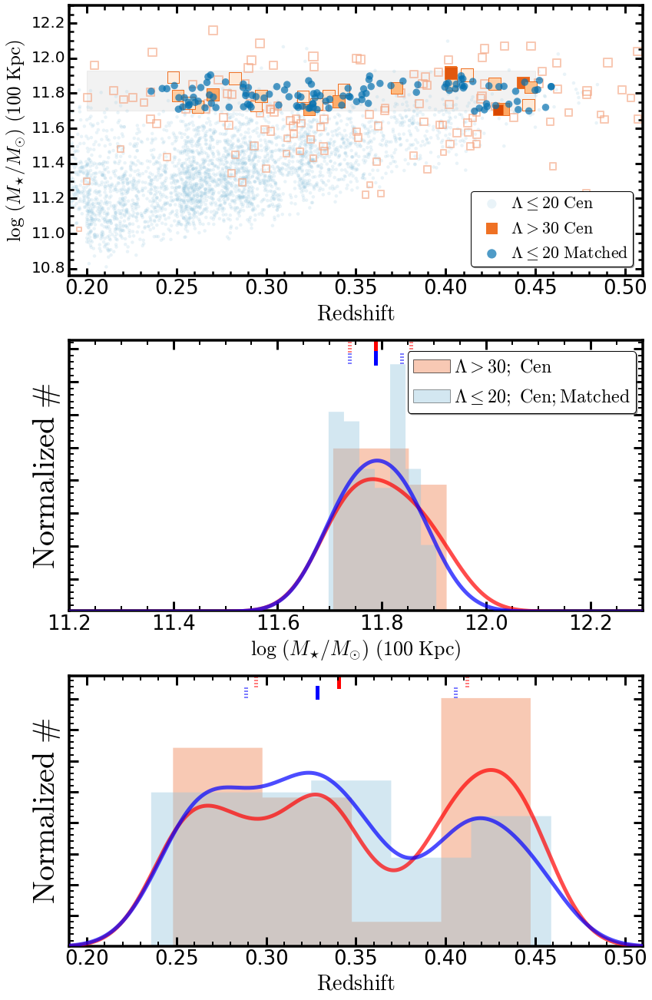

In [93]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m100_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['m100_c'], 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['m100_c'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m100_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['m100_c'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m100_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['m100_c']), np.nanmedian(bcgUse['m100_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['m100_c'], 25), 
          np.percentile(bcgUse['m100_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['m100_c'], 75), 
          np.percentile(bcgUse['m100_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m100_c']), np.nanmedian(gamaUnique['m100_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m100_c'], 25), 
          np.percentile(gamaUnique['m100_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m100_c'], 75), 
          np.percentile(gamaUnique['m100_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [95]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_G', col4='KCORRECT_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchM2_m100_2 : Will deal with 25 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save bcg_matchM2_m100_2 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchM2_m100_2_profs.pkl
## Sample gama_matchM2_m100_2 : Will deal with 117 galaxies


Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"



## Save gama_matchM2_m100_2 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchM2_m100_2_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:237: RuntimeWarning: invalid value encountered in subtract


11.5166780332
11.5327633126


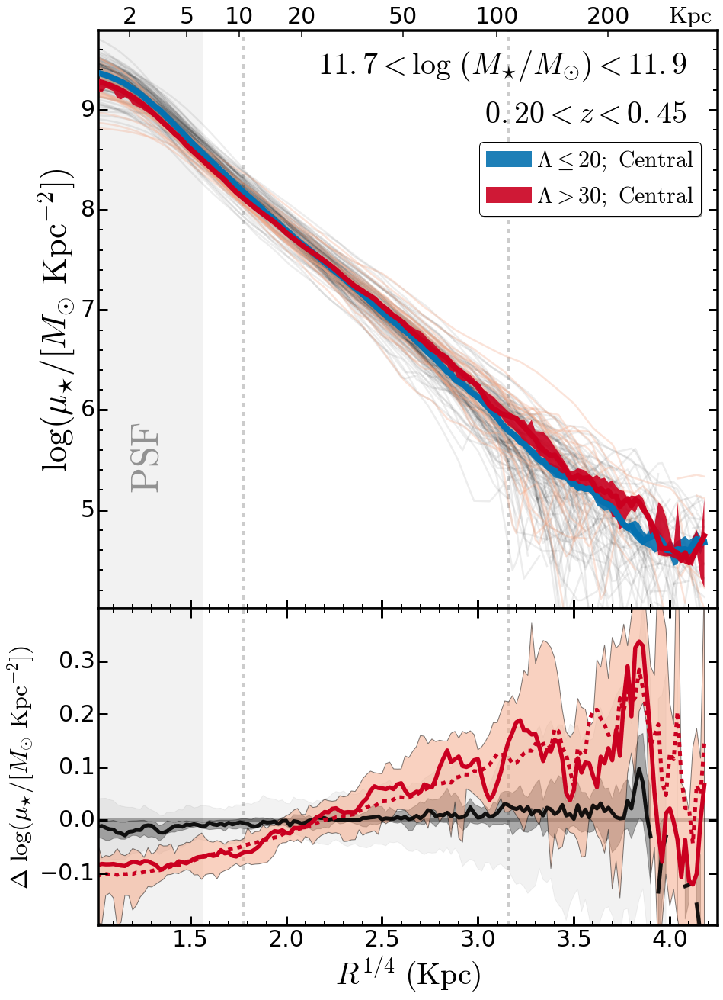

In [96]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

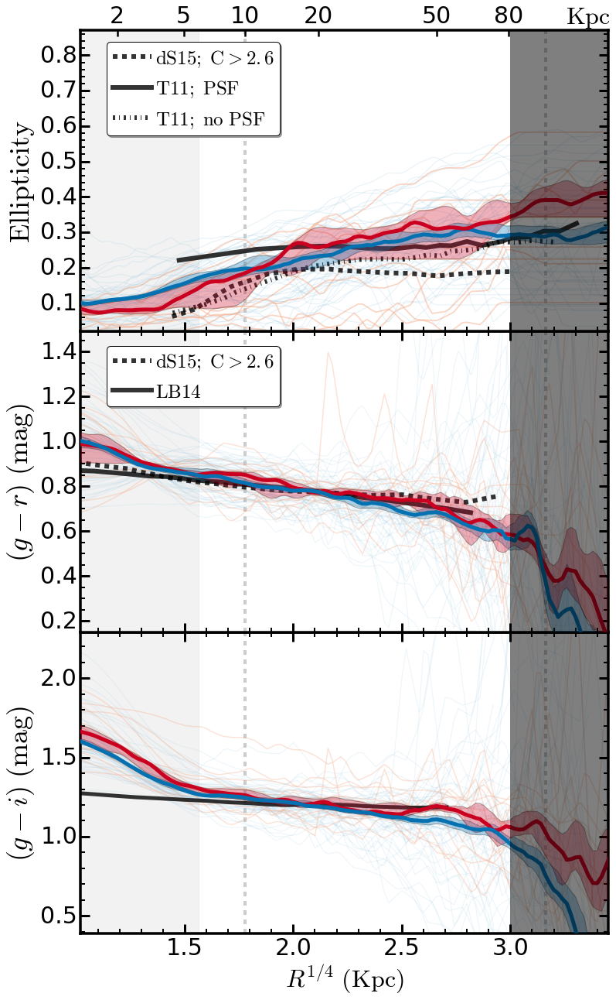

In [457]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

# Mem v.s BCG;  M100

In [505]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchMem_m100_2'
mlim0, mlim1 = 11.50, 11.80
zlim0, zlim1 = 0.20, 0.40
lamLimit = 25
pcenLimit = 0.1

## mem sample used for matching
memUse = memClean[(memClean['m100_c'] >= mlim0) & 
                  (memClean['m100_c'] <= mlim1) & 
                  (memClean['z_use'] >= zlim0) &
                  (memClean['z_use'] <= zlim1) &
                  (memClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (memClean['P_CEN_1'] >= pcenLimit)]
print("# mem Sample Size: ", len(memUse))

## gama sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 + 0.005)) & 
                    (gamaClean['m100_c'] <= (mlim1 + 0.10)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.02)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
memZM1 = np.stack((np.asarray(memUse[memUse['m100_c'] <= 11.60]['m100_c']), 
                   np.asarray(memUse[memUse['m100_c'] <= 11.60]['z_use'])), axis=-1)
memZM2 = np.stack((np.asarray(memUse[memUse['m100_c'] > 11.60]['m100_c']), 
                   np.asarray(memUse[memUse['m100_c'] > 11.60]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m100_c']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(memZM1, k=7) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(memZM2, k=7) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# mem Sample Size:  37
# GAMA Sample Size:  493
# Matched < 11.65 133
# Matched > 11.65 126
# All and Unique Matched Sample 259 180


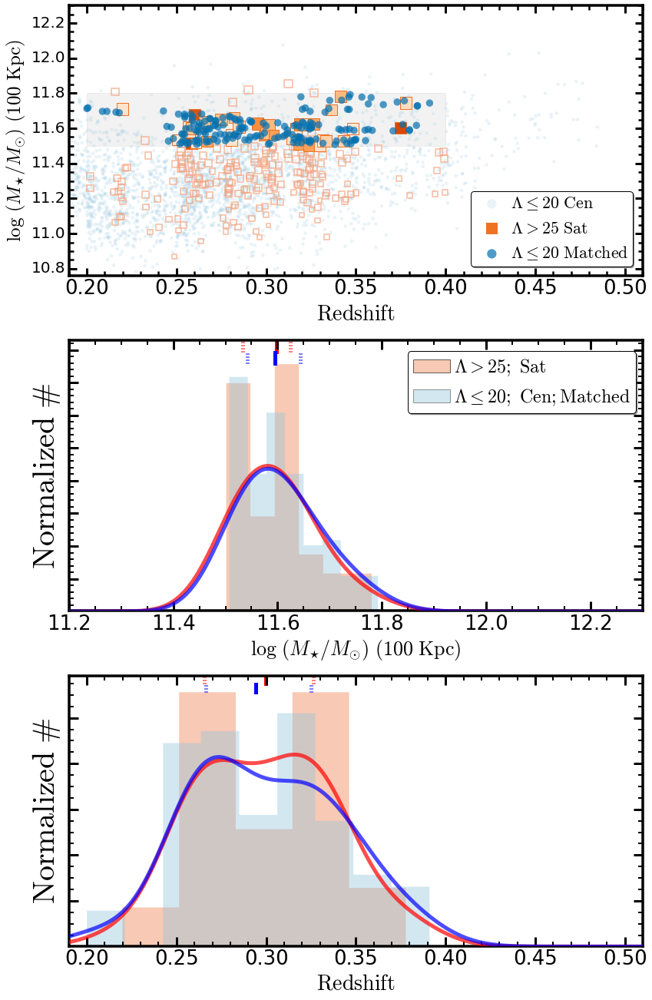

In [506]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.2, 12.3
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## gama sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m100_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## mem sample
p2 = ax1.scatter(memClean['z_use'], memClean['m100_c'], 
                 facecolor='none', s=((memClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(memUse['z_use'], memUse['m100_c'], 
                 edgecolor=ORG4(0.8), s=((memUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(memUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Sat}$' % lamLimit, marker='s')

## Matched gama sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m100_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for mem 
memMKde = KernelDensity(0.06, kernel='gaussian')
memMKde.fit(memUse['m100_c'][:, None])
memMDens = np.exp(memMKde.score_samples(mx[:, None]))

## KDE for gama
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m100_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(memUse['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Sat}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m100_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, memMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### mem
ax2.plot([np.nanmedian(memUse['m100_c']), np.nanmedian(memUse['m100_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(memUse['m100_c'], 25), 
          np.percentile(memUse['m100_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(memUse['m100_c'], 75), 
          np.percentile(memUse['m100_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### gama
ax2.plot([np.nanmedian(gamaUnique['m100_c']), np.nanmedian(gamaUnique['m100_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m100_c'], 25), 
          np.percentile(gamaUnique['m100_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m100_c'], 75), 
          np.percentile(gamaUnique['m100_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for mem 
memMKde = KernelDensity(0.02, kernel='gaussian')
memMKde.fit(memUse['z_use'][:, None])
memMDens = np.exp(memMKde.score_samples(zx[:, None]))

## KDE for gama
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(memUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, memMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### mem
ax3.plot([np.nanmedian(memUse['z_use']), np.nanmedian(memUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(memUse['z_use'], 25), 
          np.percentile(memUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(memUse['z_use'], 75), 
          np.percentile(memUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### gama
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [507]:
# Organize the sample
prof_mem_ma = getStackProfiles(memUse, memDir, name='mem_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

memUse.write('mem_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_mem_ma, col1='muI1', 
                                            col2='LOGM2LI_C', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI_C', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_mem_ma, col1='muI3', 
                                                    col2='LOGM2LI_C', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI_C', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# mem M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_mem_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# mem M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_mem_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# mem M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_mem_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# mem M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_mem_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample mem_matchMem_m100_2 : Will deal with 37 galaxies

## Save mem_matchMem_m100_2 to /Users/songhuang/work/hscs/gama_massive/sbp/redmem/mem_matchMem_m100_2_profs.pkl
## Sample gama_matchMem_m100_2 : Will deal with 180 galaxies

## Save gama_matchMem_m100_2 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchMem_m100_2_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!
11.3334316128
11.3606773752


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:249: RuntimeWarning: invalid value encountered in subtract


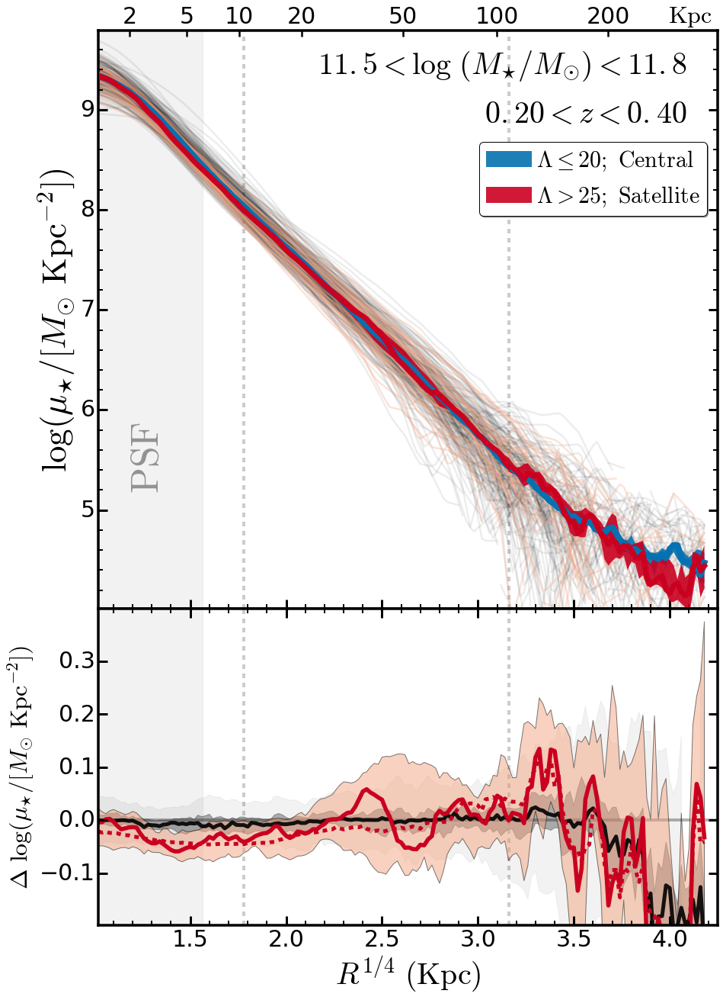

In [508]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Satellite}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

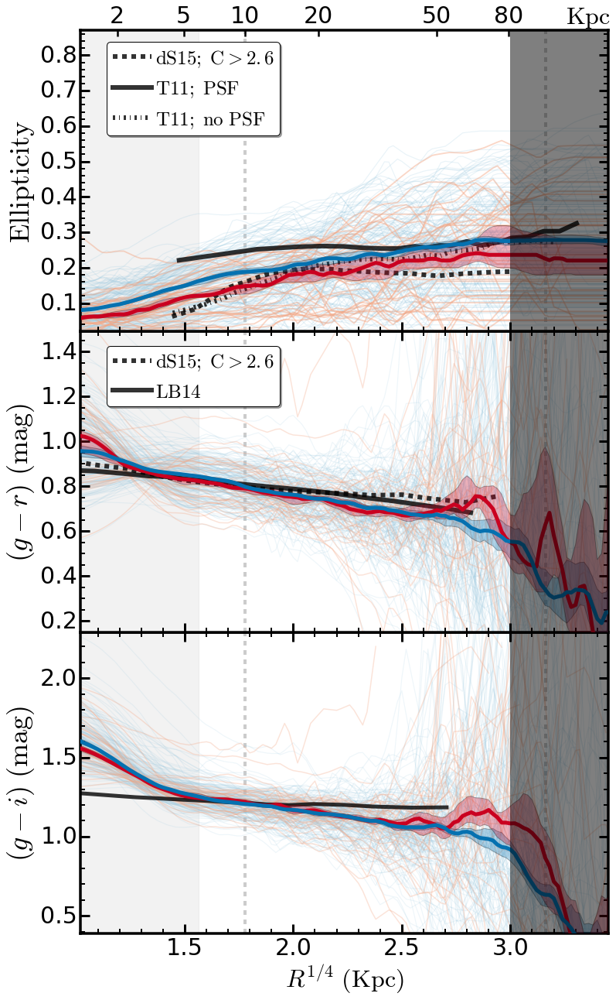

In [509]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

# Mem v.s Gama; M10

In [517]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchMem_m10_1'
mlim0, mlim1 = 11.50, 11.80
zlim0, zlim1 = 0.20, 0.40
lamLimit = 25
pcenLimit = 0.1

## mem sample used for matching
memUse = memClean[(memClean['m100_c'] >= mlim0) & 
                  (memClean['m100_c'] <= mlim1) & 
                  (memClean['z_use'] >= zlim0) &
                  (memClean['z_use'] <= zlim1) &
                  (memClean['LAMBDA_CLUSTER'] >= lamLimit) &
                  (memClean['P_CEN_1'] >= pcenLimit)]
print("# mem Sample Size: ", len(memUse))

## GAMA sample used for matching
gamaUse = gamaClean[(gamaClean['m100_c'] >= (mlim0 - 0.20)) & 
                    (gamaClean['m100_c'] <= (mlim1 + 0.20)) & 
                    (gamaClean['z_use'] >= (zlim0 - 0.02)) &
                    (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaUse))

## Isolate the parameters used for matching 
memZM1 = np.stack((np.asarray(memUse[memUse['m10_c'] <= 11.20]['m10_c']), 
                   np.asarray(memUse[memUse['m10_c'] <= 11.20]['m5_c']),
                   np.asarray(memUse[memUse['m10_c'] <= 11.20]['m15_c']),
                   np.asarray(memUse[memUse['m10_c'] <= 11.20]['z_use'])), axis=-1)
memZM2 = np.stack((np.asarray(memUse[memUse['m10_c'] > 11.20]['m10_c']), 
                   np.asarray(memUse[memUse['m10_c'] > 11.20]['m5_c']),
                   np.asarray(memUse[memUse['m10_c'] > 11.20]['m15_c']),
                   np.asarray(memUse[memUse['m10_c'] > 11.20]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['m10_c']),
                   np.asarray(gamaUse['m5_c']),
                   np.asarray(gamaUse['m15_c']),
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=6)  

dist, ind1 = gamaTree.query(memZM1, k=5) 
print("# Matched < 11.25", len(ind1.ravel()))
dist, ind2 = gamaTree.query(memZM2, k=5) 
print("# Matched > 11.25", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
#indAll = ind1.ravel()
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# mem Sample Size:  37
# GAMA Sample Size:  1405
# Matched < 11.25 30
# Matched > 11.25 155
# All and Unique Matched Sample 185 167


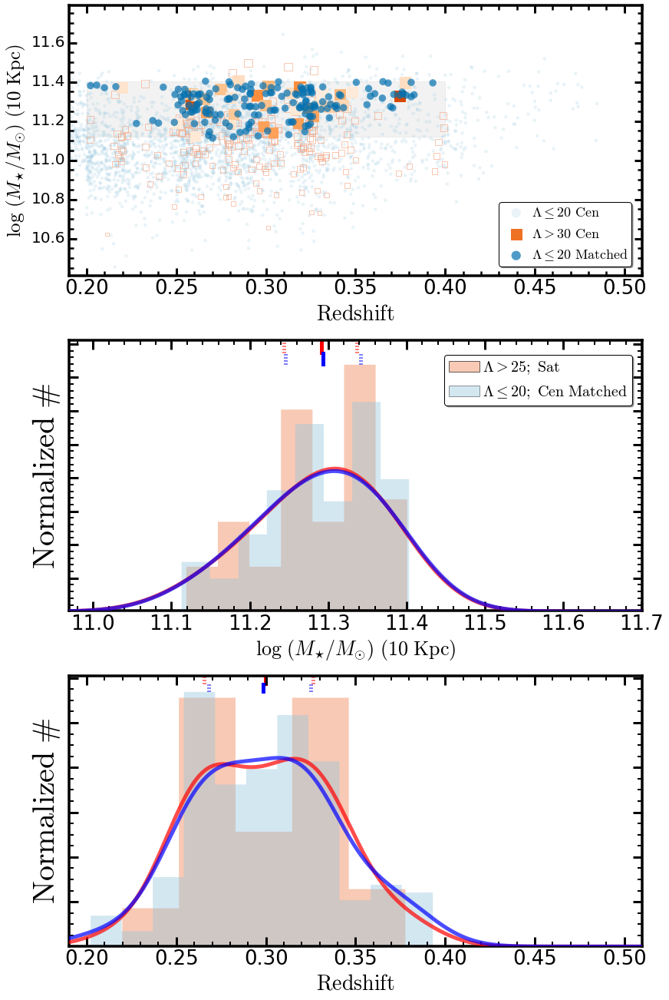

In [518]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 10.41, 11.79
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
m10_0, m10_1 = np.nanmin(memUse['m10_c']), np.nanmax(memUse['m10_c'])
ax1.fill_between([zlim0, zlim1], [m10_0, m10_0], [m10_1, m10_1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['m10_c'], 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## mem sample
p2 = ax1.scatter(memClean['z_use'], memClean['m10_c'], 
                 facecolor='none', s=((memClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s',
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(memUse['z_use'], memUse['m10_c'], 
                 edgecolor='none', s=((memUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(memUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 30\ \mathrm{Cen}$', marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['m10_c'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.75, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (10\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(mmin, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for mem 
memMKde = KernelDensity(0.06, kernel='gaussian')
memMKde.fit(memUse['m10_c'][:, None])
memMDens = np.exp(memMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['m10_c'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(memUse['m10_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Sat}$' % lamLimit)
bb, _, _ = hist(gamaUnique['m10_c'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen\ Matched}$')

## Density plot 
ax2.plot(mx, memMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(m10_0-0.15, m10_1+0.30)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.655, 0.76), shadow=True, fancybox=True, 
           numpoints=1, fontsize=20, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (\mathrm{10\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### mem
ax2.plot([np.nanmedian(memUse['m10_c']), np.nanmedian(memUse['m10_c'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(memUse['m10_c'], 25), 
          np.percentile(memUse['m10_c'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(memUse['m10_c'], 75), 
          np.percentile(memUse['m10_c'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['m10_c']), np.nanmedian(gamaUnique['m10_c'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['m10_c'], 25), 
          np.percentile(gamaUnique['m10_c'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['m10_c'], 75), 
          np.percentile(gamaUnique['m10_c'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for mem 
memMKde = KernelDensity(0.02, kernel='gaussian')
memMKde.fit(memUse['z_use'][:, None])
memMDens = np.exp(memMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(memUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, memMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### mem
ax3.plot([np.nanmedian(memUse['z_use']), np.nanmedian(memUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(memUse['z_use'], 25), 
          np.percentile(memUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(memUse['z_use'], 75), 
          np.percentile(memUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [519]:
# Organize the sample
prof_mem_ma = getStackProfiles(memUse, memDir, name='mem_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

memUse.write('mem_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_mem_ma, col1='muI1', 
                                            col2='LOGM2LI_C', kind='mass')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='LOGM2LI_C', kind='mass')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_mem_ma, col1='muI3', 
                                                    col2='LOGM2LI_C', kind='mass')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='LOGM2LI_C', kind='mass')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# mem M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_mem_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.8)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# mem M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_mem_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# mem M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_mem_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# mem M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_mem_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 4.0) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample mem_matchMem_m10_1 : Will deal with 37 galaxies

## Save mem_matchMem_m10_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redmem/mem_matchMem_m10_1_profs.pkl
## Sample gama_matchMem_m10_1 : Will deal with 167 galaxies

## Save gama_matchMem_m10_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchMem_m10_1_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!
11.3336126144
11.3221618545


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:249: RuntimeWarning: invalid value encountered in subtract


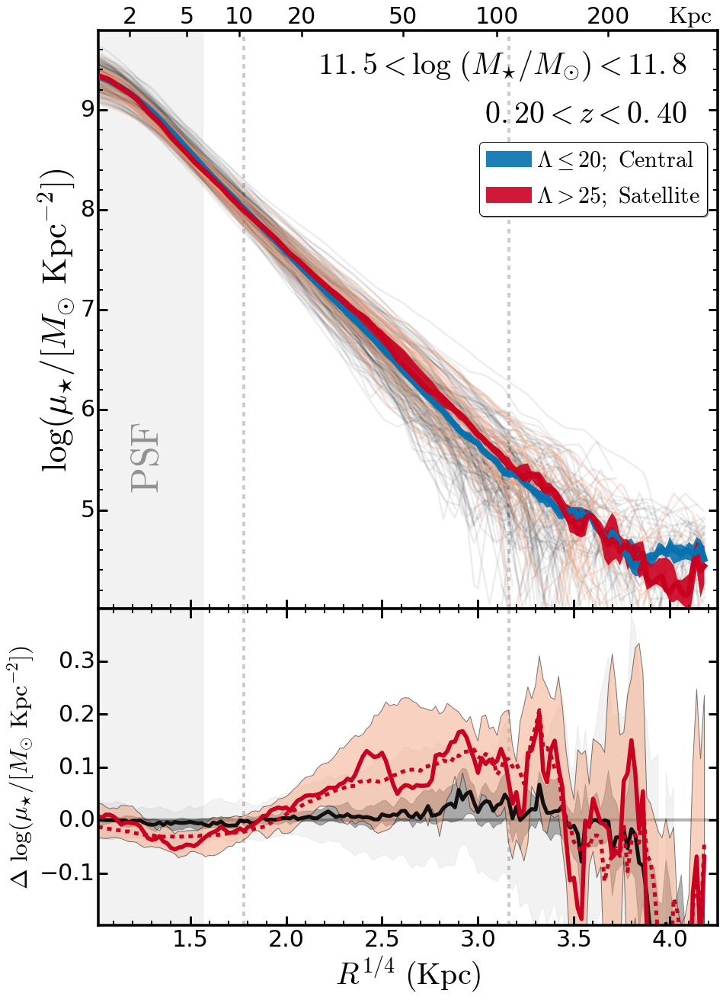

In [520]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Satellite}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (M_{\star}/M_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## mem-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[M_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

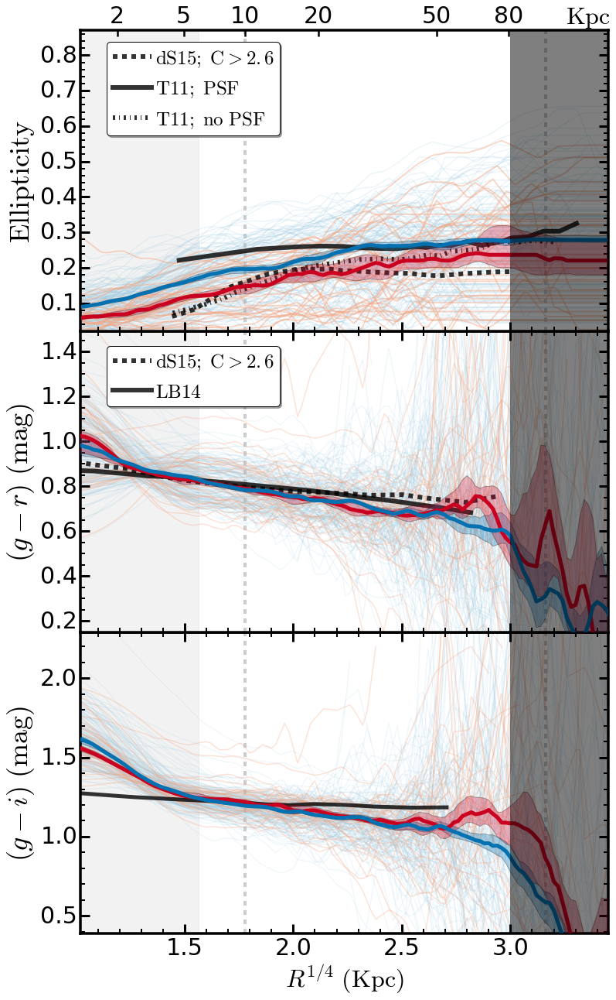

In [521]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(0.39, 2.29)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

# Mass Growth relative to M100

In [6]:
bcgM1 = Table.read('bcg_matchM1_m100_1_sample.fits', format='fits')
bcgM2 = Table.read('bcg_matchM2_m100_1_sample.fits', format='fits')

gamaM1 = Table.read('gama_matchM1_m100_1_sample.fits', format='fits')
gamaM2 = Table.read('gama_matchM2_m100_1_sample.fits', format='fits')

bcgAll = Table.read('bcg_matchAll_m100_1_sample.fits', format='fits')
gamaAll = Table.read('gama_matchAll_m100_1_sample.fits', format='fits')

#bcgUse = bcgClean[(bcgClean['z_use'] >= 0.20) &
#                  (bcgClean['z_use'] <= 0.45) &
#                  (bcgClean['LAMBDA_CLUSTER'] >= 20.0) &
#                  (bcgClean['P_CEN_1'] >= 0.8)]
#print("# BCG Sample Size: ", len(bcgUse))

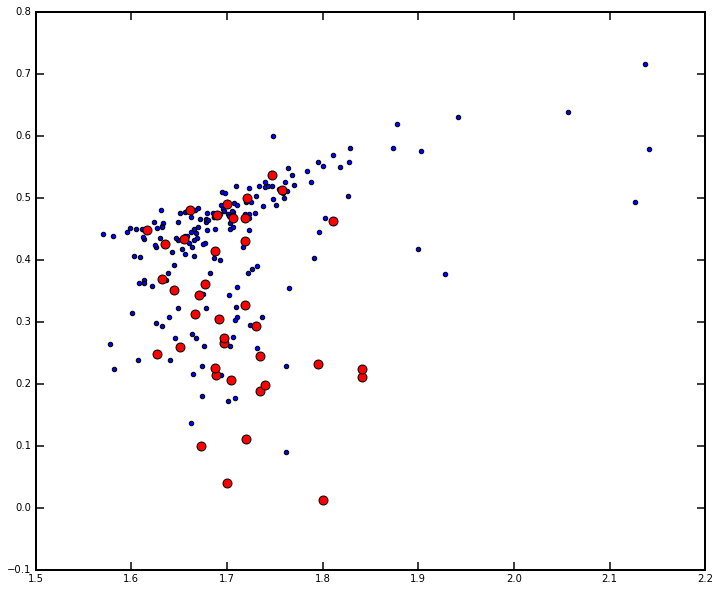

In [12]:
plt.scatter(gamaAll['gz_kA'], gamaAll['logm2l_i'])
plt.scatter(bcgAll['gz_kA'], bcgAll['logm2l_i'], c='r', s=80)

plt.show()

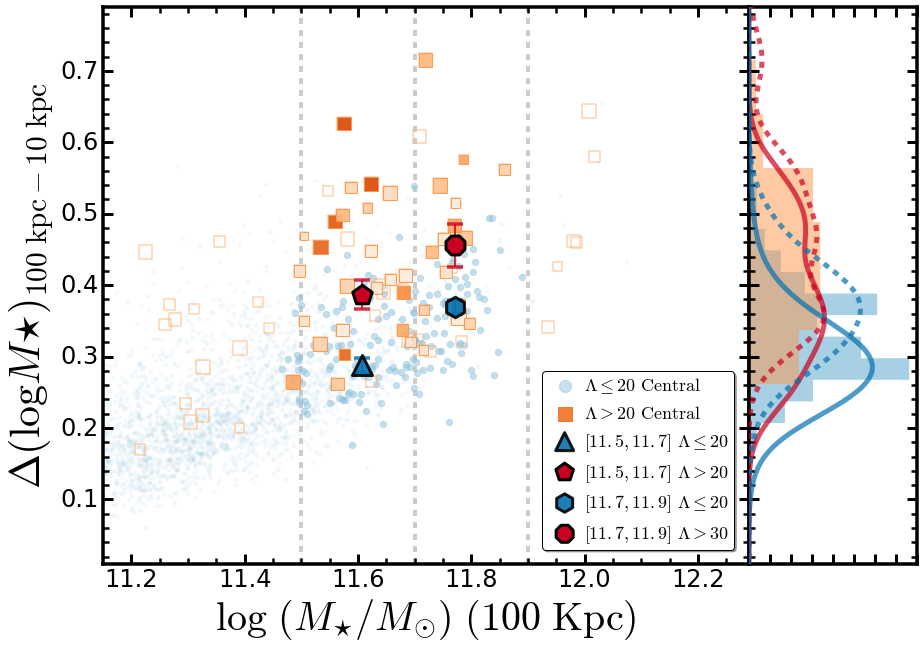

In [528]:
gM1_x = confidence_interval(gamaM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval((gamaM1['lum_100'] - gamaM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval((bcgM1['lum_100'] - bcgM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval((gamaM2['lum_100'] - gamaM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval((bcgM2['lum_100'] - bcgM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)


fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_c'], 
                 gamaClean['lum_100'] - gamaClean['lum_10'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_c'], 
                 gamaAll['lum_100'] - gamaAll['lum_10'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_c'], 
                 bcgUse['lum_100'] - bcgUse['lum_10'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_c'], 
                 bcgAll['lum_100'] - bcgAll['lum_10'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$', 
               size=42)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(0.01, 0.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 1.0, 200)

gamaY1 = gamaAll['lum_100'] - gamaAll['lum_10']
bcgY1 = bcgAll['lum_100'] - bcgAll['lum_10']

gamaY2 = gamaM1['lum_100'] - gamaM1['lum_10']
bcgY2 = bcgM1['lum_100'] - bcgM1['lum_10']

gamaY3 = gamaM2['lum_100'] - gamaM2['lum_10']
bcgY3 = bcgM2['lum_100'] - bcgM2['lum_10']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_dm100-10.png', dpi=300)

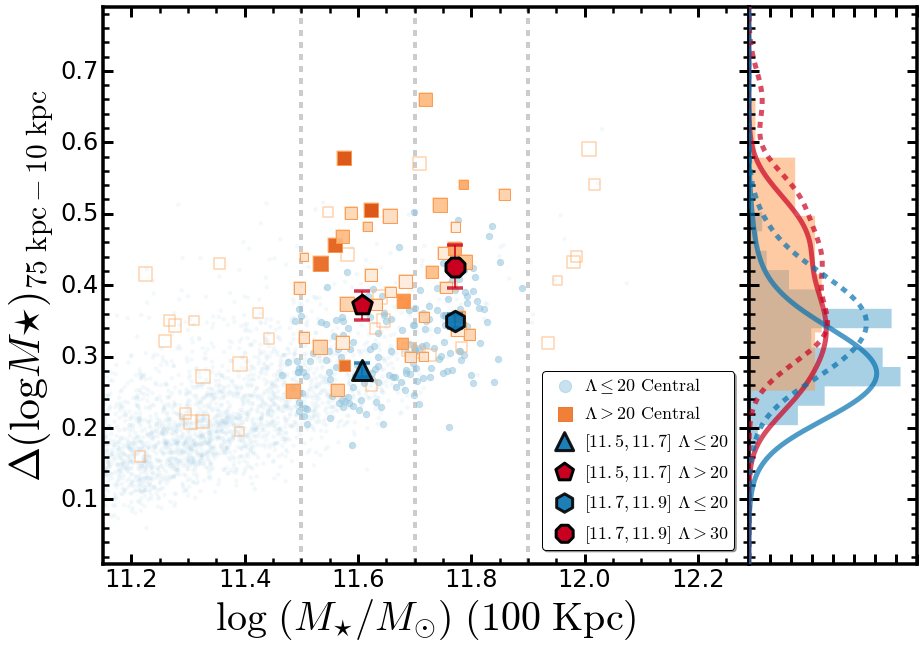

In [481]:
gM1_x = confidence_interval(gamaM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval((gamaM1['lum_75'] - gamaM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval((bcgM1['lum_75'] - bcgM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval((gamaM2['lum_75'] - gamaM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval((bcgM2['lum_75'] - bcgM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)


fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_c'], 
                 gamaClean['lum_75'] - gamaClean['lum_10'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_c'], 
                 gamaAll['lum_75'] - gamaAll['lum_10'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_c'], 
                 bcgUse['lum_75'] - bcgUse['lum_10'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_c'], 
                 bcgAll['lum_75'] - bcgAll['lum_10'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\Delta(\log M{\star})_{\mathrm{75\ kpc}-\mathrm{10\ kpc}}$', 
               size=42)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(0.01, 0.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 1.0, 200)

gamaY1 = gamaAll['lum_75'] - gamaAll['lum_10']
bcgY1 = bcgAll['lum_75'] - bcgAll['lum_10']

gamaY2 = gamaM1['lum_75'] - gamaM1['lum_10']
bcgY2 = bcgM1['lum_75'] - bcgM1['lum_10']

gamaY3 = gamaM2['lum_75'] - gamaM2['lum_10']
bcgY3 = bcgM2['lum_75'] - bcgM2['lum_10']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_dm75-10.png', dpi=300)

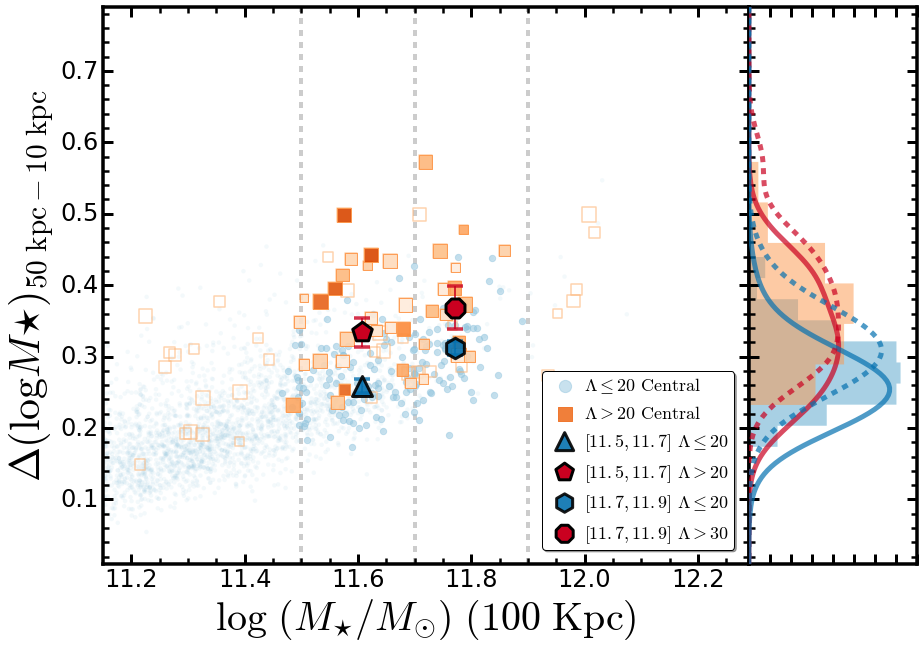

In [482]:
gM1_x = confidence_interval(gamaM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval((gamaM1['lum_50'] - gamaM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval((bcgM1['lum_50'] - bcgM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval((gamaM2['lum_50'] - gamaM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval((bcgM2['lum_50'] - bcgM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)


fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_c'], 
                 gamaClean['lum_50'] - gamaClean['lum_10'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_c'], 
                 gamaAll['lum_50'] - gamaAll['lum_10'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_c'], 
                 bcgUse['lum_50'] - bcgUse['lum_10'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_c'], 
                 bcgAll['lum_50'] - bcgAll['lum_10'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\Delta(\log M{\star})_{\mathrm{50\ kpc}-\mathrm{10\ kpc}}$', 
               size=42)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(0.01, 0.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 1.0, 200)

gamaY1 = gamaAll['lum_50'] - gamaAll['lum_10']
bcgY1 = bcgAll['lum_50'] - bcgAll['lum_10']

gamaY2 = gamaM1['lum_50'] - gamaM1['lum_10']
bcgY2 = bcgM1['lum_50'] - bcgM1['lum_10']

gamaY3 = gamaM2['lum_50'] - gamaM2['lum_10']
bcgY3 = bcgM2['lum_50'] - bcgM2['lum_10']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_dm50-10.png', dpi=300)

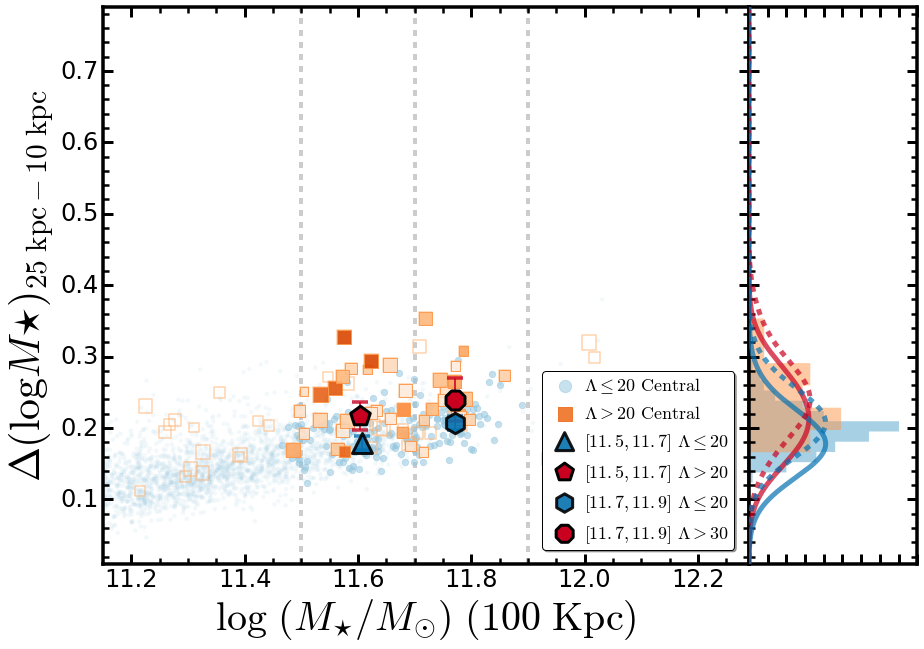

In [483]:
gM1_x = confidence_interval(gamaM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval((gamaM1['lum_25'] - gamaM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval((bcgM1['lum_25'] - bcgM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval((gamaM2['lum_25'] - gamaM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval((bcgM2['lum_25'] - bcgM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)


fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_c'], 
                 gamaClean['lum_25'] - gamaClean['lum_10'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_c'], 
                 gamaAll['lum_25'] - gamaAll['lum_10'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_c'], 
                 bcgUse['lum_25'] - bcgUse['lum_10'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_c'], 
                 bcgAll['lum_25'] - bcgAll['lum_10'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\Delta(\log M{\star})_{\mathrm{25\ kpc}-\mathrm{10\ kpc}}$', 
               size=42)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(0.01, 0.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 1.0, 200)

gamaY1 = gamaAll['lum_25'] - gamaAll['lum_10']
bcgY1 = bcgAll['lum_25'] - bcgAll['lum_10']

gamaY2 = gamaM1['lum_25'] - gamaM1['lum_10']
bcgY2 = bcgM1['lum_25'] - bcgM1['lum_10']

gamaY3 = gamaM2['lum_25'] - gamaM2['lum_10']
bcgY3 = bcgM2['lum_25'] - bcgM2['lum_10']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_dm25-10.png', dpi=300)

# Mass Growth Relative to M10

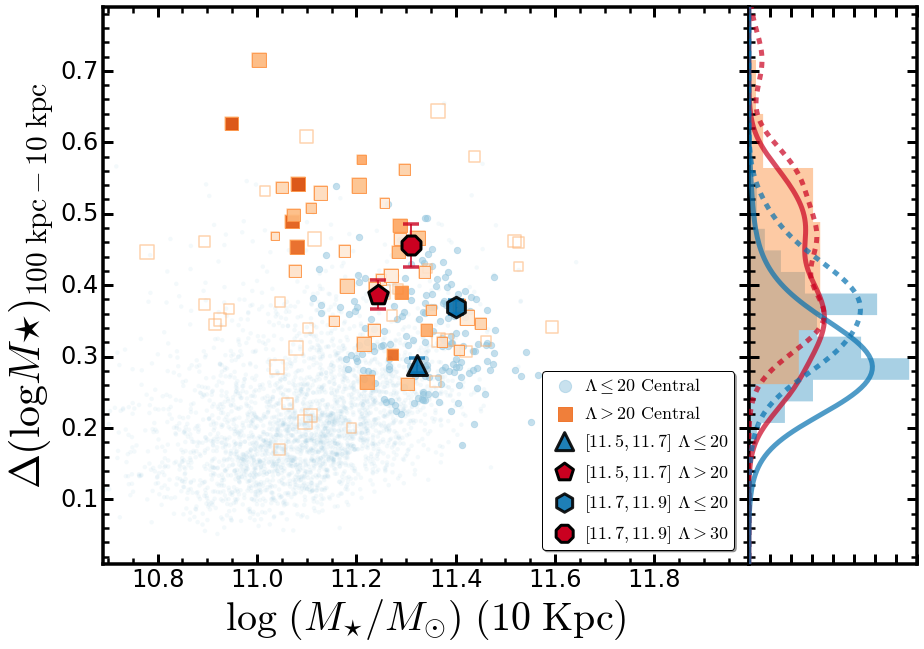

In [484]:
gM1_x = confidence_interval(gamaM1['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval((gamaM1['lum_100'] - gamaM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval((bcgM1['lum_100'] - bcgM1['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval((gamaM2['lum_100'] - gamaM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                               metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval((bcgM2['lum_100'] - bcgM2['lum_10']), 
                                axis=0, alpha=[SIGMA1, 1.0], 
                                metric=np.median, numResamples=1000, interpolate=True)


fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

#ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
#ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
#ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m10_c'], 
                 gamaClean['lum_100'] - gamaClean['lum_10'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m10_c'], 
                 gamaAll['lum_100'] - gamaAll['lum_10'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m10_c'], 
                 bcgUse['lum_100'] - bcgUse['lum_10'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m10_c'], 
                 bcgAll['lum_100'] - bcgAll['lum_10'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (10\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\Delta(\log M{\star})_{\mathrm{100\ kpc}-\mathrm{10\ kpc}}$', 
               size=42)

# Axis limits
ax1.set_xlim(10.69, 11.99)
ax1.set_ylim(0.01, 0.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 1.0, 200)

gamaY1 = gamaAll['lum_100'] - gamaAll['lum_10']
bcgY1 = bcgAll['lum_100'] - bcgAll['lum_10']

gamaY2 = gamaM1['lum_100'] - gamaM1['lum_10']
bcgY2 = bcgM1['lum_100'] - bcgM1['lum_10']

gamaY3 = gamaM2['lum_100'] - gamaM2['lum_10']
bcgY3 = bcgM2['lum_100'] - bcgM2['lum_10']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m10_dm100-10.png', dpi=300)

# Relation between M100 and M5

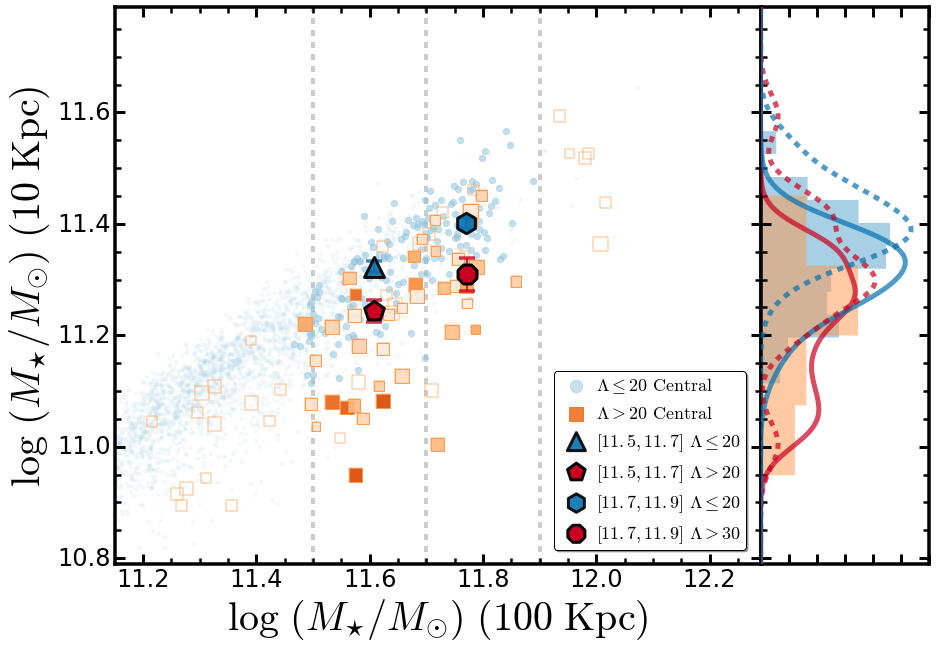

In [530]:
gM1_x = confidence_interval(gamaM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(gamaM1['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(bcgM1['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(gamaM2['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(bcgM2['m10_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_c'], 
                 gamaClean['m10_c'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_c'], 
                 gamaAll['m10_c'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_c'], 
                 bcgUse['m10_c'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_c'], 
                 bcgAll['m10_c'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (10\ \mathrm{Kpc})$', size=40)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(10.79, 11.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(10.5, 12.0, 300)

gamaY1 = gamaAll['m10_c']
bcgY1 = bcgAll['m10_c']

gamaY2 = gamaM1['m10_c']
bcgY2 = bcgM1['m10_c']

gamaY3 = gamaM2['m10_c']
bcgY3 = bcgM2['m10_c']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_m10.png', dpi=300)

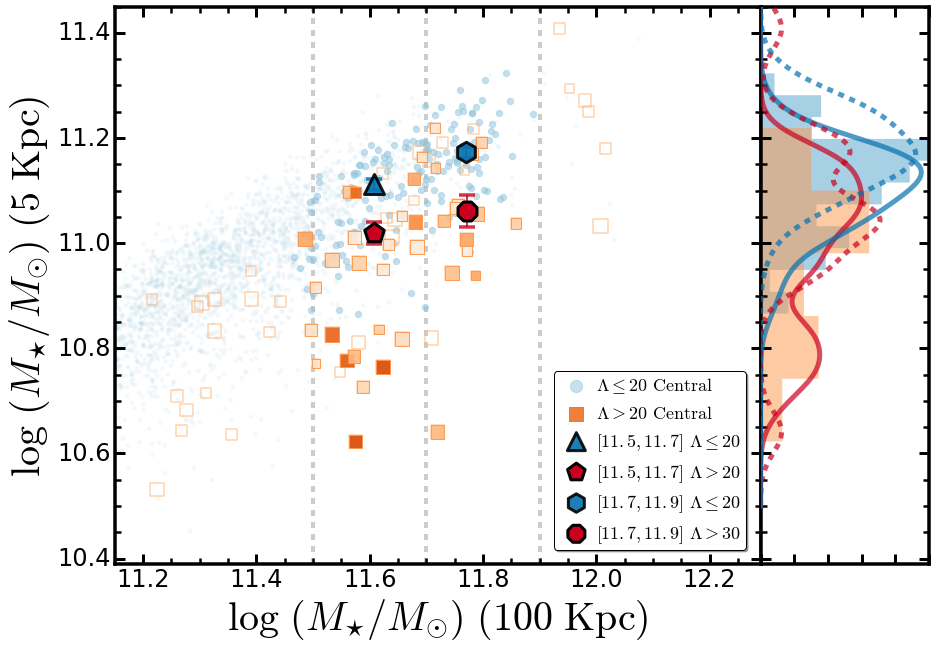

In [534]:
gM1_x = confidence_interval(gamaM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(gamaM1['m5_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(bcgM1['m5_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(gamaM2['m5_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(bcgM2['m5_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_c'], 
                 gamaClean['m5_c'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_c'], 
                 gamaAll['m5_c'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_c'], 
                 bcgUse['m5_c'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_c'], 
                 bcgAll['m5_c'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (5\ \mathrm{Kpc})$', size=40)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(10.39, 11.45)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(10.5, 12.0, 300)

gamaY1 = gamaAll['m5_c']
bcgY1 = bcgAll['m5_c']

gamaY2 = gamaM1['m5_c']
bcgY2 = bcgM1['m5_c']

gamaY3 = gamaM2['m5_c']
bcgY3 = bcgM2['m5_c']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_m5.png', dpi=300)

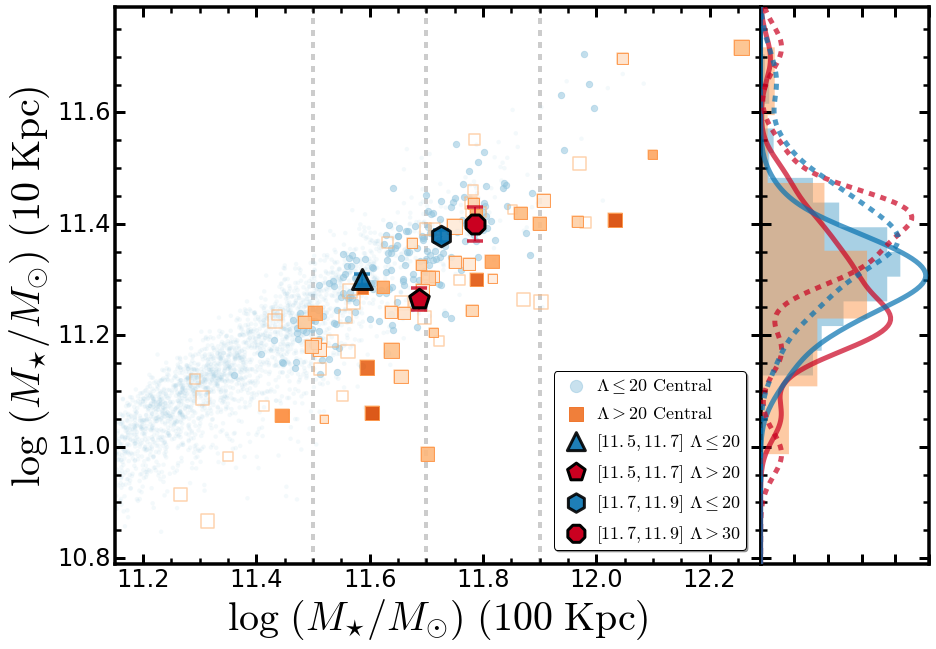

In [537]:
gM1_x = confidence_interval(gamaM1['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(gamaM1['m10_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(bcgM1['m10_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(gamaM2['m10_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(bcgM2['m10_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_a'], 
                 gamaClean['m10_a'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_a'], 
                 gamaAll['m10_a'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_a'], 
                 bcgUse['m10_a'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_a'], 
                 bcgAll['m10_a'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\log\ (M_{\star}/M_{\odot})\ (10\ \mathrm{Kpc})$', size=40)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(10.79, 11.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(10.5, 12.0, 300)

gamaY1 = gamaAll['m10_a']
bcgY1 = bcgAll['m10_a']

gamaY2 = gamaM1['m10_a']
bcgY2 = bcgM1['m10_a']

gamaY3 = gamaM2['m10_a']
bcgY3 = bcgM2['m10_a']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_m10_a.png', dpi=300)

# Mass-Size Relation

In [548]:
hc13_mr = Table.read('huertas-company13_mass_size.txt', format='ascii')
hc13_mr.colnames

['x', 'y', 'low', 'upp']

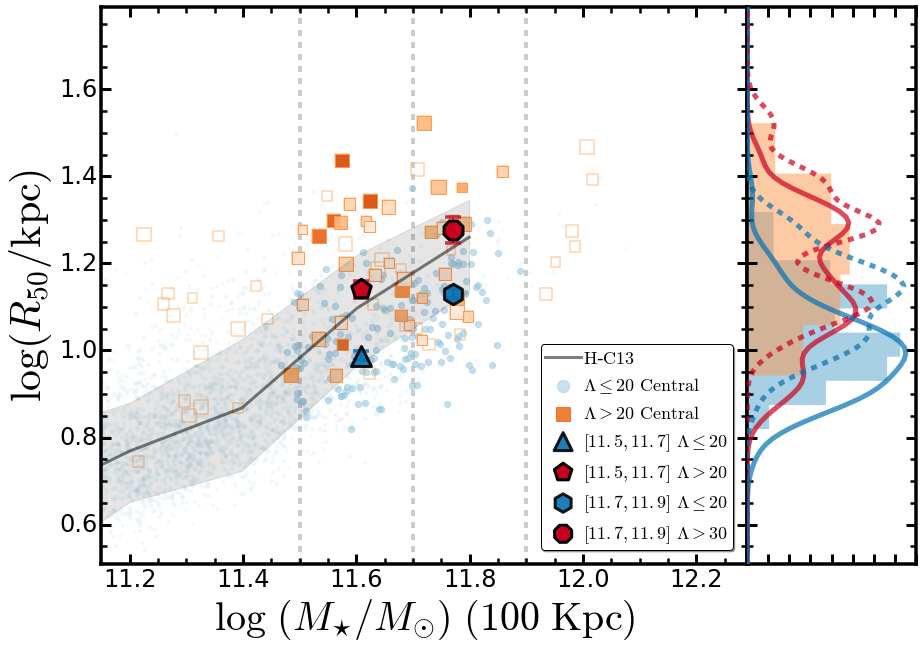

In [555]:
gM1_x = confidence_interval(gamaM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(np.log10(gamaM1['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(np.log10(bcgM1['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(np.log10(gamaM2['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_c'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(np.log10(bcgM2['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_c'], 
                 np.log10(gamaClean['r50_120']), s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_c'], 
                 np.log10(gamaAll['r50_120']), s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_c'], 
                 np.log10(bcgUse['r50_120']), edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_c'], 
                 np.log10(bcgAll['r50_120']), edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')
# H-C 13
ax1.fill_between(hc13_mr['x'], (hc13_mr['y'] + hc13_mr['low']), 
                 (hc13_mr['y'] + hc13_mr['upp']), facecolor='k', 
                 alpha=0.1, label=None)
ax1.plot(hc13_mr['x'], hc13_mr['y'], c='k', linewidth='3.0', alpha=0.5, 
         label='$\mathrm{H}$-$\mathrm{C13}$')

# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[2].set_color(ORG4(0.8))
legend.legendHandles[1].set_sizes([150])
legend.legendHandles[2].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\log (R_{50}/\mathrm{kpc})$', size=42)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(0.51, 1.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 2.6, 200)

gamaY1 = np.log10(gamaAll['r50_120'])
bcgY1 = np.log10(bcgAll['r50_120'])

gamaY2 = np.log10(gamaM1['r50_120'])
bcgY2 = np.log10(bcgM1['r50_120'])

gamaY3 = np.log10(gamaM2['r50_120'])
bcgY3 = np.log10(bcgM2['r50_120'])

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_logr50_c.png', dpi=300)

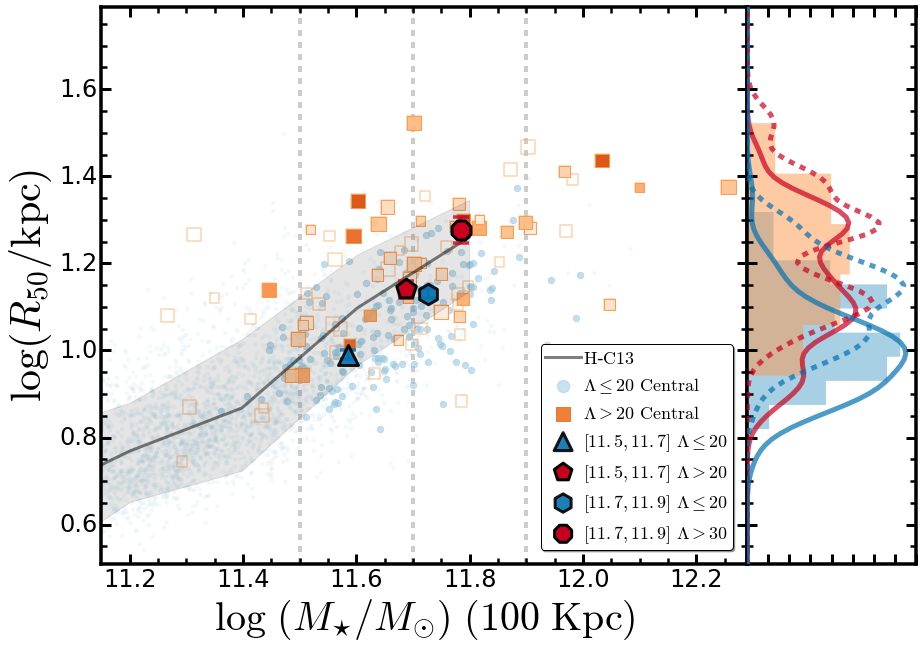

In [560]:
gM1_x = confidence_interval(gamaM1['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(np.log10(gamaM1['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(np.log10(bcgM1['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(np.log10(gamaM2['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_a'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(np.log10(bcgM2['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_a'], 
                 np.log10(gamaClean['r50_120']), s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_a'], 
                 np.log10(gamaAll['r50_120']), s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_a'], 
                 np.log10(bcgUse['r50_120']), edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_a'], 
                 np.log10(bcgAll['r50_120']), edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')

# H-C 13
ax1.fill_between(hc13_mr['x'], (hc13_mr['y'] + hc13_mr['low']), 
                 (hc13_mr['y'] + hc13_mr['upp']), facecolor='k', 
                 alpha=0.1, label=None)
ax1.plot(hc13_mr['x'], hc13_mr['y'], c='k', linewidth='3.0', alpha=0.5, 
         label='$\mathrm{H}$-$\mathrm{C13}$')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[2].set_color(ORG4(0.8))
legend.legendHandles[1].set_sizes([150])
legend.legendHandles[2].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\log (R_{50}/\mathrm{kpc})$', size=42)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(0.51, 1.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 2.6, 200)

gamaY1 = np.log10(gamaAll['r50_120'])
bcgY1 = np.log10(bcgAll['r50_120'])

gamaY2 = np.log10(gamaM1['r50_120'])
bcgY2 = np.log10(bcgM1['r50_120'])

gamaY3 = np.log10(gamaM2['r50_120'])
bcgY3 = np.log10(bcgM2['r50_120'])

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_logr50_a.png', dpi=300)

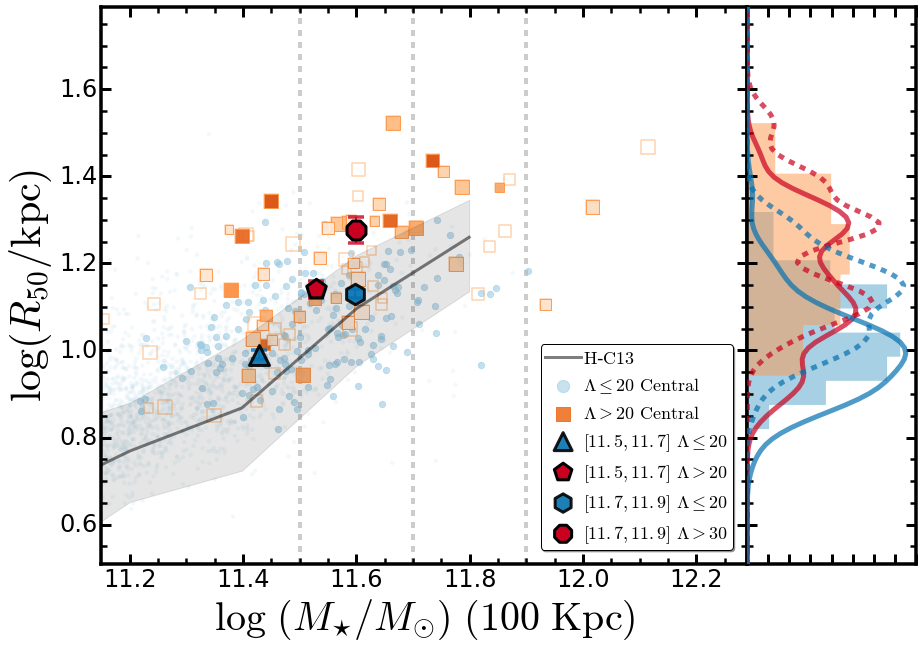

In [561]:
gM1_x = confidence_interval(gamaM1['m100_b'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(np.log10(gamaM1['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['m100_b'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(np.log10(bcgM1['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['m100_b'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(np.log10(gamaM2['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['m100_b'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(np.log10(bcgM2['r50_120']), 
                            axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.9, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['m100_b'], 
                 np.log10(gamaClean['r50_120']), s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['m100_b'], 
                 np.log10(gamaAll['r50_120']), s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['m100_b'], 
                 np.log10(bcgUse['r50_120']), edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['m100_b'], 
                 np.log10(bcgAll['r50_120']), edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')

# H-C 13
ax1.fill_between(hc13_mr['x'], (hc13_mr['y'] + hc13_mr['low']), 
                 (hc13_mr['y'] + hc13_mr['upp']), facecolor='k', 
                 alpha=0.1, label=None)
ax1.plot(hc13_mr['x'], hc13_mr['y'], c='k', linewidth='3.0', alpha=0.5, 
         label='$\mathrm{H}$-$\mathrm{C13}$')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')

# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[2].set_color(ORG4(0.8))
legend.legendHandles[1].set_sizes([150])
legend.legendHandles[2].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (M_{\star}/M_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\log (R_{50}/\mathrm{kpc})$', size=42)

# Axis limits
ax1.set_xlim(11.15, 12.29)
ax1.set_ylim(0.51, 1.79)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 2.6, 200)

gamaY1 = np.log10(gamaAll['r50_120'])
bcgY1 = np.log10(bcgAll['r50_120'])

gamaY2 = np.log10(gamaM1['r50_120'])
bcgY2 = np.log10(bcgM1['r50_120'])

gamaY3 = np.log10(gamaM2['r50_120'])
bcgY3 = np.log10(bcgM2['r50_120'])

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_m100_logr50_b.png', dpi=300)

# Matched using Luminosity

In [110]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_lum100_3'
mlim0, mlim1 = 11.20, 11.50
zlim0, zlim1 = 0.20, 0.45
lamLimit = 25
pcenLimit = 0.8

## BCG sample used for matching
bcgTemp = bcgClean[(bcgClean['lum_100'] + (bcgClean['KCORRECT_c_I'] / 2.5) >= mlim0) & 
                   (bcgClean['lum_100'] + (bcgClean['KCORRECT_c_I'] / 2.5) <= mlim1) & 
                   (bcgClean['z_use'] >= zlim0) &
                   (bcgClean['z_use'] <= zlim1) &
                   (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                   (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgTemp))

## GAMA sample used for matching
gamaTemp = gamaClean[(gamaClean['lum_100'] + (gamaClean['KCORRECT_c_I'] / 2.5) >= (mlim0 - 0.01)) & 
                     (gamaClean['lum_100'] + (gamaClean['KCORRECT_c_I'] / 2.5) <= (mlim1 + 0.08)) & 
                     (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                     (gamaClean['z_use'] <= (zlim1 + 0.02))]
print("# GAMA Sample Size: ", len(gamaTemp))

bcgUse = copy.deepcopy(bcgTemp)
gamaUse = copy.deepcopy(gamaTemp)

## 
bcgUse['lum_100'] = bcgUse['lum_100'] + (bcgUse['KCORRECT_c_I'] / 2.5)
gamaUse['lum_100'] = gamaUse['lum_100'] + (gamaUse['KCORRECT_c_I'] / 2.5)

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['lum_100'] <= 11.33]['lum_100']), 
                   np.asarray(bcgUse[bcgUse['lum_100'] <= 11.33]['gi_kA']),
                   np.asarray(bcgUse[bcgUse['lum_100'] <= 11.33]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['lum_100'] > 11.33]['lum_100']), 
                   np.asarray(bcgUse[bcgUse['lum_100'] > 11.33]['gi_kA']), 
                   np.asarray(bcgUse[bcgUse['lum_100'] > 11.33]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['lum_100']), 
                   np.asarray(gamaUse['gi_kA']), 
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=5)  

dist, ind1 = gamaTree.query(bcgZM1, k=7) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=7) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  45
# GAMA Sample Size:  386
# Matched < 11.65 189
# Matched > 11.65 126
# All and Unique Matched Sample 315 185


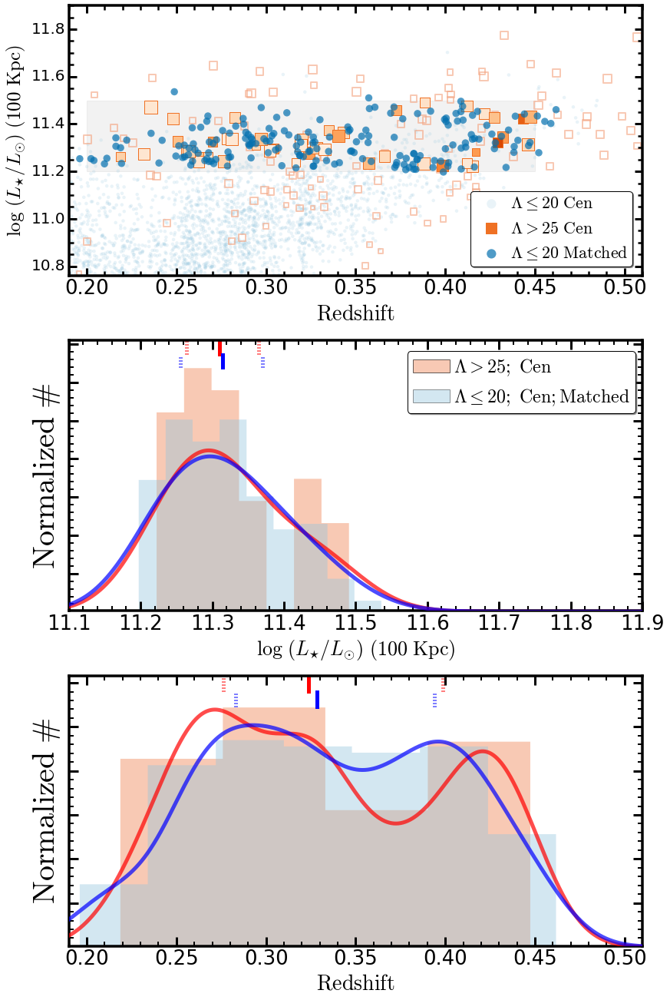

In [111]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 11.1, 11.9
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['lum_100'] + (gamaClean['KCORRECT_c_I'] / 2.5), 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['lum_100'] + (bcgClean['KCORRECT_c_I'] / 2.5), 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['lum_100'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['lum_100'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (L_{\star}/L_{\odot})\ (100\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.76, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['lum_100'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['lum_100'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['lum_100'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['lum_100'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (L_{\star}/L_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['lum_100']), np.nanmedian(bcgUse['lum_100'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['lum_100'], 25), 
          np.percentile(bcgUse['lum_100'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['lum_100'], 75), 
          np.percentile(bcgUse['lum_100'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['lum_100']), 
          np.nanmedian(gamaUnique['lum_100'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['lum_100'], 25), 
          np.percentile(gamaUnique['lum_100'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['lum_100'], 75), 
          np.percentile(gamaUnique['lum_100'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [112]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='KCORRECT_c_I', kind='sbp')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='KCORRECT_c_I', kind='sbp')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='KCORRECT_c_I', kind='sbp')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='KCORRECT_c_I', kind='sbp')
# Random mix sample 
#mixM_sm = np.vstack([gu_sm, bm_sm])
mixM_sm = gu_sm
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.5)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.5)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 3.8) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_lum100_3 : Will deal with 45 galaxies

## Save bcg_matchAll_lum100_3 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_lum100_3_profs.pkl
## Sample gama_matchAll_lum100_3 : Will deal with 185 galaxies

## Save gama_matchAll_lum100_3 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_lum100_3_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!
11.0625523075
11.0626895167


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:249: RuntimeWarning: invalid value encountered in subtract


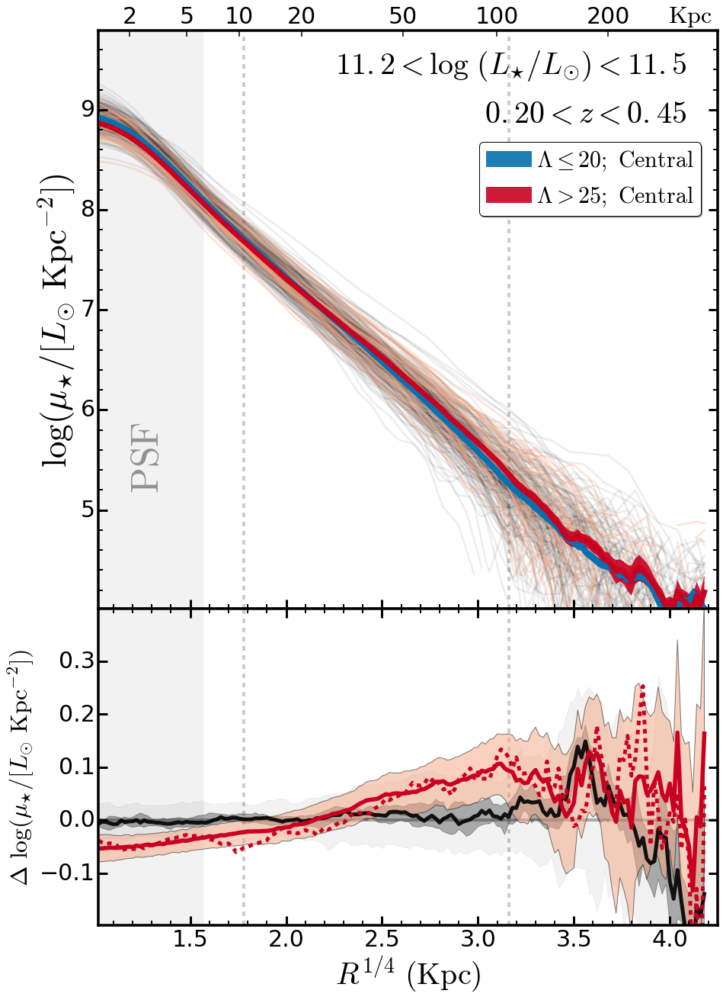

In [113]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_amg[0], gu_amg[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_amg[0], bm_amg[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_amg[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_amg[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[L_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (L_{\star}/L_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_amg[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_amg[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_amg[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_amg[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_amg[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_amg[1] - gu_amg[0]), (bm_amg[0] - gu_amg[1]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[L_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)

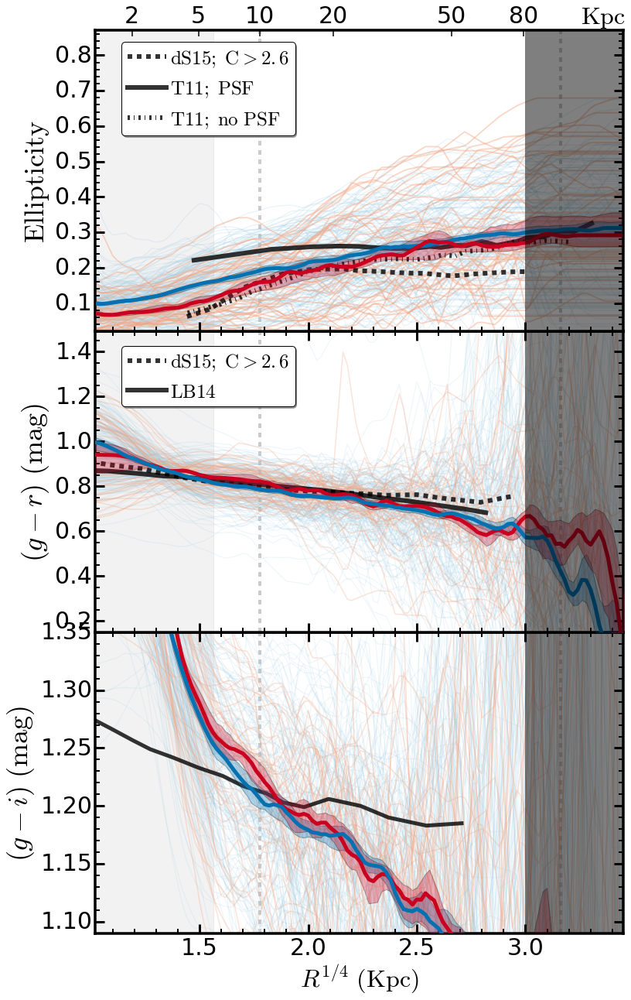

In [114]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig3 = plt.figure(figsize=(11, 18))
#fig = plt.figure(figsize=(12, 8))
#fig.subplots_adjust(left=0.1, right=0.95, bottom=0.15)

ax3 = plt.axes(EC1)
ax2 = plt.axes(EC2)
ax1 = plt.axes(EC3)

rsma0 = 1.02
rsma1 = 3.45

# --------------------------------------------------------------------------------------- #

ax1.minorticks_on()

ax1.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax1.fill_between([3.0, 4.5], [-0.1, -0.1], [1.1, 1.1], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for i, gg in enumerate(gm_se):
    if np.nanmax(gg[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], gg, c=BLUE0, alpha=0.20, linewidth=1.2)
    else:
        np.delete(gm_se, i)
        
for j, bb in enumerate(bm_se):
    if np.nanmax(bb[RSMA_COMMON[indEllip] <= 2.1]) <= 0.4:
        ax1.plot(RSMA_COMMON[indEllip], bb, c=RED0, alpha=0.45, linewidth=1.8)
    else:
        np.delete(bm_se, j)
        
gm_low = convolve(gm_me[0], Box1DKernel(5))    
gm_upp = convolve(gm_me[1], Box1DKernel(5)) 
gm_med = convolve(gm_me[2], Box1DKernel(3))

bm_low = convolve(bm_me[0], Box1DKernel(5))    
bm_upp = convolve(bm_me[1], Box1DKernel(5)) 
bm_med = convolve(bm_me[2], Box1DKernel(3))
        
ax1.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, edgecolor='k', alpha=0.3, zorder=1005)
ax1.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, edgecolor='k', alpha=0.3, zorder=1005)

ax1.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)


## Overplot other people's results 
ax1.plot(dsouza15_ell['col1'] ** 0.25, dsouza15_ell['col2'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax1.plot(tal11_ell_1['col1'] ** 0.25, tal11_ell_1['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ PSF}$')
ax1.plot(tal11_ell_2['col1'] ** 0.25, tal11_ell_2['col2'], linestyle='-.',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{T11;\ no\ PSF}$')

## Legend
ax1.legend(loc=(0.05, 0.65), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

# ax1.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax1.set_ylabel('$\mathrm{Ellipticity}$', size=36)

ax1.set_xlim(rsma0, rsma1)
ax1.set_ylim(0.02, 0.87)

for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)


########################################################################################
## Secondary Axis 
ax1b = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 80.0])
kpcTicks= (kpcs ** 0.25)
ax1b.set_xlim(rsma0, rsma1)
ax1b.set_ylim(0.02, 0.87)
ax1b.set_xticks(kpcTicks)
ax1b.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax1b.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1b.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax1b.transAxes)


########################################################################################
ax2.minorticks_on()

# 10 Kpc 
ax2.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax2.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax2.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax2.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggr in gm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], ggr, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgr in bm_sgr:
    ax2.plot(RSMA_COMMON[indEllip], bgr, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgr[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgr[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgr[2], Box1DKernel(3))

bm_low = convolve(bm_mgr[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgr[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgr[2], Box1DKernel(3))

ax2.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax2.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax2.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax2.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax2.plot(dsouza15_gr['x'] ** 0.25, dsouza15_gr['y'], linestyle='--',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{dS15;\ C}>2.6$')
ax2.plot((lababera14_gr['col1'] * 7.0) ** 0.25, lababera14_gr['col2'], linestyle='-',
         c='k', linewidth=6.0, alpha=0.8, label='$\mathrm{LB14}$')

## Legend
ax2.legend(loc=(0.05, 0.75), shadow=True, fancybox=True, 
           numpoints=1, fontsize=25, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

#ax2.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax2.set_ylabel('$(g-r)\ \mathrm{(mag)}$', size=36)

ax2.set_xlim(rsma0, rsma1)
ax2.set_ylim(0.15, 1.49)

for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
## Remove the X-axis label
ax2.xaxis.set_major_formatter(NullFormatter())
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')

ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

########################################################################################
ax3.minorticks_on()

# 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

# z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-5.0, -5.0], [5.0, 5.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between([3.0, 4.5], [-2.0, -2.0], [3.0, 3.0], 
                 facecolor='k', edgecolor='none', alpha=0.5, zorder=2000)

for ggi in gm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], ggi, c=BLUE0, alpha=0.15, linewidth=1.2)
for bgi in bm_sgi:
    ax3.plot(RSMA_COMMON[indEllip], bgi, c=RED0, alpha=0.30, linewidth=1.5)

gm_low = convolve(gm_mgi[0], Box1DKernel(3))    
gm_upp = convolve(gm_mgi[1], Box1DKernel(3)) 
gm_med = convolve(gm_mgi[2], Box1DKernel(3))

bm_low = convolve(bm_mgi[0], Box1DKernel(3))    
bm_upp = convolve(bm_mgi[1], Box1DKernel(3)) 
bm_med = convolve(bm_mgi[2], Box1DKernel(3))

ax3.fill_between(RSMA_COMMON[indEllip], gm_low, gm_upp, 
                 facecolor=BLUE1, alpha=0.3, zorder=1005)
ax3.fill_between(RSMA_COMMON[indEllip], bm_low, bm_upp, 
                 facecolor=RED1, alpha=0.3, zorder=1005)
                 
ax3.plot(RSMA_COMMON[indEllip], bm_med, linestyle='-', linewidth=5.0, 
         c=RED1, alpha=1.0, zorder=1010)
ax3.plot(RSMA_COMMON[indEllip], gm_med, linestyle='-', linewidth=5.0, 
         c=BLUE1, alpha=1.0, zorder=1010)

## Overplot other people's results 
ax3.plot((lababera14_gi['col1'] * 7.0) ** 0.25, lababera14_gi['col2'], linestyle='-',
         c='k', linewidth=5.0, alpha=0.8, label='$\mathrm{LB14}$')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=32)
ax3.set_ylabel('$(g-i)\ \mathrm{(mag)}$', size=36)

ax3.set_xlim(rsma0, rsma1)
ax3.set_ylim(1.09, 1.35)

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
    
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

#ax1.text(0.15, 0.88, '$11.5 < \log (M_{\star}) < 11.7$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=30.0, transform=ax1.transAxes)

plt.show()

fig3.savefig('../figure/hscMassive_' + sampleName + 'c.png', dpi=230)

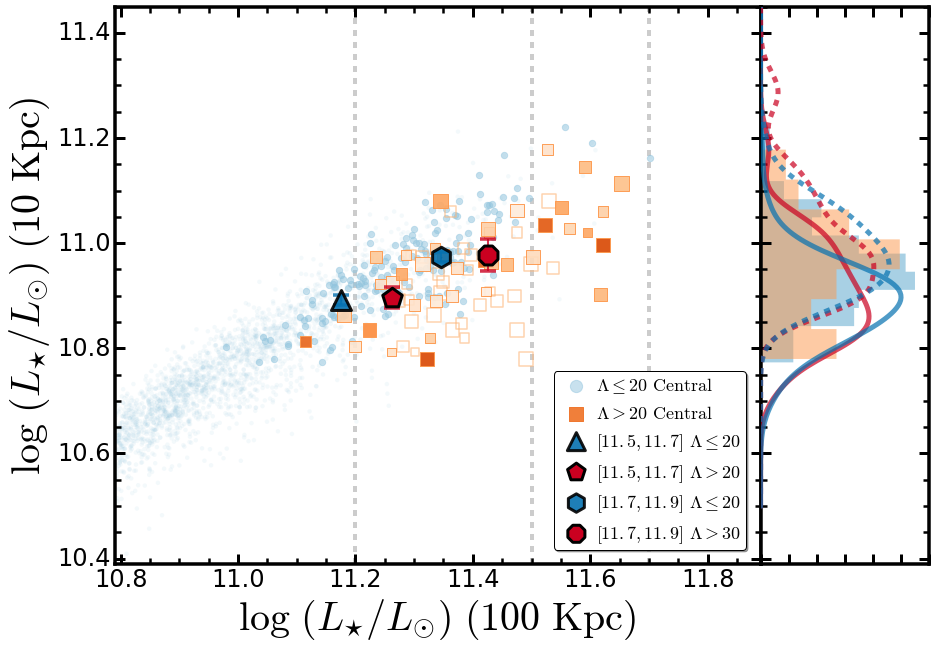

In [588]:
gM1_x = confidence_interval(gamaM1['lum_100'] + (gamaM1['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(gamaM1['lum_10'] + (gamaM1['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['lum_100'] + (bcgM1['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(bcgM1['lum_10'] + (bcgM1['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['lum_100'] + (gamaM2['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(gamaM2['lum_10'] + (gamaM2['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['lum_100'] + (bcgM2['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(bcgM2['lum_10'] + (bcgM2['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.2, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['lum_100'] + (gamaClean['KCORRECT_c_I']/2.5), 
                 gamaClean['lum_10'] + (gamaClean['KCORRECT_c_I']/2.5), s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['lum_100'] + (gamaAll['KCORRECT_c_I']/2.5), 
                 gamaAll['lum_10'] + (gamaAll['KCORRECT_c_I']/2.5), s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['lum_100'] + (bcgUse['KCORRECT_c_I']/2.5), 
                 bcgUse['lum_10'] + (bcgUse['KCORRECT_c_I']/2.5), edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['lum_100'] + (bcgAll['KCORRECT_c_I']/2.5), 
                 bcgAll['lum_10'] + (bcgAll['KCORRECT_c_I']/2.5), edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')


# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (L_{\star}/L_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
ax1.set_ylabel('$\log\ (L_{\star}/L_{\odot})\ (10\ \mathrm{Kpc})$', size=40)

# Axis limits
ax1.set_xlim(10.79, 11.89)
ax1.set_ylim(10.39, 11.45)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(10.5, 12.0, 300)

gamaY1 = gamaAll['lum_10'] + (gamaAll['KCORRECT_c_I']/2.5)
bcgY1 = bcgAll['lum_10'] + (bcgAll['KCORRECT_c_I']/2.5)

gamaY2 = gamaM1['lum_10'] + (gamaM1['KCORRECT_c_I']/2.5)
bcgY2 = bcgM1['lum_10'] + (bcgM1['KCORRECT_c_I']/2.5)

gamaY3 = gamaM2['lum_10'] + (gamaM2['KCORRECT_c_I']/2.5)
bcgY3 = bcgM2['lum_10'] + (bcgM2['KCORRECT_c_I']/2.5)

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

fig.savefig('../figure/hscMassive_lum100_lum10.png', dpi=300)

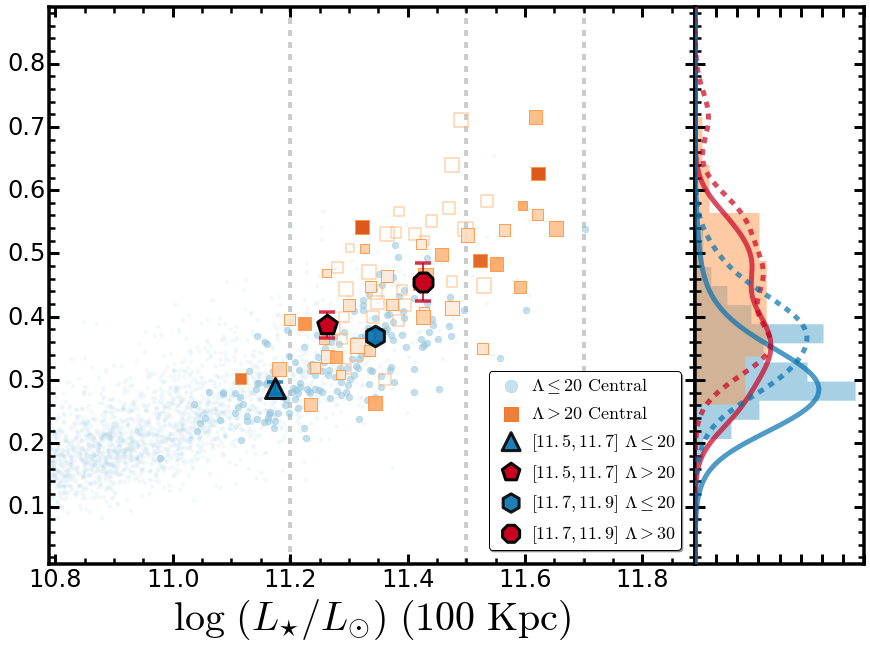

In [590]:
gM1_x = confidence_interval(gamaM1['lum_100'] + (gamaM1['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM1_y = confidence_interval(gamaM1['lum_100'] - gamaM1['lum_10'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM1_x = confidence_interval(bcgM1['lum_100'] + (bcgM1['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM1_y = confidence_interval(bcgM1['lum_100'] - bcgM1['lum_10'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

gM2_x = confidence_interval(gamaM2['lum_100'] + (gamaM2['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
gM2_y = confidence_interval(gamaM2['lum_100'] - gamaM2['lum_10'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

bM2_x = confidence_interval(bcgM2['lum_100'] + (bcgM2['KCORRECT_c_I']/2.5), axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)
bM2_y = confidence_interval(bcgM2['lum_100'] - bcgM2['lum_10'], axis=0, alpha=[SIGMA1, 1.0], 
                            metric=np.median, numResamples=1000, interpolate=True)

fig = plt.figure(figsize=(13, 9))
ax1 = plt.axes(recScat)
ax2 = plt.axes(recHist)

# SBP v.s. (cModel - SBP)
# ---------------------------------------------------------------------------
# Scatter plot
#ax1.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

ax1.axvline(11.2, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.5, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)
ax1.axvline(11.7, linewidth=4.0, linestyle='--', c='k', alpha=0.2, zorder=0)

# Matched ones 
p1 = ax1.scatter(gamaClean['lum_100'] + (gamaClean['KCORRECT_c_I']/2.5), 
                 gamaClean['lum_100'] - gamaClean['lum_10'], s=20.0, 
                 alpha=0.10, facecolor=BLUE0, edgecolor='none', 
                 label=None)

p2 = ax1.scatter(gamaAll['lum_100'] + (gamaAll['KCORRECT_c_I']/2.5), 
                 gamaAll['lum_100'] - gamaAll['lum_10'], s=40.0, 
                 alpha=0.50, facecolor=BLUE0, edgecolor=BLUE0, 
                 label='$\Lambda \leq 20\ \mathrm{Central}$')

p3 = ax1.scatter(bcgUse['lum_100'] + (bcgUse['KCORRECT_c_I']/2.5), 
                 bcgUse['lum_100'] - bcgUse['lum_10'], edgecolor=ORG4(0.4),
                 s=((bcgUse['z_use'] - 0.10) * 600.0), alpha=0.6, 
                 facecolor='none', label=None, marker='s', linewidth=1.5)

p4 = ax1.scatter(bcgAll['lum_100'] + (bcgAll['KCORRECT_c_I']/2.5), 
                 bcgAll['lum_100'] - bcgAll['lum_10'], edgecolor=ORG4(0.6),
                 s=((bcgAll['z_use'] - 0.10) * 600.0), cmap=ORG4, alpha=0.90, 
                 c=toColorArr(bcgAll['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > 20\ \mathrm{Central}$', marker='s')

# M1
ax1.errorbar(gM1_x[2], gM1_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, linewidth=4.0, fmt='h', elinewidth=2.0, label=None, 
             zorder=100)
ax1.errorbar(bM1_x[2], bM1_y[2], marker='+', ms=1, mec='k', linewidth=4.0,
             yerr=0.02, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM1_x[2], gM1_y[2], marker='^', s=400, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.5,11.7]}\ \Lambda \leq 20$')
ax1.scatter(bM1_x[2], bM1_y[2], marker='p', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.5,11.7]}\ \Lambda > 20$')


# M2
ax1.errorbar(gM2_x[2], gM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.01, color=BLUE1, ecolor=BLUE1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)
ax1.errorbar(bM2_x[2], bM2_y[2], marker='+', ms=1, mec='k',
             yerr=0.03, mfc=RED1, ecolor=RED1, capthick=3.5, capsize=8, 
             alpha=0.8, fmt='h', elinewidth=2.0, label=None, zorder=100)

ax1.scatter(gM2_x[2], gM2_y[2], marker='h', s=420, facecolor=BLUE1,
            edgecolor='k', linewidth=3.0, zorder=102, alpha=0.9,
            label='$\mathrm{[11.7,11.9]}\ \Lambda \leq 20$')
ax1.scatter(bM2_x[2], bM2_y[2], marker='8', s=420, facecolor=RED1,
            edgecolor='k', linewidth=3.0, zorder=102,
            label='$\mathrm{[11.7,11.9]}\ \Lambda > 30$')

# Legend
ax1.legend(loc=(0.68, 0.025), shadow=True, fancybox=True, 
           numpoints=1, fontsize=18, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)

legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])

#ax1.text(0.05, 0.04, '$\mathrm{Size:}\ {\Lambda}_{\mathrm{redMapper}}$', 
#         verticalalignment='bottom', horizontalalignment='left',
#         fontsize=26.0, transform=ax1.transAxes, color=RED0)

# Axes setup
#  Minor Ticks on 
ax1.minorticks_on()

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

# Label
ax1.set_xlabel('$\log\ (L_{\star}/L_{\odot})\ (100\ \mathrm{Kpc})$', size=40)
#ax1.set_ylabel('$\log\ (L_{\star}/L_{\odot})\ (10\ \mathrm{Kpc})$', size=40)

# Axis limits
ax1.set_xlim(10.79, 11.89)
ax1.set_ylim(0.01, 0.89)

# ---------------------------------------------------------------------------
# Histogram 
#

yy = np.linspace(0.0, 1.0, 300)

gamaY1 = gamaAll['lum_100'] - gamaAll['lum_10']
bcgY1 = bcgAll['lum_100'] - bcgAll['lum_10']

gamaY2 = gamaM1['lum_100'] - gamaM1['lum_10'] 
bcgY2 = bcgM1['lum_100'] - bcgM1['lum_10'] 

gamaY3 = gamaM2['lum_100'] - gamaM2['lum_10']
bcgY3 = bcgM2['lum_100'] - bcgM2['lum_10']

## KDE for BCG 
bcgMKde = KernelDensity(0.04, kernel='gaussian')

bcgMKde.fit(bcgY1[:, None])
bcgMDens1 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY2[:, None])
bcgMDens2 = np.exp(bcgMKde.score_samples(yy[:, None]))
bcgMKde.fit(bcgY3[:, None])
bcgMDens3 = np.exp(bcgMKde.score_samples(yy[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.04, kernel='gaussian')
gamaMKde.fit(gamaY1[:, None])
gamaMDens1 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY2[:, None])
gamaMDens2 = np.exp(gamaMKde.score_samples(yy[:, None]))
gamaMKde.fit(gamaY3[:, None])
gamaMDens3 = np.exp(gamaMKde.score_samples(yy[:, None]))

n, bins, patches = hist(gamaY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=BLUE0, alpha=0.80, normed=1)

n, bins, patches = hist(bcgY1, bins='knuth', ax=ax2, edgecolor='none',
                        orientation='horizontal', histtype='stepfilled', 
                        color=ORG4(0.6), alpha=0.50, normed=1, linewidth=4.0)

## Density plot 
#ax2.plot(bcgMDens1, yy, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
#ax2.plot(gamaMDens1, yy,  '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens2, yy, '-', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens2, yy,  '-', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

ax2.plot(bcgMDens3, yy, '--', color=RED1, zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(gamaMDens3, yy,  '--', color=BLUE1, zorder=3, linewidth=5.0, alpha=0.7)

# 
ax2.set_ylim(ax1.get_ylim())

ax2.axhline(0.0, linewidth=4.0, linestyle='-', c='k', alpha=0.2)

# Axes setup
# Minor Ticks on 
ax2.minorticks_on()
ax2.tick_params(axis='x', which='minor', bottom='off', top='off')

#  Axes Thickness
for axis in ['top','bottom','left','right']:
  ax2.spines[axis].set_linewidth(3.5)
#  Tick Label Size 
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(24) 
#  Tick Length and Width
ax2.tick_params('both', length=10, width=3.0, which='major')
ax2.tick_params('both', length=6, width=2.5, which='minor')

ax1.axhline(0.0, linewidth=4.5, linestyle='-', c='k', alpha=0.2)

ax2.yaxis.set_major_formatter(NullFormatter())
ax2.xaxis.set_major_formatter(NullFormatter())

plt.show()

#fig.savefig('../figure/hscMassive_m100_m10.png', dpi=300)

# Luminosity Match; Lum 10

In [55]:
# Sample Matching Using K-Dtree

## Mass and Redshift Limit 
sampleName = 'matchAll_lum10_1'
mlim0, mlim1 = 10.80, 11.10 
zlim0, zlim1 = 0.20, 0.45
lamLimit = 30
pcenLimit = 0.8

## BCG sample used for matching
bcgTemp = bcgClean[(bcgClean['lum_10'] + (bcgClean['KCORRECT_c_I'] / 2.5) >= mlim0) & 
                   (bcgClean['lum_10'] + (bcgClean['KCORRECT_c_I'] / 2.5) <= mlim1) & 
                   (bcgClean['z_use'] >= zlim0) &
                   (bcgClean['z_use'] <= zlim1) &
                   (bcgClean['LAMBDA_CLUSTER'] >= lamLimit) &
                   (bcgClean['P_CEN_1'] >= pcenLimit)]
print("# BCG Sample Size: ", len(bcgTemp))

## GAMA sample used for matching
gamaTemp = gamaClean[(gamaClean['lum_10'] + (gamaClean['KCORRECT_c_I'] / 2.5) >= (mlim0 - 0.01)) & 
                     (gamaClean['lum_10'] + (gamaClean['KCORRECT_c_I'] / 2.5) <= (mlim1 + 0.05)) & 
                     (gamaClean['z_use'] >= (zlim0 - 0.01)) &
                     (gamaClean['z_use'] <= (zlim1 + 0.01))]
print("# GAMA Sample Size: ", len(gamaTemp))

bcgUse = copy.deepcopy(bcgTemp)
gamaUse = copy.deepcopy(gamaTemp)

## 
bcgUse['lum_10'] = bcgUse['lum_10'] + (bcgUse['KCORRECT_c_I'] / 2.5)
gamaUse['lum_10'] = gamaUse['lum_10'] + (gamaUse['KCORRECT_c_I'] / 2.5)

## Isolate the parameters used for matching 
bcgZM1 = np.stack((np.asarray(bcgUse[bcgUse['lum_10'] <= 10.90]['lum_10']), 
                   np.asarray(bcgUse[bcgUse['lum_10'] <= 10.90]['lum_5']),
                   np.asarray(bcgUse[bcgUse['lum_10'] <= 10.90]['lum_15']),
                   np.asarray(bcgUse[bcgUse['lum_10'] <= 10.90]['gi_kA']),
                   np.asarray(bcgUse[bcgUse['lum_10'] <= 10.90]['z_use'])), axis=-1)
bcgZM2 = np.stack((np.asarray(bcgUse[bcgUse['lum_10'] > 10.90]['lum_10']), 
                   np.asarray(bcgUse[bcgUse['lum_10'] > 10.90]['lum_5']), 
                   np.asarray(bcgUse[bcgUse['lum_10'] > 10.90]['lum_15']),
                   np.asarray(bcgUse[bcgUse['lum_10'] > 10.90]['gi_kA']), 
                   np.asarray(bcgUse[bcgUse['lum_10'] > 10.90]['z_use'])), axis=-1)

gamaZM = np.stack((np.asarray(gamaUse['lum_10']), 
                   np.asarray(gamaUse['lum_5']),
                   np.asarray(gamaUse['lum_15']),
                   np.asarray(gamaUse['gi_kA']),
                   np.asarray(gamaUse['z_use'])), axis=-1)

## Build the Tree
gamaTree = KDTree(gamaZM, leaf_size=6)  

dist, ind1 = gamaTree.query(bcgZM1, k=6) 
print("# Matched < 11.65", len(ind1.ravel()))
dist, ind2 = gamaTree.query(bcgZM2, k=8) 
print("# Matched > 11.65", len(ind2.ravel()))

indAll = np.hstack([ind1.ravel(), ind2.ravel()])
indUni = np.unique(indAll)
print("# All and Unique Matched Sample", len(indAll), len(indUni))

gamaMatch = gamaUse[indAll]
gamaUnique = gamaUse[indUni]

# BCG Sample Size:  43
# GAMA Sample Size:  962
# Matched < 11.65 78
# Matched > 11.65 240
# All and Unique Matched Sample 318 220


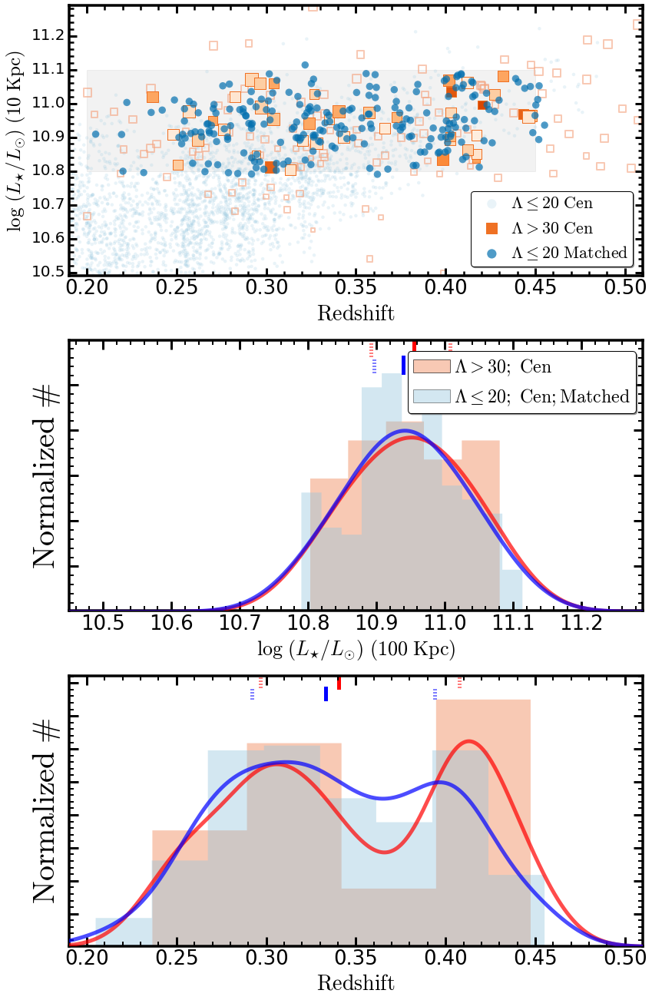

In [56]:
fig1 = plt.figure(figsize=(12, 18))
fig1.subplots_adjust(left=0.12, right=0.985, wspace=0.05,
                     bottom=0.05, top=0.995, hspace=0.24)

## Mass and Redshift limits
mmin, mmax = 10.45, 11.29
zmin, zmax = 0.19, 0.51

mx = np.linspace(mmin, mmax, 1000)
zx = np.linspace(zmin, zmax, 1000)

# ------------------------------------------------------------------------------------------------------#
# Redshift - Mass plot 
ax1 = fig1.add_subplot(311)

## Mass limits 
ax1.fill_between([zlim0, zlim1], [mlim0, mlim0], [mlim1, mlim1],
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## GAMA sample
p1 = ax1.scatter(gamaClean['z_use'], gamaClean['lum_10'] + (gamaClean['KCORRECT_c_I'] / 2.5), 
                 alpha=0.20, facecolor=BLUE0, edgecolor='none', 
                 label='$\Lambda \leq 20\ \mathrm{Cen}$')
## BCG sample
p2 = ax1.scatter(bcgClean['z_use'], bcgClean['lum_10'] + (bcgClean['KCORRECT_c_I'] / 2.5), 
                 facecolor='none', s=((bcgClean['m10_c'] - 10.40) * 100.0), 
                 cmap=ORG4, alpha=0.60, marker='s', linewidth=2.0,
                 edgecolor=RED0, label=None)

p3 = ax1.scatter(bcgUse['z_use'], bcgUse['lum_10'], 
                 edgecolor=ORG4(0.8), s=((bcgUse['m10_c'] - 10.40) * 250.0), 
                 cmap=ORG4, alpha=1.00, 
                 c=toColorArr(bcgUse['LAMBDA_CLUSTER'], bottom=20.0, top=70.0), 
                 label='$\Lambda > %d\ \mathrm{Cen}$' % lamLimit, marker='s')

## Matched GAMA sample
p4 = ax1.scatter(gamaUnique['z_use'], gamaUnique['lum_10'], 
                 alpha=0.70, facecolor=BLUE1, edgecolor='none', s=90,
                 label='$\Lambda \leq 20\ \mathrm{Matched}$')

## Legend
ax1.legend(loc=(0.70, 0.035), shadow=True, fancybox=True, 
           numpoints=1, fontsize=22, scatterpoints=1, 
           markerscale=0.9, borderpad=0.25, handletextpad=0.1)
legend = ax1.get_legend()
legend.legendHandles[1].set_color(ORG4(0.8))
legend.legendHandles[0].set_sizes([150])
legend.legendHandles[1].set_sizes([200])
legend.legendHandles[2].set_sizes([150])

## Axes setup
### Minor Ticks on 
ax1.minorticks_on()
### Axes Thickness
for axis in ['top','bottom','left','right']:
  ax1.spines[axis].set_linewidth(3.5)

##  Tick Label Size 
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
    
## Tick Length and Width
ax1.tick_params('both', length=10, width=3.0, which='major')
ax1.tick_params('both', length=6, width=2.5, which='minor')

## Label
ax1.set_xlabel('$\mathrm{Redshift}$', size=28)
ax1.set_ylabel('$\log\ (L_{\star}/L_{\odot})\ (10\ \mathrm{Kpc})$', 
               size=25)

## Axis limits
ax1.set_xlim(zmin, zmax)
ax1.set_ylim(10.49, mmax)

# ------------------------------------------------------------------------------------------------------#
# Mass Plot 
ax2 = fig1.add_subplot(312)

## KDE for BCG 
bcgMKde = KernelDensity(0.06, kernel='gaussian')
bcgMKde.fit(bcgUse['lum_10'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(mx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.06, kernel='gaussian')
gamaMKde.fit(gamaUnique['lum_10'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(mx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['lum_10'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6, label='$\Lambda > %d;\ \mathrm{Cen}$' % lamLimit)
bb, _, _ = hist(gamaUnique['lum_10'], bins='knuth', ax=ax2, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4, label='$\Lambda \leq 20;\ \mathrm{Cen;Matched}$')

## Density plot 
ax2.plot(mx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax2.plot(mx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax2.set_xlim(mmin, mmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax2.set_ylim(0.02, ylim)

## Legend
ax2.legend(loc=(0.590, 0.732), shadow=True, fancybox=True, 
           numpoints=1, fontsize=24, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## X, Y Lables
ax2.set_xlabel('$\log\ (L_{\star}/L_{\odot})\ (\mathrm{100\ Kpc})$', size=26)
ax2.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax2.plot([np.nanmedian(bcgUse['lum_10']), np.nanmedian(bcgUse['lum_10'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax2.plot([np.percentile(bcgUse['lum_10'], 25), 
          np.percentile(bcgUse['lum_10'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax2.plot([np.percentile(bcgUse['lum_10'], 75), 
          np.percentile(bcgUse['lum_10'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax2.plot([np.nanmedian(gamaUnique['lum_10']), 
          np.nanmedian(gamaUnique['lum_10'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax2.plot([np.percentile(gamaUnique['lum_10'], 25), 
          np.percentile(gamaUnique['lum_10'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax2.plot([np.percentile(gamaUnique['lum_10'], 75), 
          np.percentile(gamaUnique['lum_10'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax2.minorticks_on()
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax2.tick_params('both', length=12, width=3, which='major')
ax2.tick_params('both', length=6, width=2, which='minor')
ax2.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax2.spines['top'].set_linewidth(3.5)
ax2.spines['right'].set_linewidth(3.5)
ax2.spines['bottom'].set_linewidth(3.5)
ax2.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#
# Redshift Plot 
ax3 = fig1.add_subplot(313)

## KDE for BCG 
bcgMKde = KernelDensity(0.02, kernel='gaussian')
bcgMKde.fit(bcgUse['z_use'][:, None])
bcgMDens = np.exp(bcgMKde.score_samples(zx[:, None]))

## KDE for GAMA
gamaMKde = KernelDensity(0.02, kernel='gaussian')
gamaMKde.fit(gamaUnique['z_use'][:, None])
gamaMDens = np.exp(gamaMKde.score_samples(zx[:, None]))

## Histogram 
aa, _, _ = hist(bcgUse['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=RED0, 
                alpha=0.6)
bb, _, _ = hist(gamaUnique['z_use'], bins='knuth', ax=ax3, normed=True, zorder=1,
                histtype='stepfilled', edgecolor='none', facecolor=BLUE0, 
                alpha=0.4)

## Density plot 
ax3.plot(zx, bcgMDens, '-', color='r', zorder=3, linewidth=5.0, alpha=0.7)
ax3.plot(zx, gamaMDens, '-', color='b', zorder=3, linewidth=5.0, alpha=0.7)

## X, Y Limits
ax3.set_xlim(zmin, zmax)
ylim = np.nanmax(np.hstack([aa, bb])) + 0.72
ax3.set_ylim(0.02, ylim)

## X, Y Lables
ax3.set_xlabel('$\mathrm{Redshift}$', size=28)
ax3.set_ylabel('$\mathrm{Normalized\ \#}$', size=40)

## Highlight the median 
### BCG
ax3.plot([np.nanmedian(bcgUse['z_use']), np.nanmedian(bcgUse['z_use'])],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r')
ax3.plot([np.percentile(bcgUse['z_use'], 25), 
          np.percentile(bcgUse['z_use'], 25)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
ax3.plot([np.percentile(bcgUse['z_use'], 75), 
          np.percentile(bcgUse['z_use'], 75)],
         [ylim-0.35, ylim-0.02], linewidth=5.0, c='r', linestyle=':')
### GAMA
ax3.plot([np.nanmedian(gamaUnique['z_use']), np.nanmedian(gamaUnique['z_use'])],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b')
ax3.plot([np.percentile(gamaUnique['z_use'], 25), 
          np.percentile(gamaUnique['z_use'], 25)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')
ax3.plot([np.percentile(gamaUnique['z_use'], 75), 
          np.percentile(gamaUnique['z_use'], 75)],
         [ylim-0.70, ylim-0.37], linewidth=5.0, c='b', linestyle=':')

## Ticks
ax3.minorticks_on()
for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(26) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')
ax3.yaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

# ------------------------------------------------------------------------------------------------------#

plt.show()

fig1.savefig('../figure/hscMassive_' + sampleName + 'a.png', dpi=300)

In [57]:
# Organize the sample
prof_bcg_ma = getStackProfiles(bcgUse, bcgDir, name='bcg_' + sampleName)
prof_gama_ma = getStackProfiles(gamaUnique, gamaDir, name='gama_' + sampleName)

bcgUse.write('bcg_' + sampleName + '_sample.fits', format='fits', overwrite=True)
gamaUnique.write('gama_' + sampleName + '_sample.fits', format='fits', overwrite=True)

#### SURFACE BRIGHTNESS PROFILES ####

# Median profiles
bm_sm, bm_mm, bm_amg, bm_stdm = organizeSbp(prof_bcg_ma, col1='muI1', 
                                            col2='KCORRECT_c_I', kind='sbp')
gu_sm, gu_mm, gu_amg, gu_stdm = organizeSbp(prof_gama_ma, col1='muI1', 
                                            col2='KCORRECT_c_I', kind='sbp')
# Larger mask
bm_sm_b, bm_mm_b, bm_amg_b, bm_stdm_b = organizeSbp(prof_bcg_ma, col1='muI3', 
                                                    col2='KCORRECT_c_I', kind='sbp')
gu_sm_b, gu_mm_b, gu_amg_b, gu_stdm_b = organizeSbp(prof_gama_ma, col1='muI3', 
                                                    col2='KCORRECT_c_I', kind='sbp')
# Random mix sample 
mixM_sm = np.vstack([gu_sm, bm_sm])
randM_sm = []
ii = 0
while ii < 8000:
    mprof = np.nanmedian(mixM_sm[np.random.choice(len(mixM_sm), len(bm_sm), 
                                                  replace=False)], axis=0)
    randM_sm.append(mprof)
    ii += 1 


#### ELLIPTICITY PROFILES ####
indEllip = np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.5)[0])

# GAMA M1a 
gm_se, gm_me, gm_ae, gm_de = organizeSbp(prof_gama_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)
# BCG M1a 
bm_se, bm_me, bm_ae, bm_de = organizeSbp(prof_bcg_ma, col1='ell', col2=None, 
                                         kind='sbp', index=indEllip)

#### COLOR PROFILES ####
indColor= np.intersect1d(np.where(RSMA_COMMON >= 0.9)[0], 
                          np.where(RSMA_COMMON <= 3.5)[0])

# GAMA M1a 
gm_sgi, gm_mgi, gm_agi, gm_dgi = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i,
                                             index=indColor)
# BCG M1a 
bm_sgi, bm_mgi, bm_agi, bm_dgi = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muI3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_I', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_i, 
                                             index=indColor)

# GAMA M1a 
gm_sgr, gm_mgr, gm_agr, gm_dgr = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r,
                                             index=indColor)
# BCG M1a 
bm_sgr, bm_mgr, bm_agr, bm_dgr = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muR3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_R', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_r, 
                                             index=indColor)

# GAMA M1a 
gm_sgz, gm_mgz, gm_agz, gm_dgz = organizeSbp(prof_gama_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z,
                                             index=indColor)
# BCG M1a 
bm_sgz, bm_mgz, bm_agz, bm_dgz = organizeSbp(prof_bcg_ma, 
                                             col1='muG3', col2='muZ3', kind='color',
                                             col3='KCORRECT_c_G', col4='KCORRECT_c_Z', 
                                             sun1=amag_sun_des_g, sun2=amag_sun_des_z, 
                                             index=indColor)

# Integration
indInt = np.where((RSMA_COMMON ** 3.8) <= 150.01)

isoAreaB = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingB = np.append(isoAreaB[1], [isoAreaB[1:] - isoAreaB[:-1]])
isoAreaG = (np.pi * ((RSMA_COMMON[indInt] ** 4.0) ** 2.0))
isoRingG = np.append(isoAreaG[1], [isoAreaG[1:] - isoAreaG[:-1]])

print(np.log10(np.nansum((10.0 ** bm_amg[2][indInt]) * isoRingB)))
print(np.log10(np.nansum((10.0 ** gu_amg[2][indInt]) * isoRingG)))

## Sample bcg_matchAll_lum10_1 : Will deal with 43 galaxies

## Save bcg_matchAll_lum10_1 to /Users/songhuang/work/hscs/gama_massive/sbp/redbcg/bcg_matchAll_lum10_1_profs.pkl
## Sample gama_matchAll_lum10_1 : Will deal with 220 galaxies

## Save gama_matchAll_lum10_1 to /Users/songhuang/work/hscs/gama_massive/sbp/gama/gama_matchAll_lum10_1_profs.pkl
## NO KCORRECTION APPLIED !!
## NO KCORRECTION APPLIED !!
11.107644557
11.0074415943


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:249: RuntimeWarning: invalid value encountered in subtract


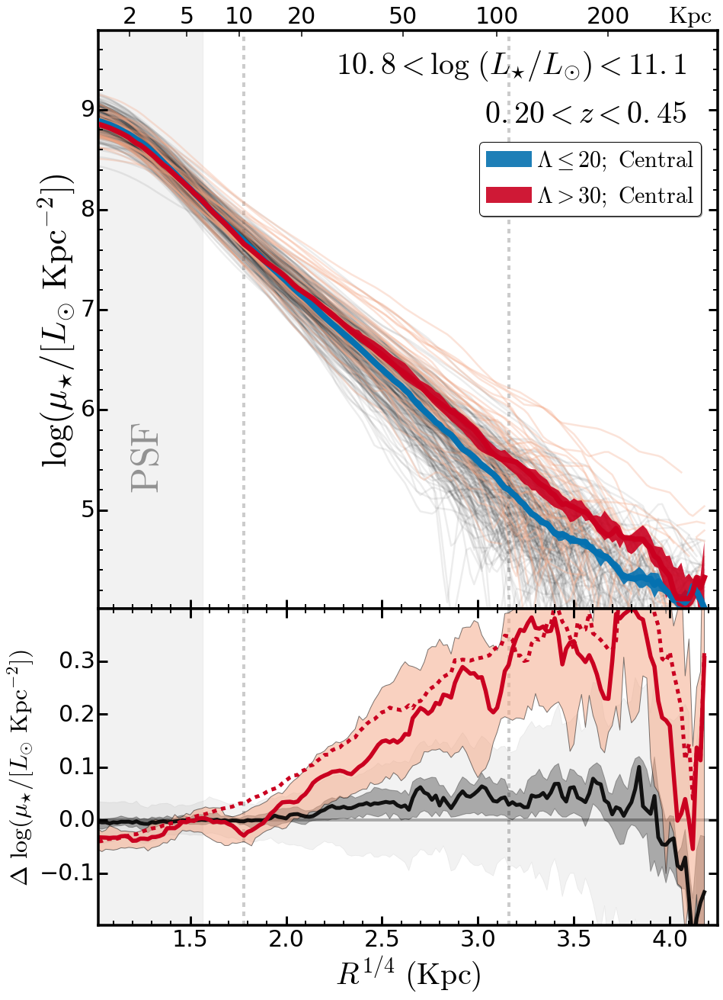

In [58]:
# --------------------------------------------------------------------------------------- #
## Setup up figure
fig2 = plt.figure(figsize=(13, 18))

ax1 = plt.axes(SBP2)
ax3 = plt.axes(SBP1)

########################################################################################
## Region affected by PSF
# z = 0.4 : 1"=5.4 Kpc
ax1.fill_between([0.0, 6.0**0.25], [2.0, 2.0], [11.0, 11.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
## Mark the two interesting radius
# 10 Kpc 
ax1.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
# 100 Kpc
ax1.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

########################################################################################
## Individual profiles
for gg in gu_sm:
    ax1.plot(RSMA_COMMON, gg, c='k', alpha=0.07, linewidth=2.5)
for bb in bm_sm:
    ax1.plot(RSMA_COMMON, bb, c=RED0, alpha=0.30, linewidth=2.5)

## Median profiles
ax1.fill_between(RSMA_COMMON, gu_mm[0], gu_mm[1], 
                 facecolor=BLUE1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda \leq 20;\ \mathrm{Central}$")
ax1.fill_between(RSMA_COMMON, bm_mm[0], bm_mm[1], 
                 facecolor=RED1, edgecolor='none', alpha=0.9, 
                 zorder=1005, label="$\Lambda > %d;\ \mathrm{Central}$" % lamLimit)

ax1.plot(RSMA_COMMON, gu_mm[2], linestyle='-', linewidth=8.0, 
         c=BLUE1, alpha=1.0, zorder=1010)
ax1.plot(RSMA_COMMON, bm_mm[2], linestyle='-', linewidth=7.0, 
         c=RED1, alpha=1.0, zorder=1010)

## X, Y Lables
ax1.set_ylabel('$\log ({\mu}_{\star}/[L_{\odot}\ \mathrm{Kpc}^{-2}])$', size=45)

## Ticks
ax1.minorticks_on()
for tick in ax1.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax1.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax1.tick_params('both', length=12, width=3, which='major')
ax1.tick_params('both', length=6, width=2, which='minor')

## Remove the X-axis label
ax1.xaxis.set_major_formatter(NullFormatter())

## Width of the axes
ax1.spines['top'].set_linewidth(3.5)
ax1.spines['right'].set_linewidth(3.5)
ax1.spines['bottom'].set_linewidth(3.5)
ax1.spines['left'].set_linewidth(3.5)

## Label the PSF region 
ax1.text(0.05, 0.20, '$\mathrm{PSF}$', rotation='vertical',
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=50.0, transform=ax1.transAxes, weight='bold', 
         color='k', alpha=0.4)

## Legend
ax1.legend(loc=(0.615, 0.680), shadow=True, fancybox=True, 
           numpoints=1, fontsize=30, scatterpoints=1, 
           markerscale=1.2, borderpad=0.3, handletextpad=0.2)

## Label the PSF region 
ax1.text(0.95, 0.83, '$%4.2f < z < %4.2f$' % (zlim0, zlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')
ax1.text(0.95, 0.91, '$%4.1f < \log\ (L_{\star}/L_{\odot}) < %4.1f$' % (mlim0, mlim1), 
         verticalalignment='bottom', horizontalalignment='right',
         fontsize=40.0, transform=ax1.transAxes, weight='bold', 
         color='k')

## X, Y limits
ax1.set_xlim(1.02, 4.25)
ax1.set_ylim(4.01, 9.79)

########################################################################################
## Secondary Axis 
ax2 = ax1.twiny()
kpcs = np.asarray([2.0, 5.0, 10.0, 20.0, 50.0, 100.0, 200.0])
kpcTicks= (kpcs ** 0.25)
ax2.set_xlim(1.02, 4.35)
ax2.set_ylim(4.01, 9.79)
ax2.set_xticks(kpcTicks)
ax2.set_xticklabels(['{:g}'.format(kpc) for kpc in kpcs], fontsize=30)
for tick in ax2.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax2.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax2.text(0.92, 1.0035, '$\mathrm{Kpc}$', 
         verticalalignment='bottom', horizontalalignment='left',
         fontsize=32.0, transform=ax2.transAxes)

########################################################################################

## Highlight zero 
ax3.axhline(0.0, linewidth=4.0, c='k', linestyle='-', zorder=0, alpha=0.3)

### 10 Kpc 
ax3.axvline(10.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)
### 100 Kpc
ax3.axvline(100.0 ** 0.25, linewidth=4.0, c='k', linestyle='--', zorder=0, alpha=0.2)

### z = 0.4 : 1"=5.4 Kpc
ax3.fill_between([0.0, 6.0**0.25], [-2.0, -2.0], [2.0, 2.0], 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)

## Random Mixed Sample
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 3, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 97, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.05, zorder=0)
ax3.fill_between(RSMA_COMMON, 
                 np.percentile(randM_sm - gu_mm[2], 31, axis=0), 
                 np.percentile(randM_sm - gu_mm[2], 69, axis=0), 
                 facecolor='k', edgecolor='k', alpha=0.30, zorder=0)

ax3.plot(RSMA_COMMON, np.percentile(randM_sm - gu_mm[2], 50, axis=0), 
         c='k', linewidth=5.0, linestyle='-', alpha=0.9)

## BCG-GAMA
ax3.fill_between(RSMA_COMMON, 
                 (bm_mm[0] - gu_mm[1]), (bm_mm[1] - gu_mm[0]),
                 facecolor=RED0, edgecolor='k', alpha=0.50, zorder=1)

ax3.plot(RSMA_COMMON, bm_mm[2] - gu_mm[2], c=RED1, linewidth=5.5, 
         linestyle='-')
ax3.plot(RSMA_COMMON, bm_amg[2] - gu_amg[2], c=RED1, linewidth=5.0, 
         linestyle='--')

#ax3.plot(RSMA_COMMON, bm_mm_b[2] - gu_mm_b[2], c=RED1, linewidth=4.5, 
#         linestyle='-.')
#ax3.plot(RSMA_COMMON, bm_amg_b[2] - gu_amg_b[2], c=RED1, linewidth=4.5, 
#         linestyle=':')

ax3.set_xlabel('$R^{1/4}\ (\mathrm{Kpc})$', size=40)
ax3.set_ylabel('$\Delta\ \log ({\mu}_{\star}/[L_{\odot}\ \mathrm{Kpc}^{-2}])$', size=32)

## X, Y Limits
ax3.set_xlim(1.02, 4.25)
ax3.set_ylim(-0.199, 0.399)

## Axes setup
### Minor Ticks on 
ax3.minorticks_on()
ax3.tick_params(axis='y', which='minor', left='off', right='off')

for tick in ax3.xaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
for tick in ax3.yaxis.get_major_ticks():
    tick.label.set_fontsize(30) 
ax3.tick_params('both', length=12, width=3, which='major')
ax3.tick_params('both', length=6, width=2, which='minor')

ax3.spines['top'].set_linewidth(3.5)
ax3.spines['right'].set_linewidth(3.5)
ax3.spines['bottom'].set_linewidth(3.5)
ax3.spines['left'].set_linewidth(3.5)

#ax3.plot(RSMA_COMMON[indEllip], (bm_mm[2][indEllip] - gu_mm[2][indEllip] - 
#                                 np.log10((1.0 - gm_me[2])/(1.0 - bm_me[2]))), 
#         linestyle='-.', linewidth=6.0, alpha=0.8, c=RED1)

########################################################################################
plt.show()

fig2.savefig('../figure/hscMassive_' + sampleName + 'b.png', dpi=300)